In [35]:
!pip3 install seaborn
!pip3 install plotly

import pandas as pd
import json
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from scipy.stats import entropy
import numpy as np
import pickle
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA
import statsmodels.api as sm
from statsmodels.regression.mixed_linear_model import MixedLM
import plotly.graph_objects as go
from mpl_toolkits.mplot3d import Axes3D  
import plotly.express as px
from plotly.subplots import make_subplots
from ipywidgets import widgets
from IPython.display import display, clear_output

Seek to perform general analysis of Ratings
Investigate relation between Ratings and Emotional Diversity
Do films with a larger emotional diversity (multiple emotions expressed during the movie) have better ratings?

In [36]:
DATAPATH_metadata = "../data_sentiment_analysis/final_dataset.pkl"
DATAPATH_emotions20 = "../data_sentiment_analysis/emotions_interpolated_20.pkl"

In [37]:
df_metadata = pd.read_pickle(DATAPATH_metadata)
df_emotion = pd.read_pickle(DATAPATH_emotions20)

In [80]:
def classify_ending(df, n_timesteps=1, threshold=0.9):
    """
    Classify movie endings based on joy and sadness levels in final n timesteps.
    
    Parameters:
    df: DataFrame with emotions and timesteps
    n_timesteps: Number of final timesteps to consider
    joy_threshold: Threshold for joy to classify as happy ending
    sadness_threshold: Threshold for sadness to classify as sad ending
    """
    # Get list of unique movies
    movies = df['Wikipedia_movie_ID'].unique()
    
    # Dictionary to store classifications
    endings = {}
    
    for movie_id in movies:
        # Get data for this movie
        movie_data = df[df['Wikipedia_movie_ID'] == movie_id]
        
        # Sort by timestep to ensure we get the last n timesteps
        movie_data = movie_data.sort_values('timestep')
        
        # Get the last n timesteps
        final_timesteps = movie_data.tail(n_timesteps)
        
        # Calculate average joy and sadness for final timesteps
        avg_joy = final_timesteps['joy'].mean()
        avg_sadness = final_timesteps['sadness'].mean()
        
        # Classify ending
        if avg_joy > threshold: # or avg_sadness < (1-threshold):
            endings[movie_id] = 'happy'
        elif avg_sadness > threshold: # or avg_joy < (1-threshold):
            endings[movie_id] = 'sad'
        else:
            endings[movie_id] = 'neutral'
            
        # Store the emotion values for reference
        endings[f"{movie_id}_values"] = {
            'avg_joy': avg_joy,
            'avg_sadness': avg_sadness
        }
    
    return endings

In [81]:
# Use the function
endings = classify_ending(df_emotion)

# Create a summary by directly counting the values
summary = {
    'happy': sum(1 for v in endings.values() if v == 'happy'),
    'sad': sum(1 for v in endings.values() if v == 'sad'),
    'neutral': sum(1 for v in endings.values() if v == 'neutral')
}

print("\nClassification Summary:")
print(summary)

# Print some example classifications
print("\nExample Classifications:")
# Take first 5 movie IDs that aren't value entries
movie_ids = [k for k in endings.keys() if isinstance(k, (int, np.integer))][:5]

for movie_id in movie_ids:
    print(f"\nMovie ID: {movie_id}")
    print(f"Classification: {endings[movie_id]}")
    print(f"Joy average: {endings[f'{movie_id}_values']['avg_joy']:.3f}")
    print(f"Sadness average: {endings[f'{movie_id}_values']['avg_sadness']:.3f}")


Classification Summary:
{'happy': 1137, 'sad': 729, 'neutral': 32476}

Example Classifications:

Movie ID: 3333
Classification: neutral
Joy average: 0.319
Sadness average: 0.194

Movie ID: 3746
Classification: neutral
Joy average: 0.267
Sadness average: 0.021

Movie ID: 3837
Classification: neutral
Joy average: 0.208
Sadness average: 0.032

Movie ID: 3947
Classification: neutral
Joy average: 0.811
Sadness average: 0.012

Movie ID: 4227
Classification: neutral
Joy average: 0.170
Sadness average: 0.208


In [82]:
# First filter out the _values entries from the dictionary
filtered_endings = {k: v for k, v in endings.items() if isinstance(k, (int, np.integer))}

# Convert filtered dictionary to DataFrame
endings_df = pd.DataFrame.from_dict(filtered_endings, orient='index', columns=['ending'])

# Reset index to make Wikipedia_movie_ID a column
endings_df = endings_df.reset_index()

# Rename the 'index' column to 'Wikipedia_movie_ID'
endings_df = endings_df.rename(columns={'index': 'Wikipedia_movie_ID'})

# Convert Wikipedia_movie_ID to integer (might not be necessary now)
endings_df['Wikipedia_movie_ID'] = endings_df['Wikipedia_movie_ID'].astype(int)

# Now merge with your other dataframe
df_merged = df_metadata.merge(
    endings_df,
    on='Wikipedia_movie_ID',
    how='left'
)

In [83]:
# Check the first few rows of the merged dataframe
# print(df_merged.head(2))

# Verify the merge
print("\nNumber of rows in original dataframe:", len(df_metadata))
print("Number of rows in merged dataframe:", len(df_merged))
print("\nDistribution of endings:")
print(df_merged['ending'].value_counts())


Number of rows in original dataframe: 34342
Number of rows in merged dataframe: 34342

Distribution of endings:
ending
neutral    32476
happy       1137
sad          729
Name: count, dtype: int64


In [84]:
df_merged.head(5)

,Wikipedia_movie_ID,summary,Freebase_movie_ID,Movie_name,Movie_release_date,Movie_box_office_revenue,Movie_runtime,Movie_languages,Movie_countries,Movie_genres,category,continent,Rating,ending
0,3333,The film follows two juxtaposed families: the...,/m/0151l,The Birth of a Nation,NaN,50000000.0,190.0,"Silent film, English Language",United States of America,"Silent film, Indie, Costume drama, Epic, Black...","[Action/Adventure, Drama]",North America,6.1,neutral
1,3746,"In Los Angeles, November 2019, retired police...",/m/017n9,Blade Runner,1982.0,33139618.0,116.0,"Japanese Language, Cantonese, English Language...","United States of America, Hong Kong","Thriller, Cyberpunk, Science Fiction, Future n...","[Drama, Fantasy/Sci-Fi, Thriller]",North America,8.1,neutral
2,3837,"In the American Old West of 1874, construction...",/m/018f8,Blazing Saddles,1974.0,119500000.0,93.0,"Yiddish Language, English Language",United States of America,"Western, Satire, Comedy","[Action/Adventure, Comedy]",North America,7.7,neutral
3,3947,Jeffrey Beaumont returns to his logging home ...,/m/0191n,Blue Velvet,NaN,8551228.0,120.0,English Language,United States of America,"Thriller, Mystery, Crime Fiction",[Thriller],North America,7.7,neutral
4,4227,:By What Means Redmond Barry Acquired the Sty...,/m/01c9d,Barry Lyndon,1975.0,20000000.0,187.0,"French Language, English Language, German Lang...","United States of America, United Kingdom","Costume drama, Film adaptation, Period piece, ...","[Drama, Romance]",North America,8.1,neutral



Average Ratings by Ending Type:
             mean       std  count
ending                            
happy    6.266055  1.077680    872
neutral  6.257084  1.140519  30217
sad      6.435634  1.059646    797


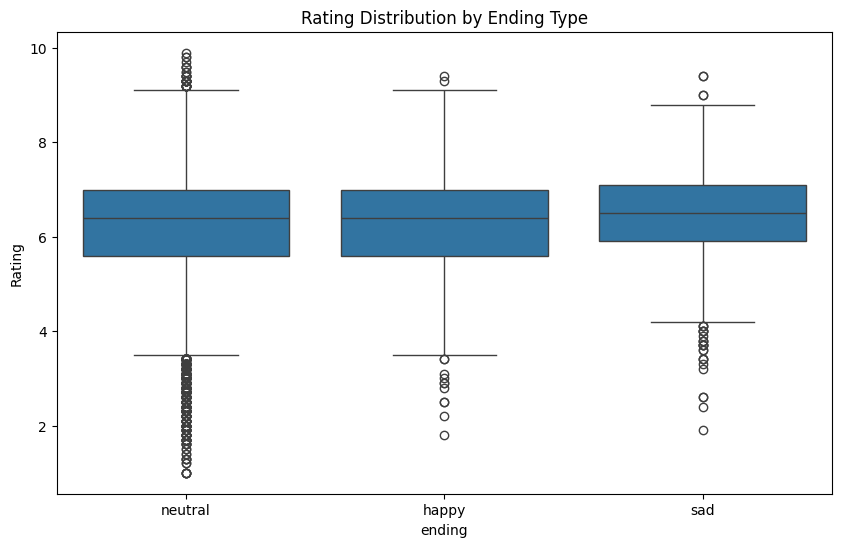


One-way ANOVA test results:
F-statistic: nan
p-value: nan

Proportion of each ending type:
ending
neutral    94.7
happy       2.8
sad         2.5
Name: proportion, dtype: float64 %


In [79]:
# First, explode the categories
df_endings = df_merged[['Wikipedia_movie_ID', 'category', 'ending', 'Rating']].explode('category')

# 2. Average Ratings Analysis
print("\nAverage Ratings by Ending Type:")
rating_stats = df_merged.groupby('ending')['Rating'].agg(['mean', 'std', 'count'])
print(rating_stats)

# Create a box plot of ratings by ending type
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_merged, x='ending', y='Rating')
plt.title('Rating Distribution by Ending Type')
plt.show()

# 3. One-way ANOVA test for ratings between ending types
# First, collect the ratings for each group
happy_ratings = df_merged[df_merged['ending'] == 'happy']['Rating']
sad_ratings = df_merged[df_merged['ending'] == 'sad']['Rating']
neutral_ratings = df_merged[df_merged['ending'] == 'neutral']['Rating']

# Perform ANOVA
f_stat, p_value = stats.f_oneway(happy_ratings, sad_ratings, neutral_ratings)

print("\nOne-way ANOVA test results:")
print(f"F-statistic: {f_stat:.4f}")
print(f"p-value: {p_value:.4f}")


# Additional: Proportion of endings
print("\nProportion of each ending type:")
print(df_merged['ending'].value_counts(normalize=True).round(3) * 100, "%")

Average Ratings by Ending Type:
             mean       std  count
ending                            
happy    6.326281  1.098718   1054
neutral  6.254437  1.139133  30141
sad      6.484226  1.085356    691 

for threshold = 0.9, n = 1

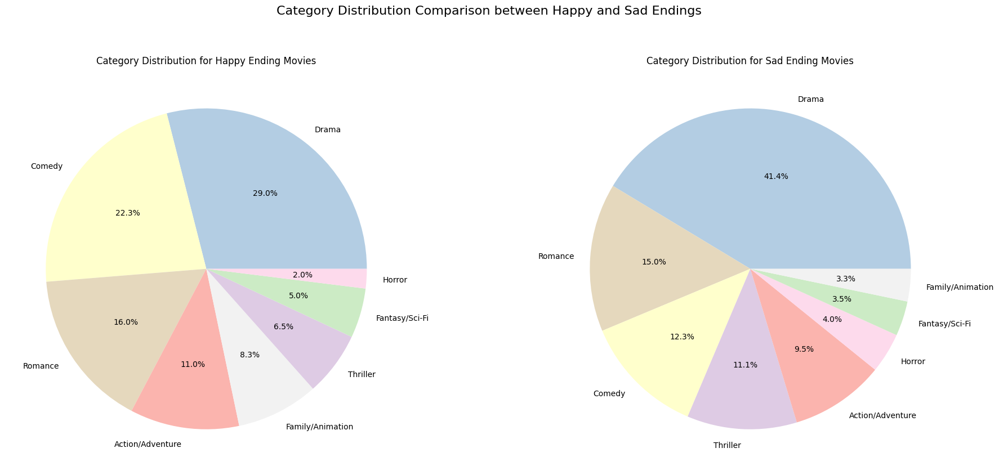


Category counts for happy endings:
category
Drama               619
Comedy              477
Romance             342
Action/Adventure    235
Family/Animation    177
Thriller            138
Fantasy/Sci-Fi      107
Horror               42
Name: count, dtype: int64

Category counts for sad endings:
category
Drama               531
Romance             192
Comedy              158
Thriller            142
Action/Adventure    122
Horror               52
Fantasy/Sci-Fi       45
Family/Animation     42
Name: count, dtype: int64


In [88]:
# First, explode the categories
df_exploded = df_merged[['Wikipedia_movie_ID', 'category', 'ending', 'Rating']].explode('category')

# Get all unique categories to create consistent color mapping
unique_categories = df_exploded['category'].unique()
colors = plt.cm.Pastel1(np.linspace(0, 1, len(unique_categories)))
color_dict = dict(zip(unique_categories, colors))

# Create figure with two subplots side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

# Plot for happy endings
happy_cats = df_exploded[df_exploded['ending'] == 'happy']['category'].value_counts()
colors_happy = [color_dict[cat] for cat in happy_cats.index]
ax1.pie(happy_cats.values, labels=happy_cats.index, autopct='%1.1f%%', colors=colors_happy)
ax1.set_title('Category Distribution for Happy Ending Movies')

# Plot for sad endings
sad_cats = df_exploded[df_exploded['ending'] == 'sad']['category'].value_counts()
colors_sad = [color_dict[cat] for cat in sad_cats.index]
ax2.pie(sad_cats.values, labels=sad_cats.index, autopct='%1.1f%%', colors=colors_sad)
ax2.set_title('Category Distribution for Sad Ending Movies')

plt.suptitle('Category Distribution Comparison between Happy and Sad Endings', y=1.05, fontsize=16)
plt.tight_layout()
plt.show()

# Print the distributions
print("\nCategory counts for happy endings:")
print(happy_cats)
print("\nCategory counts for sad endings:")
print(sad_cats)

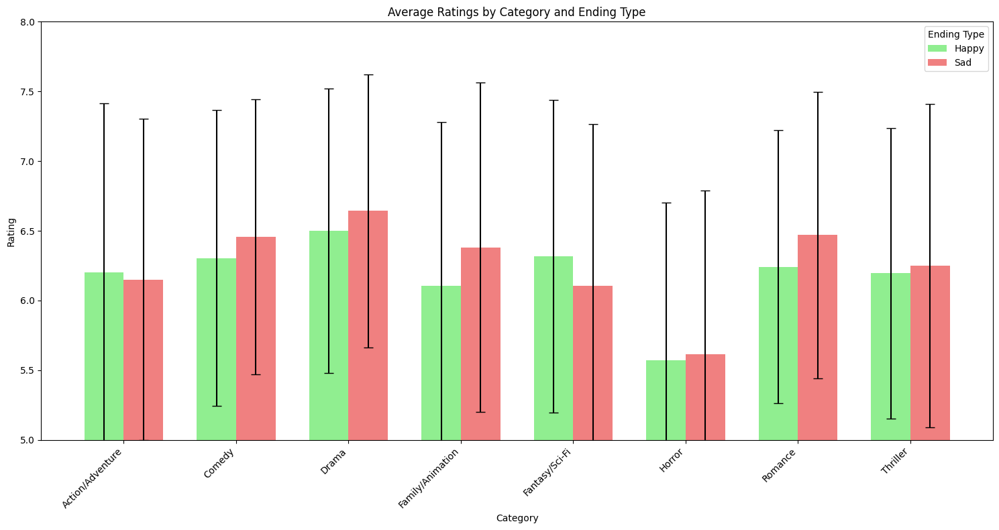

In [92]:
# Alternative approach using grouped bar plot
plt.figure(figsize=(15, 8))

# Calculate means and standard deviations
summary = df_exploded[df_exploded['ending'].isin(['happy', 'sad'])].groupby(
    ['category', 'ending']
)['Rating'].agg(['mean', 'std']).reset_index()

# Create positions for bars
categories = sorted(df_exploded['category'].unique())
x = np.arange(len(categories))
width = 0.35

# Plot bars
happy_data = summary[summary['ending'] == 'happy']
sad_data = summary[summary['ending'] == 'sad']

plt.bar(x - width/2, happy_data['mean'], width, label='Happy', color='lightgreen',
        yerr=happy_data['std'], capsize=5)
plt.bar(x + width/2, sad_data['mean'], width, label='Sad', color='lightcoral',
        yerr=sad_data['std'], capsize=5)

# Customize plot
plt.xlabel('Category')
plt.ylabel('Rating')
plt.title('Average Ratings by Category and Ending Type')
plt.xticks(x, categories, rotation=45, ha='right')
plt.legend(title='Ending Type')
plt.ylim(5,8)
plt.tight_layout()
plt.show()

In [4]:
print(df_metadata["Rating"].isna().sum()/len(df_metadata)*100)

7.151592801817016


In [5]:
df_metadata["Rating"].describe()

count    31886.000000
mean         6.261792
std          1.137202
min          1.000000
25%          5.600000
50%          6.400000
75%          7.000000
max          9.900000
Name: Rating, dtype: float64

In [29]:
country_mapping = {
    'Asia': [
        'Afghanistan', 'Armenia', 'Azerbaijan', 'Bahrain', 'Bangladesh', 'Bhutan', 'Brunei', 'Cambodia', 'China', 'Cyprus', 'Georgia', 
        'India', 'Indonesia', 'Iran', 'Iraq', 'Israel', 'Japan', 'Jordan', 'Kazakhstan', 'Kuwait', 'Kyrgyzstan', 'Lebanon', 'Malaysia', 
        'Maldives', 'Mongolia', 'Myanmar (Burma)', 'Nepal', 'North Korea', 'Oman', 'Pakistan', 'Palestinian Territories', 'Philippines', 
        'Qatar', 'Republic of China (Taiwan)', 'Saudi Arabia', 'Singapore', 'South Korea', 'Sri Lanka', 'Syria', 'Tajikistan', 'Thailand', 
        'Timor-Leste', 'Turkey', 'Turkmenistan', 'United Arab Emirates', 'Uzbekistan', 'Vietnam', 'Yemen',
        "Burma", "Georgian SSR", "Hong Kong", "Iraqi Kurdistan", "Korea", "Macau", "Mandatory Palestine",
        "Palestinian territories", "Republic of China", "Taiwan", "Uzbek SSR", "Soviet Union", "Malayalam Language"
    ],
    'Africa': [
        'Algeria', 'Angola', 'Benin', 'Botswana', 'Burkina Faso', 'Burundi', 'Cabo Verde', 'Cameroon', 'Central African Republic', 'Chad', 
        'Comoros', 'Congo', 'Democratic Republic of the Congo', 'Djibouti', 'Egypt', 'Equatorial Guinea', 'Eritrea', 'Eswatini', 'Ethiopia', 
        'Gabon', 'Gambia', 'Ghana', 'Guinea', 'Guinea-Bissau', 'Ivory Coast (Côte d\'Ivoire)', 'Kenya', 'Lesotho', 'Liberia', 'Libya', 
        'Madagascar', 'Malawi', 'Mali', 'Mauritania', 'Mauritius', 'Morocco', 'Mozambique', 'Namibia', 'Niger', 'Nigeria', 'Rwanda', 'São Tomé and Príncipe', 
        'Senegal', 'Seychelles', 'Sierra Leone', 'Somalia', 'South Africa', 'South Sudan', 'Sudan', 'Togo', 'Tunisia', 'Uganda', 'Zambia', 'Zimbabwe'
    ],
    'Europe': [
        'Albania', 'Andorra', 'Austria', 'Belarus', 'Belgium', 'Bosnia and Herzegovina', 'Bulgaria', 'Croatia', 'Cyprus', 'Czech Republic', 
        'Denmark', 'Estonia', 'Finland', 'France', 'Georgia', 'Germany', 'Greece', 'Hungary', 'Iceland', 'Ireland', 'Italy', 'Kazakhstan', 
        'Kosovo', 'Latvia', 'Liechtenstein', 'Lithuania', 'Luxembourg', 'Malta', 'Moldova', 'Monaco', 'Montenegro', 'Netherlands', 'North Macedonia', 
        'Norway', 'Poland', 'Portugal', 'Romania', 'Russia', 'San Marino', 'Serbia', 'Slovakia', 'Slovenia', 'Spain', 'Sweden', 'Switzerland', 
        'Ukraine', 'United Kingdom', "Crime", "Czechoslovakia", "England", "Federal Republic of Yugoslavia", "German Democratic Republic",
        "Isle of Man", "Kingdom of Great Britain", "Kingdom of Italy", "Northern Ireland",
        "Republic of Macedonia", "Scotland", "Serbia and Montenegro", "Slovak Republic",
        "Socialist Federal Republic of Yugoslavia", "Soviet occupation zone", "Ukrainian SSR", "Ukranian SSR",
        "Wales", "Weimar Republic", "West Germany", "Yugoslavia", "German Language", "Nazi Germany"
    ],
    'North America': [
        'Canada', 'Costa Rica', 'Cuba', 'Dominican Republic', 'El Salvador', 'Guatemala', 'Haiti', 'Honduras', 'Jamaica', 'Mexico', 
        'Nicaragua', 'Panama', 'United States of America', "Aruba", "Bahamas", "Puerto Rico"
    ],
    'South America': [
        'Argentina', 'Bolivia', 'Brazil', 'Chile', 'Colombia', 'Ecuador', 'Guyana', 'Paraguay', 'Peru', 'Suriname', 'Uruguay', 'Venezuela'
    ],
    'Oceania': [
        'Australia', 'Fiji', 'Kiribati', 'Marshall Islands', 'Micronesia', 'Nauru', 'New Zealand', 'Palau', 'Papua New Guinea', 'Samoa', 
        'Solomon Islands', 'Tonga', 'Tuvalu', 'Vanuatu'
    ]
}

In [30]:
NA_films = df_metadata[df_metadata['Movie_countries'].isin(country_mapping['North America'])]
emotions_NA = df_emotion[df_emotion['Wikipedia_movie_ID'].isin(NA_films['Wikipedia_movie_ID'])]
Asia_films = df_metadata[df_metadata['Movie_countries'].isin(country_mapping['Asia'])]
emotions_Asia = df_emotion[df_emotion['Wikipedia_movie_ID'].isin(Asia_films['Wikipedia_movie_ID'])]
Africa_films = df_metadata[df_metadata['Movie_countries'].isin(country_mapping['Africa'])]
emotions_Africa = df_emotion[df_emotion['Wikipedia_movie_ID'].isin(Africa_films['Wikipedia_movie_ID'])]
Europe_films = df_metadata[df_metadata['Movie_countries'].isin(country_mapping['Europe'])]
emotions_Europe = df_emotion[df_emotion['Wikipedia_movie_ID'].isin(Europe_films['Wikipedia_movie_ID'])]
SA_films = df_metadata[df_metadata['Movie_countries'].isin(country_mapping['South America'])]
emotions_SA = df_emotion[df_emotion['Wikipedia_movie_ID'].isin(SA_films['Wikipedia_movie_ID'])]
Oceania_films = df_metadata[df_metadata['Movie_countries'].isin(country_mapping['Oceania'])]
emotions_Oceania = df_emotion[df_emotion['Wikipedia_movie_ID'].isin(Oceania_films['Wikipedia_movie_ID'])]

In [8]:
def calculate_emotional_diversity_metrics(df):
    """Calculate different metrics of emotional diversity for each movie"""
    
    # List of emotion columns (excluding timestep and movie_id)
    emotion_cols = ['anger', 'disgust', 'fear', 'joy', 'neutral', 'sadness', 'surprise']
    
    diversity_metrics = {}
    
    # 1. Shannon Entropy across all timesteps
    """
        Purpose: Measures emotional diversity/uncertainty in the distribution
        Method:
        Calculates mean value for each emotion across timesteps
        Normalizes to create probability distribution
        Higher values indicate more balanced emotional distribution
        Lower values indicate dominance of few emotions
    """
    def calculate_shannon_entropy(movie_data):
        # Calculate mean emotion values across timesteps
        mean_emotions = movie_data[emotion_cols].mean()
        # Normalize to create probability distribution
        prob_dist = mean_emotions / mean_emotions.sum()
        return entropy(prob_dist)
    
    diversity_metrics['shannon_entropy'] = df.groupby('Wikipedia_movie_ID').apply(calculate_shannon_entropy)
    
    # 2. Emotion Transitions (how often the dominant emotion changes)
    def count_emotion_transitions(movie_data):
        dominant_emotions = movie_data[emotion_cols].idxmax(axis=1)
        transitions = (dominant_emotions != dominant_emotions.shift()).sum()
        return transitions
    
    diversity_metrics['emotion_transitions'] = df.groupby('Wikipedia_movie_ID').apply(count_emotion_transitions)
    
    # 3. Standard deviation of emotions over time
    """
        Purpose: Measures how much emotions fluctuate over time
        Method:

        Calculates standard deviation for each emotion
        Takes mean of all standard deviations
        Higher values indicate more emotional volatility
        Lower values indicate more emotional stability
    """
    def calculate_emotion_variation(movie_data):
        return movie_data[emotion_cols].std().mean()
    
    diversity_metrics['emotion_variation'] = df.groupby('Wikipedia_movie_ID').apply(calculate_emotion_variation)
    
    # 4. Count of unique dominant emotions
    def count_unique_dominant_emotions(movie_data):
        dominant_emotions = movie_data[emotion_cols].idxmax(axis=1)
        return dominant_emotions.nunique()
    
    diversity_metrics['unique_dominant_emotions'] = df.groupby('Wikipedia_movie_ID').apply(count_unique_dominant_emotions)
    
    # Combine all metrics into a DataFrame
    diversity_df = pd.DataFrame(diversity_metrics)
    return diversity_df

def analyze_emotion_diversity_vs_ratings(df_general, diversity_metrics):
    """Perform statistical analysis of emotional diversity vs ratings"""
    # 1. First, select only needed columns and remove duplicates, excluding NaN ratings
    ratings_clean = df_general[['Wikipedia_movie_ID', 'Rating']].dropna(subset=['Rating']).drop_duplicates()
    # This ensures each movie ID has only one rating and no NaN values

    # 2. Then merge with diversity metrics
    analysis_df = diversity_metrics.merge(ratings_clean, left_index=True, right_on='Wikipedia_movie_ID')
        
    
    # 1. Correlation Analysis
    correlations = {}
    for metric in ['shannon_entropy', 'emotion_transitions', 'emotion_variation', 'unique_dominant_emotions']:
        correlation, p_value = stats.pearsonr(analysis_df[metric], analysis_df['Rating'])
        correlations[metric] = {'correlation': correlation, 'p_value': p_value}
        """
        Purpose: Measures linear relationship between diversity metrics and ratings
        Components:
        Correlation coefficient (-1 to +1)
        +1: Perfect positive correlation
        -1: Perfect negative correlation
        0: No linear correlation
        P-value: Statistical significance
        < 0.05: Generally considered significant
        Tests null hypothesis of no correlation
        """
    
    # 2. Linear Regression Analysis
    regression_results = {}
    for metric in ['shannon_entropy', 'emotion_transitions', 'emotion_variation', 'unique_dominant_emotions']:
        X = sm.add_constant(analysis_df[metric])
        model = sm.OLS(analysis_df['Rating'], X).fit()
        regression_results[metric] = model
    
    return correlations, regression_results, analysis_df

def visualize_diversity_analysis(analysis_df, title=None):
   fig, axes = plt.subplots(2, 2, figsize=(15, 15))
   fig.suptitle('Emotional Diversity vs Movie Ratings - ' + title, fontsize=16)
   
   sns.scatterplot(data=analysis_df, x='shannon_entropy', y='Rating', ax=axes[0,0])
   axes[0,0].set_title('Shannon Entropy vs Ratings')
   sns.regplot(data=analysis_df, x='shannon_entropy', y='Rating', ax=axes[0,0], scatter=False, color='red')
   
   sns.scatterplot(data=analysis_df, x='emotion_transitions', y='Rating', ax=axes[0,1])
   axes[0,1].set_title('Emotion Transitions vs Ratings')
   sns.regplot(data=analysis_df, x='emotion_transitions', y='Rating', ax=axes[0,1], scatter=False, color='red')
   
   sns.scatterplot(data=analysis_df, x='emotion_variation', y='Rating', ax=axes[1,0])
   axes[1,0].set_title('Emotion Variation vs Ratings')
   sns.regplot(data=analysis_df, x='emotion_variation', y='Rating', ax=axes[1,0], scatter=False, color='red')
   
   sns.scatterplot(data=analysis_df, x='unique_dominant_emotions', y='Rating', ax=axes[1,1])
   axes[1,1].set_title('Unique Dominant Emotions vs Ratings')
   sns.regplot(data=analysis_df, x='unique_dominant_emotions', y='Rating', ax=axes[1,1], scatter=False, color='red')
   
   plt.tight_layout()
   return fig

def create_supplementary_visualizations(df, analysis_df, title=None):
    # 1. Distribution of diversity metrics
    fig, axes = plt.subplots(2, 2, figsize=(15, 10))
    fig.suptitle('Distribution of Emotional Diversity Metrics', fontsize=16)
    
    sns.histplot(data=analysis_df, x='shannon_entropy', ax=axes[0,0])
    axes[0,0].set_title('Distribution of Shannon Entropy')
    
    sns.histplot(data=analysis_df, x='emotion_transitions', ax=axes[0,1])
    axes[0,1].set_title('Distribution of Emotion Transitions')
    
    sns.histplot(data=analysis_df, x='emotion_variation', ax=axes[1,0])
    axes[1,0].set_title('Distribution of Emotion Variation')
    
    sns.histplot(data=analysis_df, x='unique_dominant_emotions', ax=axes[1,1])
    axes[1,1].set_title('Distribution of Unique Dominant Emotions')
    
    plt.tight_layout()
    return fig

C:\Users\inesa\AppData\Local\Temp\ipykernel_16528\4188100039.py:25: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  diversity_metrics['shannon_entropy'] = df.groupby('Wikipedia_movie_ID').apply(calculate_shannon_entropy)
C:\Users\inesa\AppData\Local\Temp\ipykernel_16528\4188100039.py:33: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  diversity_metrics['emotion_transitions'] = df.groupby('Wikipedia_movie_ID').a


Correlation analysis for shannon_entropy:
Correlation coefficient: 0.084
P-value: 0.000

Correlation analysis for emotion_transitions:
Correlation coefficient: 0.114
P-value: 0.000

Correlation analysis for emotion_variation:
Correlation coefficient: 0.103
P-value: 0.000

Correlation analysis for unique_dominant_emotions:
Correlation coefficient: 0.094
P-value: 0.000

Regression analysis for shannon_entropy:
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const               5.3019      0.064     82.748      0.000       5.176       5.428
shannon_entropy     0.5982      0.040     15.055      0.000       0.520       0.676

Regression analysis for emotion_transitions:
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   5.963

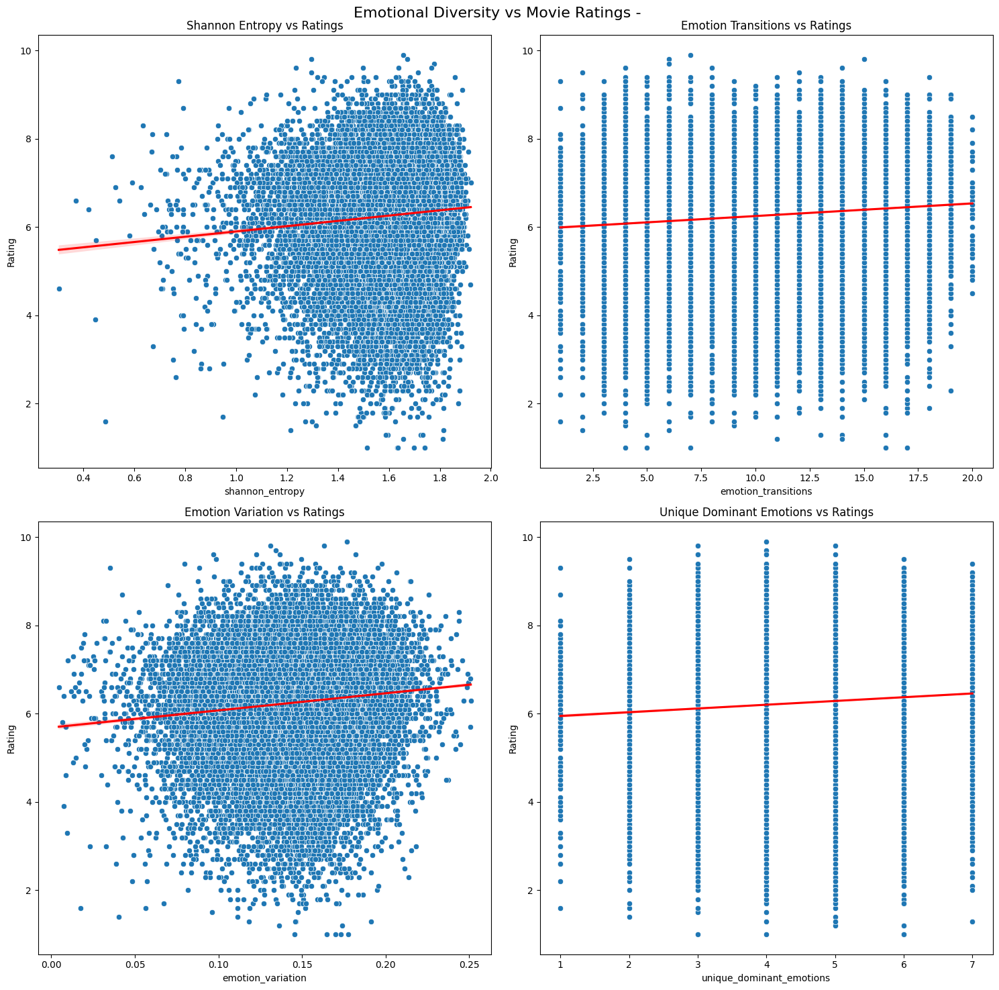

In [9]:
diversity_metrics = calculate_emotional_diversity_metrics(df_emotion)
correlations, regression_results, analysis_df = analyze_emotion_diversity_vs_ratings(df_metadata, diversity_metrics)
# Create visualizations
main_viz = visualize_diversity_analysis(analysis_df,'')
#supp_viz = create_supplementary_visualizations(dataset.head(10), analysis_df)
# Print correlation results
for metric, results in correlations.items():
    print(f"\nCorrelation analysis for {metric}:")
    print(f"Correlation coefficient: {results['correlation']:.3f}")
    print(f"P-value: {results['p_value']:.3f}")

# Print regression results
for metric, model in regression_results.items():
    print(f"\nRegression analysis for {metric}:")
    print(model.summary().tables[1])


In [65]:
import plotly.graph_objects as go

# Prepare the data
metrics = ['Shannon Entropy', 'Emotion Transitions', 'Emotion Variation', 'Unique Dominant Emotions']
values = [0.084, 0.114, 0.103, 0.094]  # correlation coefficients
p_values = [0.000, 0.000, 0.000, 0.000]  # p-values

# Metric descriptions for tooltips
descriptions = {
    'Shannon Entropy': 'Measures emotional diversity/uncertainty in the distribution.',
    'Emotion Transitions': 'Counts how often the dominant emotion changes.',
    'Emotion Variation': 'Measures how much emotions fluctuate over time.',
    'Unique Dominant Emotions': 'Counts the number of different dominant emotions.'
}

# Create figure
fig = go.Figure()

# Add bars with hover information
fig.add_trace(
    go.Bar(
        y=metrics,
        x=values,
        orientation='h',
        error_x=dict(
            type='data',
            array=[0.02] * len(metrics),
            color='rgb(68, 68, 68)',
            thickness=1.5,
            width=8
        ),
        marker=dict(
            color='rgb(214, 39, 40)',
            line=dict(color='rgb(68, 68, 68)', width=1)
        ),
        hovertemplate='<b>%{y}</b><br>' +
                     'Correlation: %{x:.3f}<br>' +
                     '<b>Description:</b> %{customdata}<extra></extra>',
        customdata=[descriptions[m] for m in metrics]
    )
)

# Update layout
fig.update_layout(
    title=dict(
        text='Pearson Correlation for Emotion Diversity Metrics',
        font=dict(size=24, color='rgb(68, 68, 68)'),
        x=0.5,
        y=0.95
    ),
    xaxis=dict(
        title='Correlation Coefficient',
        title_font=dict(size=14),
        tickfont=dict(size=12),
        range=[0, 0.15],
        zeroline=True,
        zerolinecolor='black',
        zerolinewidth=1,
        gridcolor='lightgrey',
        showgrid=True,
        dtick=0.05  # Set tick interval to 0.05
    ),
    yaxis=dict(
        title='Metrics',
        title_font=dict(size=14),
        tickfont=dict(size=12),
        autorange='reversed',
        showgrid=False,
        position=0  # This would create additional space between labels and bars
    ),
    height=400,
    width=900,
    plot_bgcolor='white',
    paper_bgcolor='white',
    margin=dict(l=200, r=100, t=80, b=80),
    showlegend=False,
    hoverlabel=dict(
        bgcolor="white",
        font_size=12,
        font_family="Arial"
    )
)

fig.show()

In [67]:
fig.write_html("C:/Users/inesa/OneDrive/Documentos/EPFL/Master RO/MA1/ADA/ProjectADA/Datastory/dataffoneurs-story/PlotsRatings/correlation_general_diversity.html")

- All metrics show statistically significant relationships with ratings (p-values < 0.001)
- All correlations are positive but relatively weak:
  - emotion_transitions: 0.114 (strongest)
  - emotion_variation: 0.103
  - unique_dominant_emotions: 0.094
  - shannon_entropy: 0.084 (weakest)
- These values indicate that while there is a positive relationship between emotional diversity and ratings, it's quite modest
- The correlation coefficients suggest that only about 1-1.3% of the variance in ratings can be explained by any single emotional diversity metric
- Movies with more emotional diversity tend to receive slightly higher ratings
- The effects are consistent but small
- All four metrics show similar patterns, suggesting robustness in the relationship
- The relationships are linear and predictable, but not strong enough to be used as sole predictors of movie ratings
- The weak correlations suggest that emotional diversity is just one of many factors affecting movie ratings
- There might be non-linear relationships that aren't captured by this analysis
- Other factors (genre, production quality, acting, etc.) likely have stronger influences on ratings

In [31]:
continent_data = [
    (emotions_Oceania, Oceania_films, "Oceania"),
    (emotions_Africa, Africa_films, "Africa"), 
    (emotions_Europe, Europe_films, "Europe"),
    (emotions_NA, NA_films, "North America"),
    (emotions_SA, SA_films, "South America"),
    (emotions_Asia, Asia_films, "Asia")
]

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:25: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:33: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:48: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in 


Results for Oceania:

Correlation analysis for shannon_entropy:
Correlation coefficient: 0.045
P-value: 0.498

Correlation analysis for emotion_transitions:
Correlation coefficient: 0.100
P-value: 0.129

Correlation analysis for emotion_variation:
Correlation coefficient: 0.035
P-value: 0.597

Correlation analysis for unique_dominant_emotions:
Correlation coefficient: 0.087
P-value: 0.188

Regression analysis for shannon_entropy:
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const               5.7716      0.616      9.371      0.000       4.558       6.985
shannon_entropy     0.2664      0.392      0.679      0.498      -0.506       1.039

Regression analysis for emotion_transitions:
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const  

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:25: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:33: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:48: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in 


Results for Africa:

Correlation analysis for shannon_entropy:
Correlation coefficient: -0.006
P-value: 0.953

Correlation analysis for emotion_transitions:
Correlation coefficient: 0.054
P-value: 0.611

Correlation analysis for emotion_variation:
Correlation coefficient: -0.030
P-value: 0.774

Correlation analysis for unique_dominant_emotions:
Correlation coefficient: -0.028
P-value: 0.790

Regression analysis for shannon_entropy:
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const               6.3843      1.110      5.750      0.000       4.179       8.590
shannon_entropy    -0.0423      0.709     -0.060      0.953      -1.450       1.366

Regression analysis for emotion_transitions:
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:25: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:33: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:48: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in 


Results for Europe:

Correlation analysis for shannon_entropy:
Correlation coefficient: 0.093
P-value: 0.000

Correlation analysis for emotion_transitions:
Correlation coefficient: 0.124
P-value: 0.000

Correlation analysis for emotion_variation:
Correlation coefficient: 0.112
P-value: 0.000

Correlation analysis for unique_dominant_emotions:
Correlation coefficient: 0.108
P-value: 0.000

Regression analysis for shannon_entropy:
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const               5.4325      0.151     35.907      0.000       5.136       5.729
shannon_entropy     0.5853      0.094      6.213      0.000       0.401       0.770

Regression analysis for emotion_transitions:
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const   

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:25: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:33: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:48: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in 


Results for North America:

Correlation analysis for shannon_entropy:
Correlation coefficient: 0.094
P-value: 0.000

Correlation analysis for emotion_transitions:
Correlation coefficient: 0.123
P-value: 0.000

Correlation analysis for emotion_variation:
Correlation coefficient: 0.110
P-value: 0.000

Correlation analysis for unique_dominant_emotions:
Correlation coefficient: 0.110
P-value: 0.000

Regression analysis for shannon_entropy:
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const               5.0625      0.090     56.192      0.000       4.886       5.239
shannon_entropy     0.6500      0.056     11.603      0.000       0.540       0.760

Regression analysis for emotion_transitions:
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
c

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:25: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:33: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:48: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in 


Results for South America:

Correlation analysis for shannon_entropy:
Correlation coefficient: 0.169
P-value: 0.015

Correlation analysis for emotion_transitions:
Correlation coefficient: 0.194
P-value: 0.005

Correlation analysis for emotion_variation:
Correlation coefficient: 0.093
P-value: 0.186

Correlation analysis for unique_dominant_emotions:
Correlation coefficient: 0.192
P-value: 0.006

Regression analysis for shannon_entropy:
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const               5.0409      0.552      9.136      0.000       3.953       6.129
shannon_entropy     0.8836      0.362      2.442      0.015       0.170       1.597

Regression analysis for emotion_transitions:
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
c

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:25: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:33: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:48: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in 


Results for Asia:

Correlation analysis for shannon_entropy:
Correlation coefficient: 0.019
P-value: 0.122

Correlation analysis for emotion_transitions:
Correlation coefficient: 0.104
P-value: 0.000

Correlation analysis for emotion_variation:
Correlation coefficient: 0.052
P-value: 0.000

Correlation analysis for unique_dominant_emotions:
Correlation coefficient: 0.049
P-value: 0.000

Regression analysis for shannon_entropy:
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const               6.1928      0.158     39.136      0.000       5.883       6.503
shannon_entropy     0.1506      0.097      1.547      0.122      -0.040       0.341

Regression analysis for emotion_transitions:
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const     

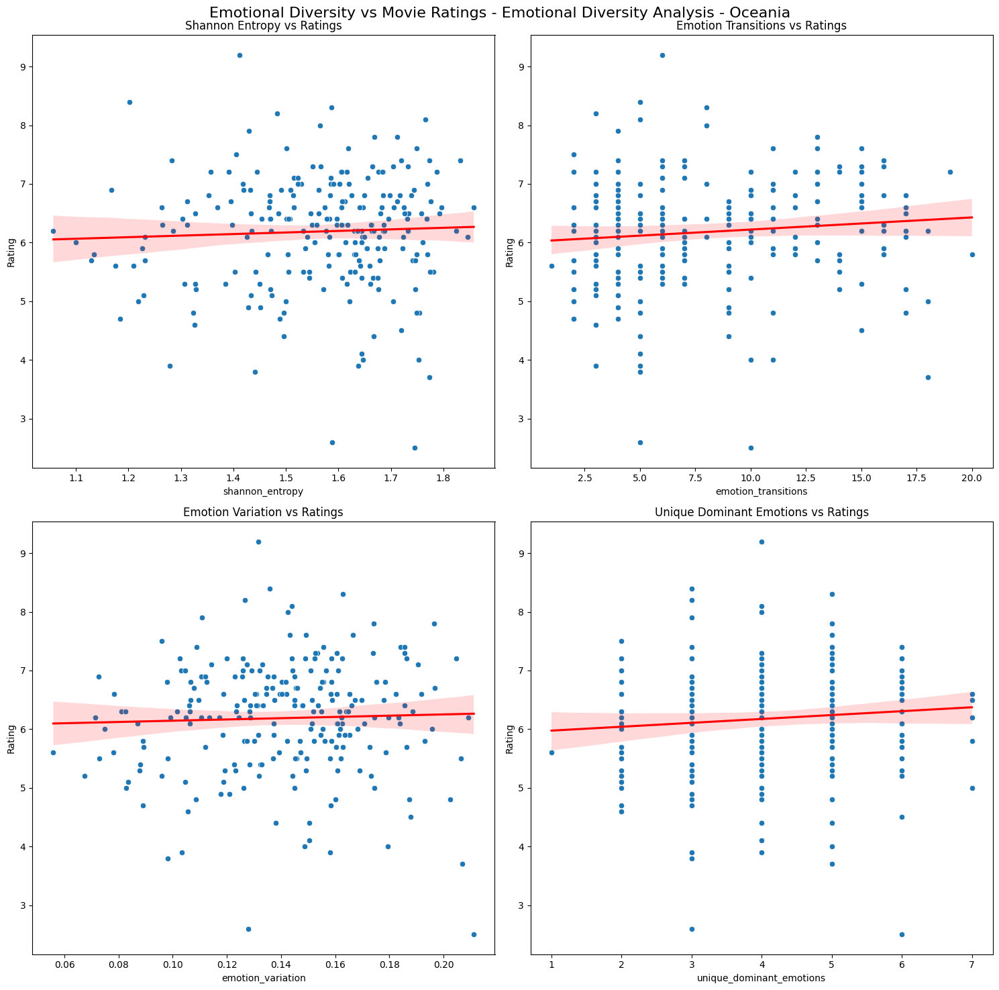

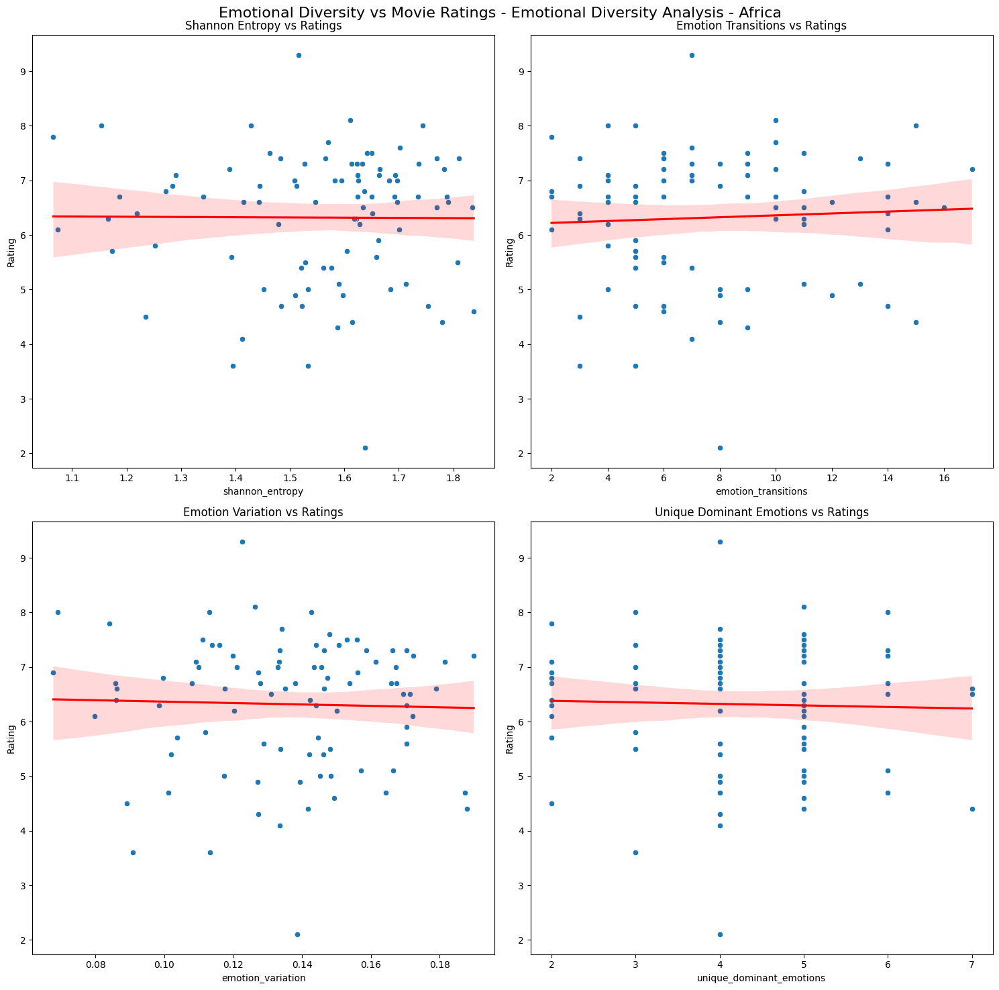

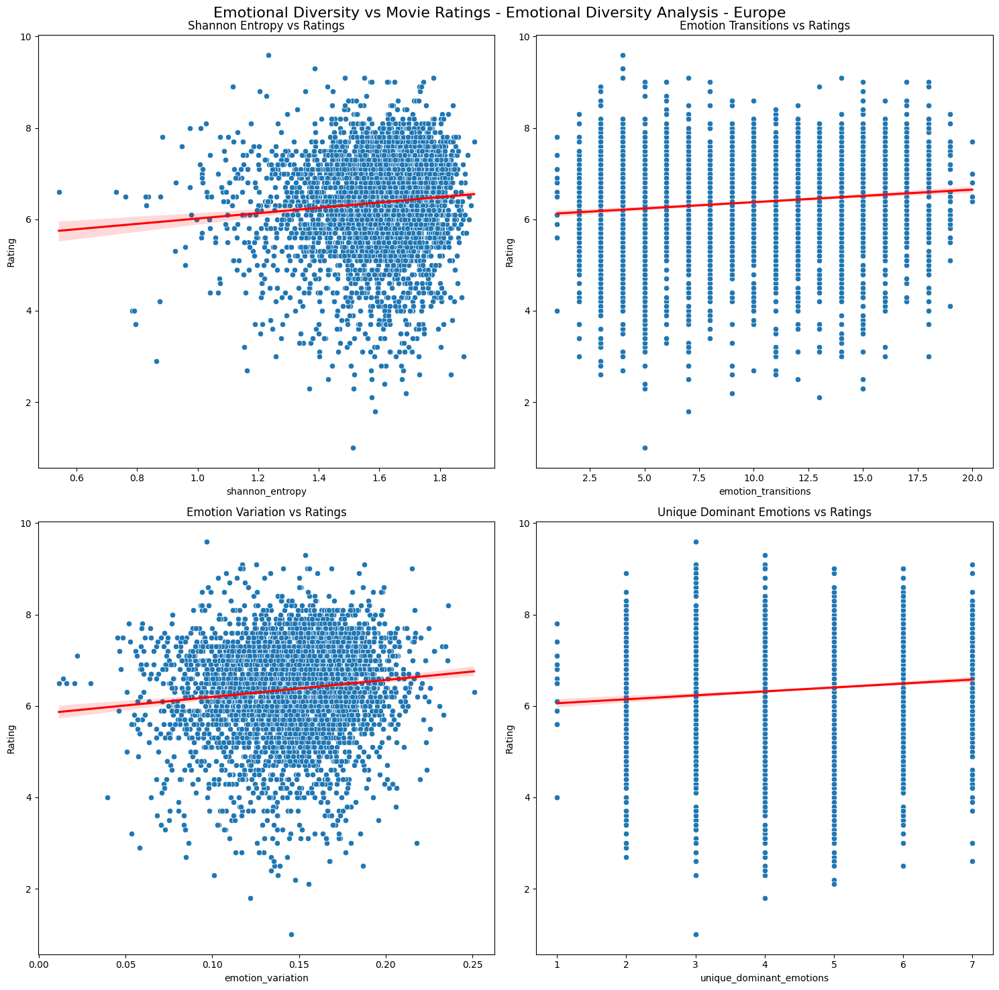

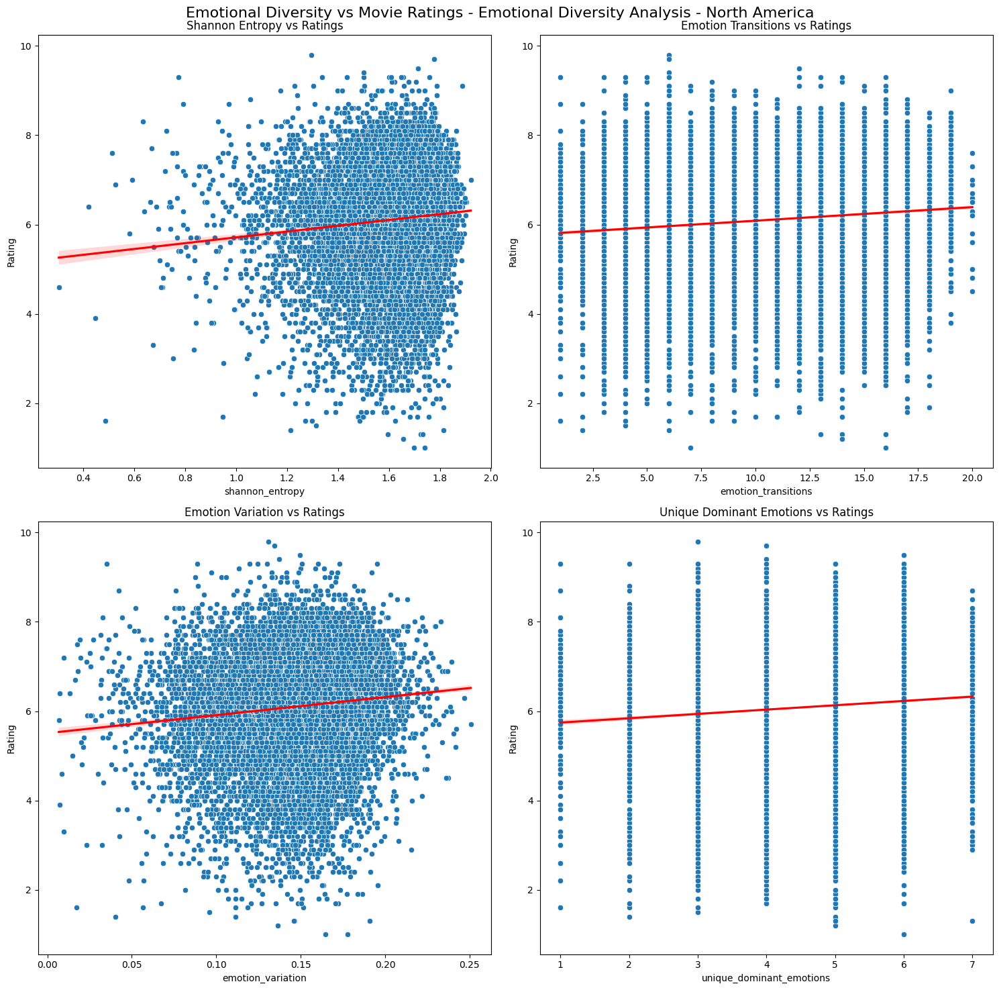

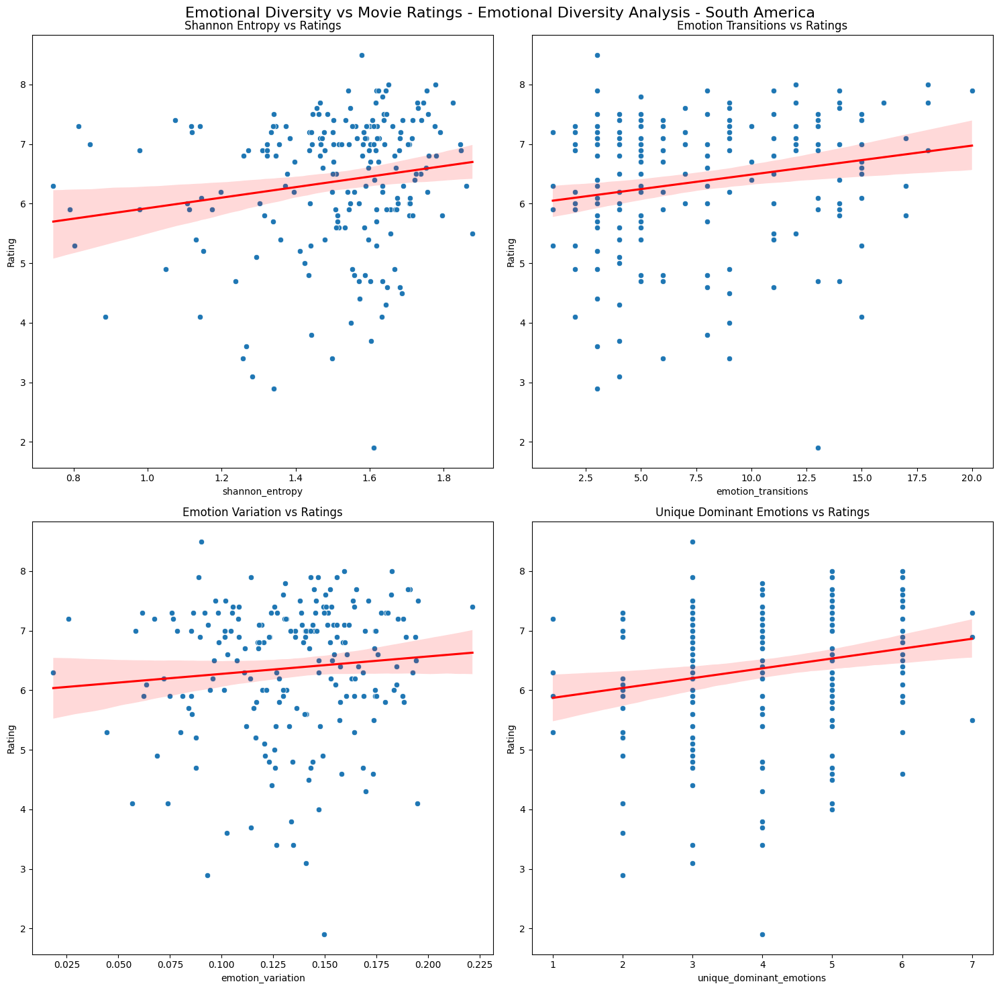

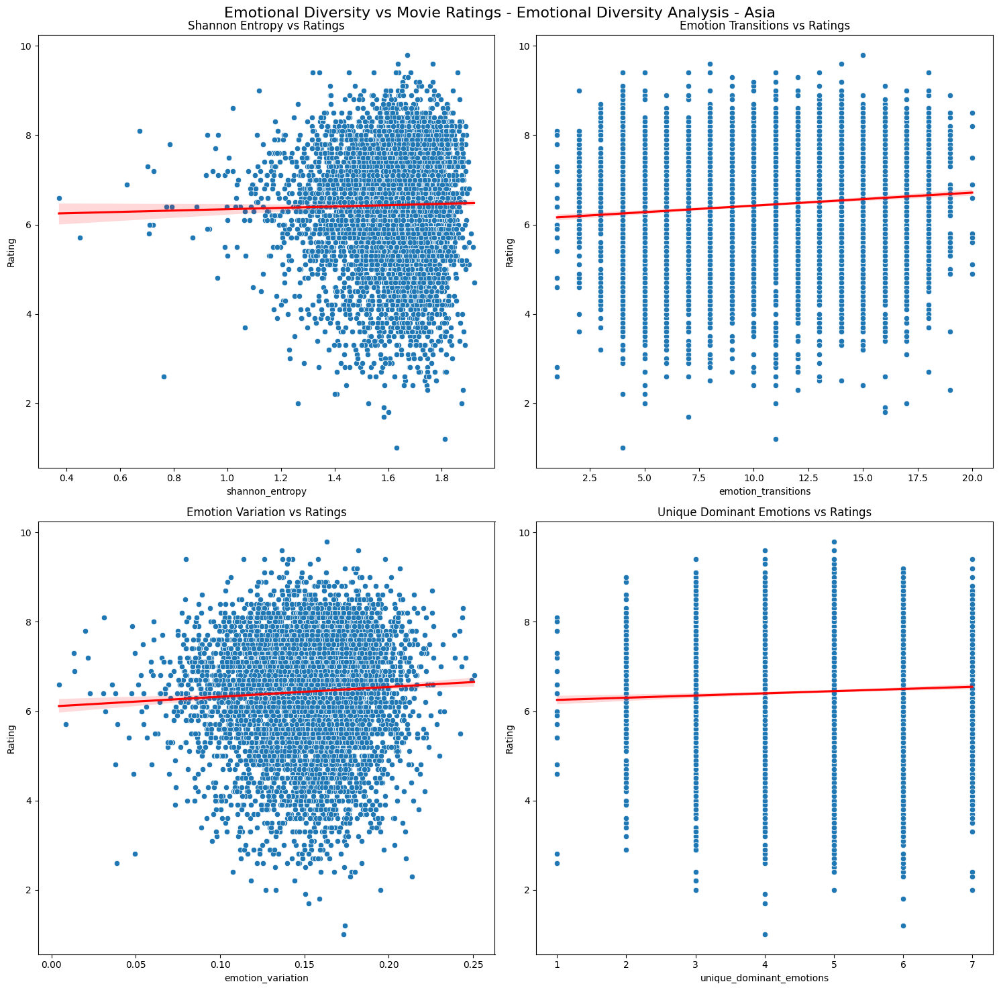

In [ ]:


for emotion_dataset, general_dataset, continent in continent_data:
    diversity_metrics = calculate_emotional_diversity_metrics(emotion_dataset)
    correlations, regression_results, analysis_df = analyze_emotion_diversity_vs_ratings(general_dataset, diversity_metrics)
    
    # Add continent to visualization titles
    main_viz = visualize_diversity_analysis(analysis_df, title=f"Emotional Diversity Analysis - {continent}")
    #supp_viz = create_supplementary_visualizations(dataset.head(10), analysis_df, title=f"Supplementary Analysis - {continent}")
    
    print(f"\nResults for {continent}:")
    # Print correlation results
    for metric, results in correlations.items():
        print(f"\nCorrelation analysis for {metric}:")
        print(f"Correlation coefficient: {results['correlation']:.3f}")
        print(f"P-value: {results['p_value']:.3f}")

    # Print regression results
    for metric, model in regression_results.items():
        print(f"\nRegression analysis for {metric}:")
        print(model.summary().tables[1])

In [23]:
import plotly.graph_objects as go
from ipywidgets import widgets, HTML
from IPython.display import display, clear_output
import numpy as np
import statsmodels.api as sm

def create_and_save_interactive_diversity_plot(continent_data):
    # Create dictionary for metric name mapping
    metric_mapping = {
        'shannon_entropy': 'Shannon Entropy',
        'emotion_transitions': 'Emotion Transitions',
        'emotion_variation': 'Emotion Variation',
        'unique_dominant_emotions': 'Unique Dominant Emotions'
    }
    
    # Process and store all data
    data_store = {}
    for emotion_dataset, general_dataset, continent in continent_data:
        if continent in ['North America', 'Asia', 'Europe', 'South America']:
            diversity_metrics = calculate_emotional_diversity_metrics(emotion_dataset)
            correlations, regression_results, analysis_df = analyze_emotion_diversity_vs_ratings(
                general_dataset, diversity_metrics)
            
            analysis_df['Continent'] = continent
            
            for metric in metric_mapping.keys():
                key = (continent, metric_mapping[metric])
                data_store[key] = {
                    'df': analysis_df,
                    'correlation': correlations[metric]['correlation'],
                    'p_value': correlations[metric]['p_value'],
                    'regression': regression_results[metric],
                    'data_metric': metric
                }
    
    # Create the base figure
    fig = go.Figure()
    
    def create_stat_annotation(continent, metric, data_store):
        """Create annotation with statistical details"""
        key = (continent, metric)
        data = data_store[key]
        
        stats_text = (
            f"<b>Statistical Results:</b><br><br>"
            f"<b>Pearson Correlation:</b> {data['correlation']:.3f}<br>"
            f"<b>P-value:</b> {data['p_value']:.3e}<br>"
            f"<b>OLS Coefficient:</b> {data['regression'].params[1]:.3f}"
        )
        
        return dict(
            text=stats_text,
            x=0.02,
            y=0.98,
            xref="paper",
            yref="paper",
            align="left",
            showarrow=False,
            font=dict(size=12),
            bgcolor="rgba(255, 255, 255, 0.9)",
            bordercolor="rgb(68, 68, 68)",
            borderwidth=1,
            borderpad=10,
            xanchor="left",
            yanchor="top"
        )
    
    # Add all traces with visibility=False
    traces_per_combo = 4  # number of traces per continent-metric combination
    for key, data in data_store.items():
        continent, metric_display = key
        data_metric = data['data_metric']
        df = data['df']
        model = data['regression']
        
        # Create sorted x values for smooth line
        x_sorted = np.sort(df[data_metric])
        X_sorted = sm.add_constant(x_sorted)
        
        # Get prediction and confidence intervals
        y_pred = model.get_prediction(X_sorted)
        y_mean = y_pred.predicted_mean
        y_ci = y_pred.conf_int(alpha=0.05)
        
        # Add traces
        fig.add_trace(go.Scatter(
            x=df[data_metric],
            y=df['Rating'],
            mode='markers',
            name='Movies',
            marker=dict(color='#3498db', opacity=0.6, size=8),
            visible=False,
            customdata=np.column_stack((df['Rating'], df[data_metric])),
            hovertemplate='Rating: %{customdata[0]:.2f}<br>Metric Value: %{customdata[1]:.2f}<extra></extra>'
        ))
        
        fig.add_trace(go.Scatter(
            x=x_sorted,
            y=y_ci[:, 1],
            mode='lines',
            line=dict(width=0),
            showlegend=False,
            visible=False
        ))
        
        fig.add_trace(go.Scatter(
            x=x_sorted,
            y=y_ci[:, 0],
            mode='lines',
            line=dict(width=0),
            fill='tonexty',
            fillcolor='rgba(231, 76, 60, 0.2)',
            name='95% Confidence Interval',
            visible=False
        ))
        
        fig.add_trace(go.Scatter(
            x=x_sorted,
            y=y_mean,
            mode='lines',
            name='Regression Line',
            line=dict(color='#e74c3c', width=2),
            visible=False
        ))
    
    # Create dropdown menus
    continents = sorted(list(set(k[0] for k in data_store.keys())))
    metrics = sorted(list(set(k[1] for k in data_store.keys())))
    
    def create_visibility_array(selected_continent, selected_metric):
        visibility = []
        for continent in continents:
            for metric in metrics:
                key = (continent, metric)
                is_visible = continent == selected_continent and metric == selected_metric
                visibility.extend([is_visible] * traces_per_combo)
        return visibility
    
    # Create buttons for both dropdowns
    continent_buttons = []
    for continent in continents:
        continent_buttons.append(
            dict(
                args=[{
                    "visible": create_visibility_array(continent, metrics[0])
                }, {
                    "annotations": [create_stat_annotation(continent, metrics[0], data_store)]
                }],
                label=continent,
                method="update"
            )
        )
    
    metric_buttons = []
    for metric in metrics:
        metric_buttons.append(
            dict(
                args=[{
                    "visible": create_visibility_array(continents[0], metric)
                }, {
                    "annotations": [create_stat_annotation(continents[0], metric, data_store)]
                }],
                label=metric,
                method="update"
            )
        )
    
    # Update layout
    fig.update_layout(
        title=dict(
            text='Emotional Diversity vs Movie Ratings',
            font=dict(size=24, color='rgb(68, 68, 68)'),
            x=0.5,
            y=0.9
        ),
        xaxis=dict(
            title='Metric Value',
            title_font=dict(size=14),
            tickfont=dict(size=12),
            showgrid=True,
            gridcolor='lightgrey',
        ),
        yaxis=dict(
            title='Rating',
            title_font=dict(size=14),
            tickfont=dict(size=12),
            showgrid=True,
            gridcolor='lightgrey',
        ),
        height=700,
        width=1000,
        plot_bgcolor='white',
        paper_bgcolor='white',
        margin=dict(l=80, r=80, t=180, b=80),
        showlegend=True,
        hoverlabel=dict(
            bgcolor="white",
            font_size=12,
            font_family="Arial"
        ),
        updatemenus=[
            dict(
                buttons=continent_buttons,
                direction="down",
                showactive=True,
                x=0.1,
                xanchor="left",
                y=1.15,
                yanchor="top",
                bgcolor='white',
                bordercolor='rgb(68, 68, 68)',
                borderwidth=1,
                pad=dict(t=10),
                name="Continent"
            ),
            dict(
                buttons=metric_buttons,
                direction="down",
                showactive=True,
                x=0.4,
                xanchor="left",
                y=1.15,
                yanchor="top",
                bgcolor='white',
                bordercolor='rgb(68, 68, 68)',
                borderwidth=1,
                pad=dict(t=10),
                name="Metric"
            )
        ],
        annotations=[
            dict(
                text="Continent:",
                x=0.02,
                y=1.12,
                xref="paper",
                yref="paper",
                showarrow=False,
                font=dict(size=14)
            ),
            dict(
                text="Metric:",
                x=0.32,
                y=1.12,
                xref="paper",
                yref="paper",
                showarrow=False,
                font=dict(size=14)
            )
        ]
    )
    
    # Add initial statistical annotation
    initial_annotation = create_stat_annotation(continents[0], metrics[0], data_store)
    fig.update_layout(annotations=fig.layout.annotations + (initial_annotation,))
    
    # Make first set of traces visible
    for i in range(traces_per_combo):
        fig.data[i].visible = True
    
    return fig

In [24]:
fig_continent_corr_diversity_metric = create_and_save_interactive_diversity_plot(continent_data)
fig_continent_corr_diversity_metric.show()  # Display in notebook as well

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:25: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:33: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\4188100039.py:48: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in 

In [25]:
fig_continent_corr_diversity_metric.write_html("C:/Users/inesa/OneDrive/Documentos/EPFL/Master RO/MA1/ADA/ProjectADA/Datastory/dataffoneurs-story/assets/Plots/PlotsRatings/correlation_continent_diversity.html")

In [13]:
def plot_mean_ratings_with_error(summary_stats):
    """
    Create an interactive bar plot showing mean ratings with error bars using pre-calculated summary statistics
    Returns a Plotly figure that can be saved as HTML
    
    Parameters:
    summary_stats: DataFrame with pre-calculated statistics including mean and std
    """
    
    # Prepare data
    categories = summary_stats.index
    
    # Create figure
    fig = go.Figure()
    
    # Add bar plot with custom hover template
    fig.add_trace(go.Bar(
        x=categories,
        y=summary_stats['mean'],
        error_y=dict(
            type='data',
            array=summary_stats['std'],
            visible=True,
            color='black',
            thickness=1.5,
            width=3
        ),
        marker_color='royalblue',
        opacity=0.7,
        hovertemplate="<b>%{x}</b><br>" +
                      "Mean Rating: %{y:.2f}<br>" +
                      "Number of Movies: %{customdata}<extra></extra>",
        customdata=summary_stats['count']  # Add count data for hover
    ))
    
    # Update layout
    fig.update_layout(
        title='Ratings in Movies according to their Dominant Emotion',
        xaxis_title='Movie Type',
        yaxis_title='Movie Mean Ratings',
        yaxis_range=[4, 8],
        plot_bgcolor='#f0f0f8',
        paper_bgcolor='white',
        showlegend=False,
        yaxis=dict(
            gridcolor='rgba(128,128,128,0.2)',
            gridwidth=1,
            griddash='dash'
        )
    )
    
    return fig

def analyze_ratings_by_dominant_emotion(df, df_general):
    """
    Analyze how movie ratings vary based on the overall dominant emotion of each movie
    
    Parameters:
    df: DataFrame with emotion data for each timestep
    df_general: DataFrame with movie ratings
    """
    # List of emotion columns
    emotion_cols = ['anger', 'disgust', 'fear', 'joy', 'neutral', 'sadness', 'surprise']
    
    # Calculate mean emotion values for each movie
    movie_emotions = df.groupby('Wikipedia_movie_ID')[emotion_cols].mean()
    
    # Find the dominant emotion for each movie
    dominant_emotions = movie_emotions.idxmax(axis=1)
    
    # Create DataFrame with movie IDs and their dominant emotions
    dominant_df = pd.DataFrame(dominant_emotions, columns=['dominant_emotion'])
    
    # Merge with ratings data
    ratings_clean = df_general[['Wikipedia_movie_ID', 'Rating']].dropna(subset=['Rating']).drop_duplicates()
    analysis_df = dominant_df.merge(ratings_clean, left_index=True, right_on='Wikipedia_movie_ID')
    
    # Calculate summary statistics for each dominant emotion
    summary_stats = analysis_df.groupby('dominant_emotion')['Rating'].agg([
        'count',         # Number of movies
        'mean',          # Average rating
        'std',           # Standard deviation of ratings
        'median',        # Median rating
        'min',          # Minimum rating
        'max'           # Maximum rating
    ]).round(2)
    
    return analysis_df, summary_stats


def plot_ratings_by_dominant_emotion(analysis_df, continent=""):
    """
    Create visualizations for rating distribution across dominant emotions
    
    Parameters:
    analysis_df: DataFrame with analysis data
    continent: String indicating the continent for title
    """
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
    
    title_suffix = f" - {continent}" if continent else ""
    
    # 1. Box plot
    sns.boxplot(data=analysis_df, x='dominant_emotion', y='Rating', ax=ax1)
    ax1.set_title(f'Rating Distribution by Dominant Movie Emotion{title_suffix}')
    ax1.set_xlabel('Dominant Emotion')
    ax1.set_ylabel('Movie Rating')
    ax1.tick_params(axis='x', rotation=45)
    
    # 2. Violin plot with stripplot
    sns.violinplot(data=analysis_df, x='dominant_emotion', y='Rating', ax=ax2)
    sns.stripplot(data=analysis_df, x='dominant_emotion', y='Rating', 
                 color='white', alpha=0.2, size=2, jitter=0.2, ax=ax2)
    ax2.set_title(f'Rating Distribution with Individual Movies{title_suffix}')
    ax2.set_xlabel('Dominant Emotion')
    ax2.set_ylabel('Movie Rating')
    ax2.tick_params(axis='x', rotation=45)
    
    plt.tight_layout()
    return fig

def run_dominant_emotion_analysis(df, df_general, continent=""):
    """
    Run complete analysis and create visualizations
    """
    analysis_df, summary_stats = analyze_ratings_by_dominant_emotion(df, df_general)
    fig = plot_ratings_by_dominant_emotion(analysis_df, continent)
    # Add the new visualization
    fig2 = plot_mean_ratings_with_error(summary_stats)
    
    print(f"\nSummary Statistics by Dominant Emotion - {continent}:")
    print(summary_stats)
    
    emotion_groups = [group for _, group in analysis_df.groupby('dominant_emotion')['Rating']]
    f_stat, p_value = stats.f_oneway(*emotion_groups)
    print(f"\nOne-way ANOVA Test Results - {continent}:")
    print(f"F-statistic: {f_stat:.3f}")
    print(f"P-value: {p_value:.3f}")
    
    return analysis_df, summary_stats, fig, fig2

This code: 
- Calculates the mean value for each emotion across all timesteps for each movie
- Determines which emotion has the highest mean value - this becomes the movie's dominant emotion
- Creates separate groups of ratings based on dominant emotion.(All ratings for movies where 'joy' is dominant,  All ratings for movies where 'sadness' is dominant,etc)

A one-way ANOVA test is used to determine whether there are statistically significant differences between the means of two or more independent groups. In our case, we're testing if there are significant differences in movie ratings across different dominant emotions.

The ANOVA test returns two key values:
- F-statistic (f_stat):
        Measures the ratio of variance between the groups to variance within the groups
        Larger F-values suggest greater differences between groups
        A small F-value (close to 1) suggests the groups are similar
        Formula: F = (variance between groups) / (variance within groups)
- P-value:
        Tells us if the differences are statistically significant
        Typically compared to significance level α = 0.05
        If p < 0.05: We reject the null hypothesis, meaning there are significant differences in ratings between at least some emotion groups
        If p ≥ 0.05: We fail to reject the null hypothesis, meaning we cannot conclude there are significant differences

These findings suggest that while emotional content does influence movie ratings, the differences are relatively modest (all means are within about 0.5 points of each other). The statistical significance likely comes from the large sample size rather than large practical differences in ratings.

Summary Statistics by Dominant Emotion:
                  count  mean   std  median  min  max
dominant_emotion                                     
anger              1391  6.29  1.16     6.4  1.0  9.7
disgust            4658  6.24  1.17     6.4  1.0  9.9
fear               1006  5.96  1.18     6.1  1.3  8.9
joy                 513  6.34  1.04     6.4  2.4  9.1
neutral           22455  6.26  1.13     6.4  1.0  9.8
sadness            1814  6.44  1.05     6.5  1.0  9.6
surprise             49  6.07  0.87     6.2  4.0  7.8

One-way ANOVA Test Results:
F-statistic: 19.945
P-value: 0.000

The F-statistic of (>3) indicates there is more variation between emotion groups than within them
The p-value of 0.001 (< 0.05) tells us these differences are statistically significant
We can conclude that the dominant emotion of a movie is associated with significant differences in ratings
However, note that ANOVA only tells us that differences exist - it doesn't tell us:

Which specific emotions have different ratings
The direction of the differences (which emotions have higher/lower ratings)
The magnitude of the differences

To understand these details, you'd need to look at the summary statistics and possibly perform post-hoc tests (like Tukey's HSD) if you want to identify which specific emotions have significantly different ratings from each other.

COMO ES ESTO DISTINTO DEL MIXED EFFECT ANALYSIS, como fear tiene 5,5 en el otro


Summary Statistics by Dominant Emotion - :
                  count  mean   std  median  min  max
dominant_emotion                                     
anger              1391  6.29  1.16     6.4  1.0  9.7
disgust            4658  6.24  1.17     6.4  1.0  9.9
fear               1006  5.96  1.18     6.1  1.3  8.9
joy                 513  6.34  1.04     6.4  2.4  9.1
neutral           22455  6.26  1.13     6.4  1.0  9.8
sadness            1814  6.44  1.05     6.5  1.0  9.6
surprise             49  6.07  0.87     6.2  4.0  7.8

One-way ANOVA Test Results - :
F-statistic: 19.945
P-value: 0.000


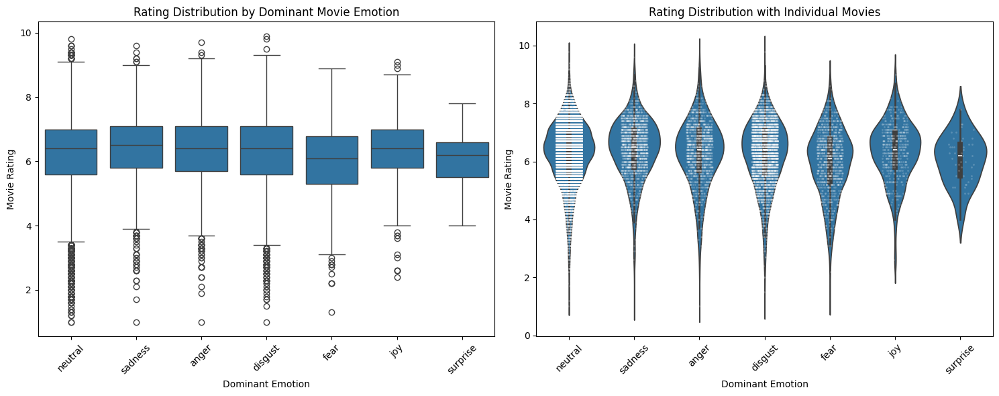

In [14]:
analysis_df, summary_stats, fig,  fig_mean_rating_dominant_emotion = run_dominant_emotion_analysis(df_emotion, df_metadata)
plt.show()

In [15]:
fig_mean_rating_dominant_emotion.write_html("C:/Users/inesa/OneDrive/Documentos/EPFL/Master RO/MA1/ADA/ProjectADA/Datastory/dataffoneurs-story/assets/Plots/PlotsRatings/mean_rating_per_dominant_emotion.html")

without separating between continents, the key implications:

Emotional content doesn't strongly predict ratings
Most movies cluster around above-average ratings regardless of dominant emotion
Each emotion category contains both critically acclaimed and poorly received films
The bimodal distribution suggests possible genre or quality tiers within each emotion category


Summary Statistics by Dominant Emotion - Oceania:
                  count  mean   std  median  min  max
dominant_emotion                                     
anger                 7  5.73  0.78    6.10  4.4  6.5
disgust              32  6.05  0.98    6.35  2.6  8.0
fear                  7  5.21  1.46    5.80  2.5  6.4
joy                   7  6.80  1.10    6.90  5.1  8.2
neutral             158  6.23  0.90    6.30  3.7  8.4
sadness              19  6.34  1.02    6.20  4.0  9.2

One-way ANOVA Test Results - Oceania:
F-statistic: 2.726
P-value: 0.021


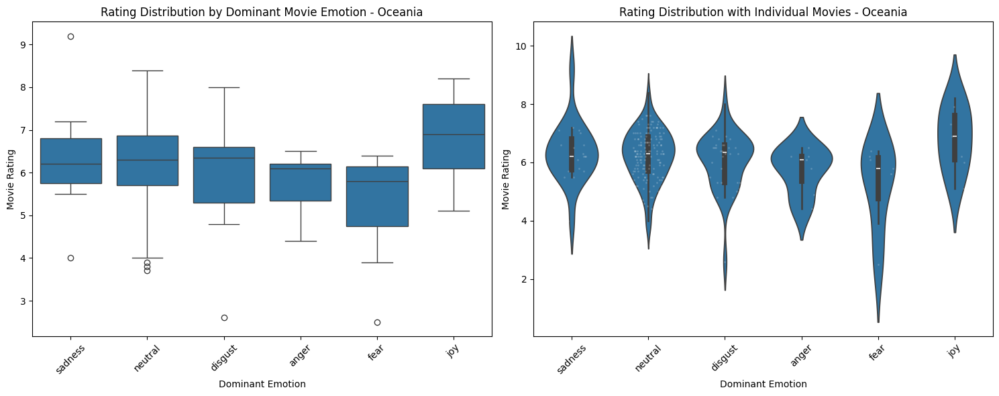


Summary Statistics by Dominant Emotion - Africa:
                  count  mean   std  median  min  max
dominant_emotion                                     
anger                 9  7.13  1.30    7.10  4.9  9.3
disgust              27  6.09  1.09    6.50  3.6  7.6
fear                  3  4.73  1.15    4.70  3.6  5.9
joy                   2  6.95  0.35    6.95  6.7  7.2
neutral              44  6.28  1.20    6.60  2.1  8.0
sadness               7  6.91  0.90    7.10  5.1  8.0

One-way ANOVA Test Results - Africa:
F-statistic: 2.766
P-value: 0.023


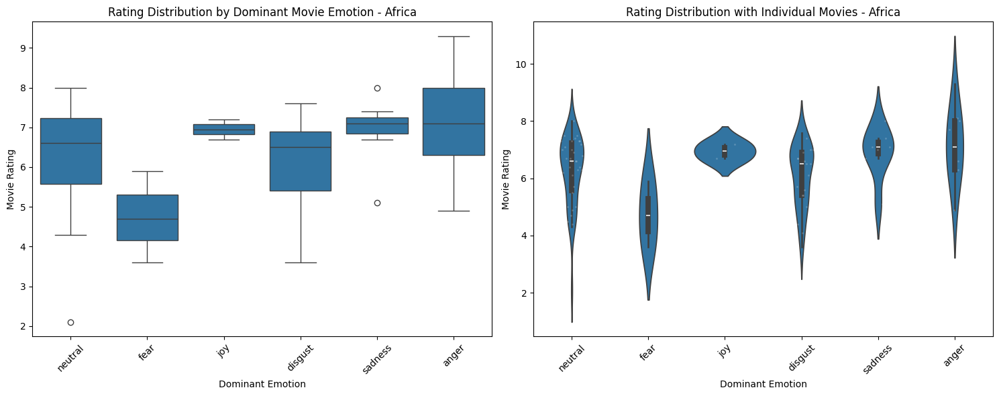


Summary Statistics by Dominant Emotion - Europe:
                  count  mean   std  median  min  max
dominant_emotion                                     
anger               172  6.41  1.05     6.6  3.0  8.6
disgust             998  6.39  1.01     6.5  2.4  9.1
fear                195  6.30  1.04     6.4  2.2  8.8
joy                  73  6.42  0.89     6.6  4.5  8.9
neutral            2680  6.35  1.03     6.5  1.8  9.6
sadness             315  6.46  0.98     6.6  1.0  9.0
surprise              7  6.23  1.05     6.2  5.1  7.8

One-way ANOVA Test Results - Europe:
F-statistic: 0.853
P-value: 0.529


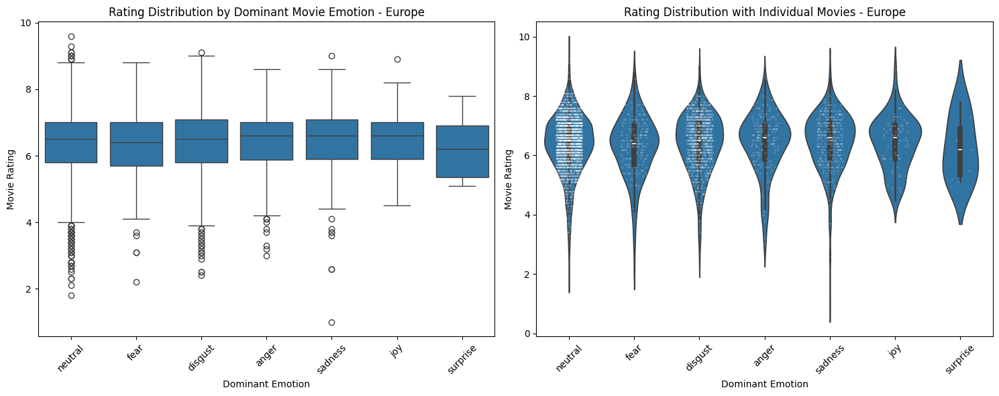


Summary Statistics by Dominant Emotion - North America:
                  count  mean   std  median  min  max
dominant_emotion                                     
anger               575  6.14  1.07     6.2  1.9  9.7
disgust            1730  5.94  1.22     6.1  1.5  9.5
fear                489  5.75  1.20     5.8  1.3  8.6
joy                 167  6.15  0.96     6.3  2.4  8.1
neutral           11468  6.13  1.11     6.3  1.0  9.8
sadness             671  6.32  0.96     6.4  2.1  9.1
surprise             18  5.87  0.69     6.0  4.4  6.8

One-way ANOVA Test Results - North America:
F-statistic: 20.135
P-value: 0.000


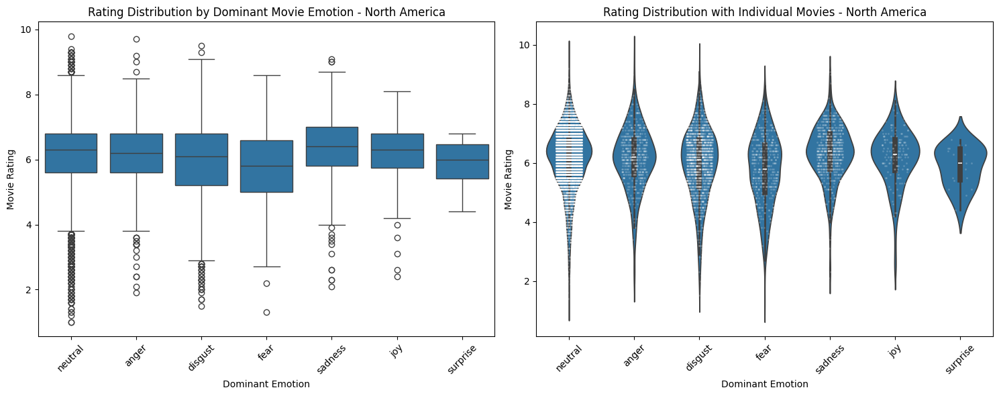


Summary Statistics by Dominant Emotion - South America:
                  count  mean   std  median  min  max
dominant_emotion                                     
anger                 7  7.10  0.70    7.00  6.2  8.0
disgust              56  6.40  1.11    6.80  3.4  7.9
fear                  7  5.99  0.48    5.90  5.3  6.8
joy                   7  6.44  1.05    6.90  4.5  7.6
neutral             116  6.33  1.21    6.75  1.9  8.5
sadness              11  6.58  0.82    6.70  5.2  7.9
surprise              1  4.90   NaN    4.90  4.9  4.9

One-way ANOVA Test Results - South America:
F-statistic: 1.001
P-value: 0.426


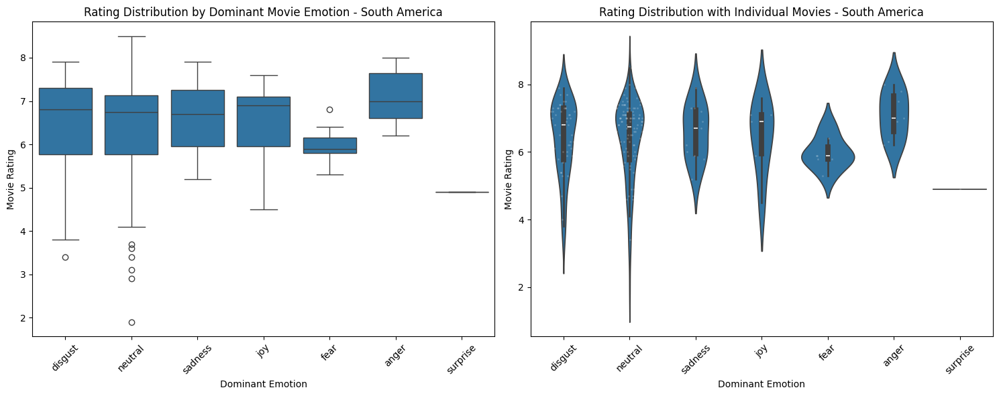


Summary Statistics by Dominant Emotion - Asia:
                  count  mean   std  median  min  max
dominant_emotion                                     
anger               461  6.39  1.31     6.6  1.0  9.4
disgust             884  6.47  1.19     6.6  2.4  9.8
fear                141  6.08  1.23     6.2  2.2  8.9
joy                 203  6.46  1.12     6.6  2.6  9.1
neutral            4649  6.44  1.24     6.6  1.2  9.6
sadness             532  6.46  1.27     6.7  1.7  9.6
surprise             16  6.20  0.93     6.1  4.0  7.7

One-way ANOVA Test Results - Asia:
F-statistic: 2.392
P-value: 0.026


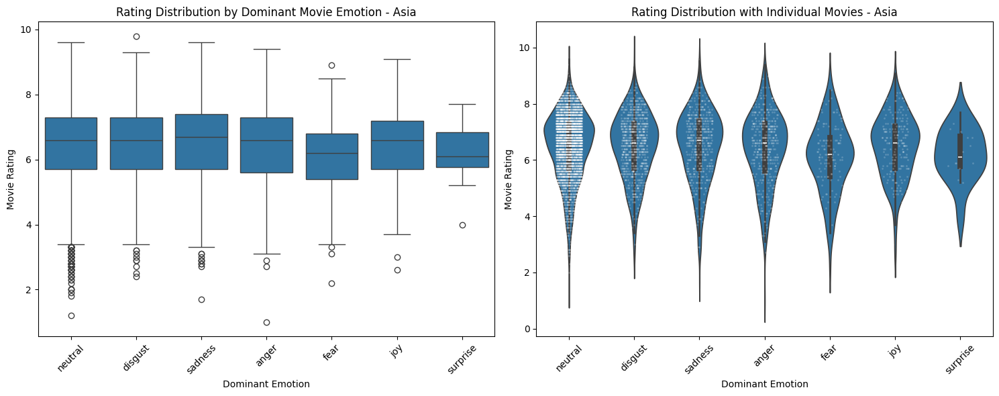

In [22]:
for emotion_dataset, general_dataset, continent in continent_data:
    analysis_df, summary_stats, fig = run_dominant_emotion_analysis(emotion_dataset, general_dataset,continent)
    plt.show()

In [23]:
!pip3 install statsmodels

In [37]:

def mixed_effects_analysis(df_emotion, df_general):
    """
    Perform mixed effects analysis on movie ratings with emotional diversity as fixed effect
    and categories as random effects. Each movie can belong to multiple categories.
    
    Parameters:
    df_emotion: DataFrame containing emotion columns, timestep, and Wikipedia_movie_ID
    df_general: DataFrame containing Wikipedia_movie_ID, Rating, and category column
    """
    # List of emotion columns
    emotion_cols = ['anger', 'disgust', 'fear', 'joy', 'neutral', 'sadness', 'surprise']

    def calculate_shannon_entropy(movie_data):
        # Calculate mean emotion values across timesteps
        mean_emotions = movie_data[emotion_cols].mean()
        # Normalize to create probability distribution
        prob_dist = mean_emotions / mean_emotions.sum()
        return entropy(prob_dist)
    
    # Calculate emotional diversity for each movie
    emotional_diversity = df_emotion.groupby('Wikipedia_movie_ID').apply(calculate_shannon_entropy)

    # Convert to DataFrame
    diversity_df = pd.DataFrame(emotional_diversity, columns=['emotional_diversity'])
    
    # Merge with general movie information
    base_df = diversity_df.merge(
        df_general[['Wikipedia_movie_ID', 'Rating', 'category']], 
        left_index=True, 
        right_on='Wikipedia_movie_ID'
    )
    
    # Create expanded DataFrame where each movie-category combination is a row
    expanded_rows = []
    
    for _, row in base_df.iterrows():
        categories = row['category']
        # Handle different possible formats of category data
        if isinstance(categories, str):
            # If categories are in string format, split them
            category_list = [cat.strip() for cat in categories.split(',')]
        elif isinstance(categories, list):
            # If categories are already in list format
            category_list = categories
        else:
            # Single category case
            category_list = [categories]
            
        # Create a row for each category
        for cat in category_list:
            expanded_rows.append({
                'Wikipedia_movie_ID': row['Wikipedia_movie_ID'],
                'Rating': row['Rating'],
                'emotional_diversity': row['emotional_diversity'],
                'category': cat.strip()
            })
    
    # Convert expanded rows to DataFrame
    analysis_df = pd.DataFrame(expanded_rows)
    
    # Remove any rows with missing values
    analysis_df = analysis_df.dropna()
    
    # Fit mixed effects model
    model = MixedLM(analysis_df['Rating'], 
                    analysis_df[['emotional_diversity']], 
                    groups=analysis_df['category'])
    result = model.fit()
    
    # Calculate statistics by category
    category_stats = analysis_df.groupby('category').agg({
        'Wikipedia_movie_ID': 'count',
        'emotional_diversity': 'mean',
        'Rating': 'mean'
    }).reset_index()
    
    # Rename columns for clarity
    category_stats.columns = ['Category', 'Number of Movies', 'Mean Diversity', 'Mean Rating']
    
    # Calculate coefficients and p-values for each category
    category_coefficients = []
    for category in category_stats['Category']:
        category_data = analysis_df[analysis_df['category'] == category]
        if len(category_data) > 0:
            model = LinearRegression()
            X = category_data[['emotional_diversity']]
            y = category_data['Rating']
            model.fit(X, y)
            
            # Calculate p-value
            n = len(category_data)
            predictions = model.predict(X)
            mse = np.sum((y - predictions) ** 2) / (n - 2)
            var_b = mse / np.sum((X - X.mean()) ** 2)
            sd_b = np.sqrt(var_b)
            t_stat = model.coef_[0] / sd_b
            p_value = float(2 * (1 - stats.t.cdf(abs(t_stat), n - 2)))  # Convert to float
            
            category_coefficients.append({
                'Category': category,
                'Coefficient': float(model.coef_[0]),  # Convert to float
                'P-value': p_value
            })
    
    coefficients_df = pd.DataFrame(category_coefficients)
    
    # Merge all statistics
    final_stats = category_stats.merge(coefficients_df, on='Category', how='left')
    
    # Print the formatted output
    print("\nNumber of Movies Coefficient P-value Mean Diversity")
    print("================================================")
    for _, row in final_stats.iterrows():
        try:
            print(f"{row['Category']:<20} {row['Number of Movies']:>8.1f} {row['Coefficient']:>10.6f} {row['P-value']:>12.6e} {row['Mean Diversity']:>10.6f}")
        except (TypeError, ValueError) as e:
            print(f"Error processing row {row['Category']}: {e}")
            continue
    
    print("\nMean Rating")
    print("===========")
    for _, row in final_stats.iterrows():
        try:
            print(f"{row['Category']:<20} {row['Mean Rating']:>10.6f}")
        except (TypeError, ValueError) as e:
            print(f"Error processing row {row['Category']}: {e}")
            continue
    
    return result, analysis_df, final_stats

def visualize_results(analysis_df, max_categories=10):
    """
    Create visualizations for the analysis results with proper handling of large datasets.
    
    Parameters:
    analysis_df: DataFrame with the analysis results
    max_categories: Maximum number of categories to show in the main plot
    """
    # Get top categories by number of movies
    category_counts = analysis_df['category'].value_counts()
    top_categories = category_counts.head(max_categories).index
    
    # Create main plot with top categories
    plt.figure(figsize=(12, 6))
    
    # Filter for top categories
    plot_df = analysis_df[analysis_df['category'].isin(top_categories)]
    
    # Create scatter plot
    sns.scatterplot(
        data=plot_df,
        x='emotional_diversity',
        y='Rating',
        hue='category',
        alpha=0.6,
        s=50  # Adjust point size
    )
    
    plt.title(f'Rating vs Emotional Diversity (Top {max_categories} Categories)')
    plt.xlabel('Emotional Diversity (Shannon Entropy)')
    plt.ylabel('Rating')
    
    # Adjust legend
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    
    # Create summary statistics
    print("\nCategory Statistics:")
    print(f"Total number of categories: {len(category_counts)}")
    print(f"Average categories per movie: {analysis_df.groupby('Wikipedia_movie_ID')['category'].count().mean():.2f}")
    print(f"\nTop {max_categories} categories by number of movies:")
    print(category_counts.head(max_categories))
    
    # Optional: Create boxplot of ratings by top categories
    plt.figure(figsize=(12, 6))
    sns.boxplot(data=plot_df, x='category', y='Rating')
    plt.xticks(rotation=45, ha='right')
    plt.title(f'Rating Distribution by Category (Top {max_categories} Categories)')
    plt.tight_layout()
    
    return plt

# Example usage:
# result, analysis_df, stats = mixed_effects_analysis(df_emotion, df_general)
# visualize_results(analysis_df)

In [39]:
import plotly.express as px
import plotly.graph_objects as go
import pandas as pd

def plot_mean_ratings_interactive(final_stats):
    """
    Create an interactive bar plot of mean ratings by movie category using Plotly.
    Includes movie count information in hover text.
    
    Parameters:
    final_stats: DataFrame containing 'Category', 'Mean Rating', and 'Number of Movies' columns
    
    Returns:
    fig: Plotly figure object that can be shown with fig.show()
    """
    # Sort the data by mean rating in descending order
    sorted_data = final_stats.sort_values('Mean Rating', ascending=False)
    
    # Create the figure using Plotly Graph Objects
    fig = go.Figure()
    
    # Add bar trace with enhanced hover information
    fig.add_trace(go.Bar(
        x=sorted_data['Category'],
        y=sorted_data['Mean Rating'],
        text=sorted_data['Mean Rating'].round(2),  # Show rating values on bars
        textposition='auto',
        marker_color='#4F46E5',  # Indigo color
        hovertemplate=(
            "<b>%{x}</b><br>" +
            "Mean Rating: %{y:.2f}<br>" +
            "Number of Movies: %{customdata:,}<br>" +  # Add movie count with comma formatting
            "<extra></extra>"
        ),
        customdata=sorted_data['Number of Movies']  # Add movie count data for hover
    ))
    
    # Update layout with better styling
    fig.update_layout(
        title={
            'text': 'Mean Rating by Movie Category',
            'y':0.95,
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top',
            'font': {'size': 24}
        },
        xaxis_title="Category",
        yaxis_title="Mean Rating",
        yaxis_range=[5, 7],  # Set y-axis range to better show differences
        showlegend=False,
        xaxis_tickangle=-45,  # Rotate x-axis labels
        hoverlabel=dict(
            bgcolor="white",
            font_size=14,
            font_family="Roboto"
        ),
        # Make it more responsive
        height=600,
        margin=dict(t=100, l=70, r=40, b=80),
        paper_bgcolor='white',
        plot_bgcolor='rgba(0,0,0,0)',
    )
    
    # Add grid lines only for y-axis
    fig.update_yaxes(
        showgrid=True,
        gridwidth=1,
        gridcolor='rgba(0,0,0,0.1)'
    )
    
    return fig

# Example usage:
# fig = plot_mean_ratings_interactive(final_stats)
# fig.show()

# Optional: Save as HTML file for sharing
# fig.write_html("movie_ratings.html")

In [43]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

def plot_category_analysis_interactive(final_stats):
    """
    Create an interactive plot showing category analysis with sample sizes and diversity coefficients.
    
    Parameters:
    final_stats: DataFrame containing Category, Number of Movies, and Coefficient columns
    
    Returns:
    fig: Plotly figure object that can be shown with fig.show()
    """
    # Sort data by number of movies for better visualization
    sorted_data = final_stats.sort_values('Number of Movies', ascending=True)
    
    # Create figure with secondary y-axis
    fig = make_subplots(specs=[[{"secondary_y": True}]])
    
    # Add bar trace for number of movies
    fig.add_trace(
        go.Bar(
            name="Sample Size",
            x=sorted_data['Category'],
            y=sorted_data['Number of Movies'],
            marker_color='#818cf8',
            opacity=0.7,
            hovertemplate=(
                "<b>%{x}</b><br>" +
                "Number of Movies: %{y:,}<br>" +
                "<extra></extra>"
            )
        ),
        secondary_y=False
    )
    
    # Add line trace for coefficients
    fig.add_trace(
        go.Scatter(
            name="Diversity Effect",
            x=sorted_data['Category'],
            y=sorted_data['Coefficient'],
            mode='lines+markers',
            line=dict(color='#e11d48', width=3),
            marker=dict(size=8),
            hovertemplate=(
                "<b>%{x}</b><br>" +
                "Coefficient: %{y:.3f}<br>" +
                "p-value: %{customdata:.2e}<br>" +
                "<extra></extra>"
            ),
            customdata=sorted_data['P-value']
        ),
        secondary_y=True
    )
    
    # Update layout
    fig.update_layout(
        title={
            'text': 'Category Analysis: Sample Size vs Diversity Effect',
            'y':0.95,
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top',
            'font': {'size': 24}
        },
        showlegend=True,
        legend=dict(
            yanchor="top",
            y=0.99,
            xanchor="left",
            x=0.01,
            bgcolor="rgba(255,255,255,0.8)"
        ),
        xaxis_tickangle=-45,
        height=600,
        margin=dict(t=100, l=70, r=70, b=80),
        paper_bgcolor='white',
        plot_bgcolor='rgba(0,0,0,0)',
    )
    
    # Update axes labels
    fig.update_yaxes(
        title_text="Number of Movies",
        secondary_y=False,
        showgrid=True,
        gridwidth=1,
        gridcolor='rgba(0,0,0,0.1)'
    )
    fig.update_yaxes(
        title_text="Diversity Effect Coefficient",
        secondary_y=True,
        showgrid=False
    )
    
    return fig

# Example usage:
# fig2 = plot_category_analysis_interactive(stats)
# fig2.show()

In [46]:
result, analysis_df, stats = mixed_effects_analysis(df_emotion, df_metadata)
print(result.summary())
# visualize_results(analysis_df)
fig = plot_mean_ratings_interactive(stats)
fig.show()
fig2 = plot_category_analysis_interactive(stats)
fig2.show()

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\3897026120.py:21: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.




Number of Movies Coefficient P-value Mean Diversity
Action/Adventure       7827.0   0.875154 0.000000e+00   1.605705
Comedy                10556.0   0.643531 0.000000e+00   1.596706
Drama                 16713.0   0.491766 0.000000e+00   1.616115
Family/Animation       3153.0   0.249883 4.117833e-02   1.580420
Fantasy/Sci-Fi         3758.0   0.519693 7.520481e-05   1.591018
Horror                 3425.0   0.967676 1.082689e-12   1.610742
Romance                6533.0   0.683828 4.440892e-16   1.631223
Thriller               8002.0   0.835181 0.000000e+00   1.623423

Mean Rating
Action/Adventure       6.101495
Comedy                 6.205409
Drama                  6.518124
Family/Animation       6.273549
Fantasy/Sci-Fi         5.958968
Horror                 5.546161
Romance                6.333966
Thriller               6.203287
            Mixed Linear Model Regression Results
Model:               MixedLM  Dependent Variable:  Rating     
No. Observations:    59967    Method:        

C:\Users\inesa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)

C:\Users\inesa\AppData\Local\Temp\ipykernel_12076\3897026120.py:97: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)

C:\Users\inesa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain 

In [42]:
fig.write_html("C:/Users/inesa/OneDrive/Documentos/EPFL/Master RO/MA1/ADA/ProjectADA/Datastory/dataffoneurs-story/assets/Plots/PlotsRatings/mean_rating_by_category.html")

1. Overall Mixed Effects Model Results:
- The model shows a significant positive relationship between emotional diversity and ratings (coefficient = 0.643, p < 0.001)
- This indicates that, across all genres, higher emotional diversity tends to be associated with higher ratings
- The 95% confidence interval [0.587, 0.700] suggests this effect is quite reliable
- The model explains a substantial amount of variation given the large sample size (59,967 observations)

2. Genre-Specific Effects (ordered by strength of relationship):
- Horror shows the strongest relationship (coef = 0.968)
- Action/Adventure follows closely (coef = 0.875)
- Thriller shows a strong effect (coef = 0.835)
- Romance (coef = 0.684) and Comedy (coef = 0.644) show moderate effects
- Drama (coef = 0.492) and Fantasy/Sci-Fi (coef = 0.520) show moderate effects
- Family/Animation shows the weakest relationship (coef = 0.250)

3. Mean Ratings Analysis:
- Drama has the highest average rating (6.52)
- Romance (6.33) and Family/Animation (6.27) follow
- Horror has the lowest average rating (5.55)
- Most genres cluster around 6.0-6.5
- The spread between highest and lowest is approximately 1 point

4. Emotional Diversity Patterns:
- Romance shows the highest mean emotional diversity (1.63)
- Thriller and Drama also show high diversity (1.62 and 1.62 respectively)
- Family/Animation shows the lowest emotional diversity (1.58)
- The range of diversity scores is relatively narrow (0.05 points)

- All sample sizes are large enough for reliable statistical inference

Key Insights:
1. The strong positive coefficients across all genres suggest that emotional diversity generally enhances viewer ratings
2. Horror films show the strongest benefit from emotional diversity, despite having the lowest mean ratings
3. Family/Animation shows the weakest relationship, suggesting emotional consistency might be more important for this genre
4. All relationships are statistically significant (all p-values < 0.05)
5. The large sample sizes and consistent direction of effects suggest these findings are robust



We then perform a mixed effects analysis with emotional diversity, selecting a unique emotion diversity metric, the Shannon entropy. The aim is to show how emotional diversity affects ratings within each category.

The model shows a significant positive relationship between emotional diversity and ratings (coefficient = 0.643, p < 0.001). This indicates that, across all genres, higher emotional diversity tends to be associated with higher ratings

Horror shows the strongest relationship, with Action/Adventure and Thriller following closely. Family/Animation shows the weakest relationship. The strong positive coefficients across all genres suggest that emotional diversity generally enhances viewer ratings. Horror films show the strongest benefit from emotional diversity, despite having the lowest mean ratings. Family/Animation shows the weakest relationship, suggesting emotional consistency might be more important for this genre

## Clusters and emotions

In [3]:
# Define the paths to the data files
DATA_PATH_emotion = "data_sentiment_analysis/emotions_interpolated_20.pkl"  # Path to the CSV file containing sentence emotions data
DATA_PATH_MOVIE_METADATA = "data_sentiment_analysis/final_dataset.pkl"  # Path to the pickle file containing movie metadata

df_emotions = pd.read_pickle(DATA_PATH_emotion)
df_emotions_mean  = df_emotions.drop('timestep', axis=1).groupby('Wikipedia_movie_ID').mean().reset_index()

with open(DATA_PATH_MOVIE_METADATA, 'rb') as f:
    df_metadata = pickle.load(f)

# df_metadata.sample(3)

In [4]:
emotion_columns = ['fear', 'sadness', 'surprise', 'neutral']
emotions_columns_all = ["anger", "disgust", "fear", "joy", "neutral", "sadness", "surprise"] 

#keep only the films that are in categories
data = df_emotions.drop('timestep', axis=1).groupby('Wikipedia_movie_ID')[emotion_columns].mean()
data = data.merge(df_metadata[['Wikipedia_movie_ID', 'category']], on='Wikipedia_movie_ID')
data = data.explode('category')
data_with_category = data.dropna()
#a movie can be in more than 1 categories, so we need to keep only 1 sample per movie (hence drop_duplicates())
data = data_with_category.drop(['category'], axis=1).drop_duplicates()
data_with_category = data_with_category['category']

#keep only the films that are in categories
data_all_emotions = df_emotions.drop('timestep', axis=1).groupby('Wikipedia_movie_ID')[emotions_columns_all].mean()
data_all_emotions = data_all_emotions.merge(df_metadata[['Wikipedia_movie_ID', 'category']], on='Wikipedia_movie_ID')
data_all_emotions = data_all_emotions.explode('category')
data_with_category_all_col = data_all_emotions.dropna()
#a movie can be in more than 1 categories, so we need to keep only 1 sample per movie (hence drop_duplicates())
data_all_emotions = data_with_category_all_col.drop(['category'], axis=1).drop_duplicates()
data_with_category_all_col = data_with_category_all_col['category']

C:\Users\inesa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\inesa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\inesa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set

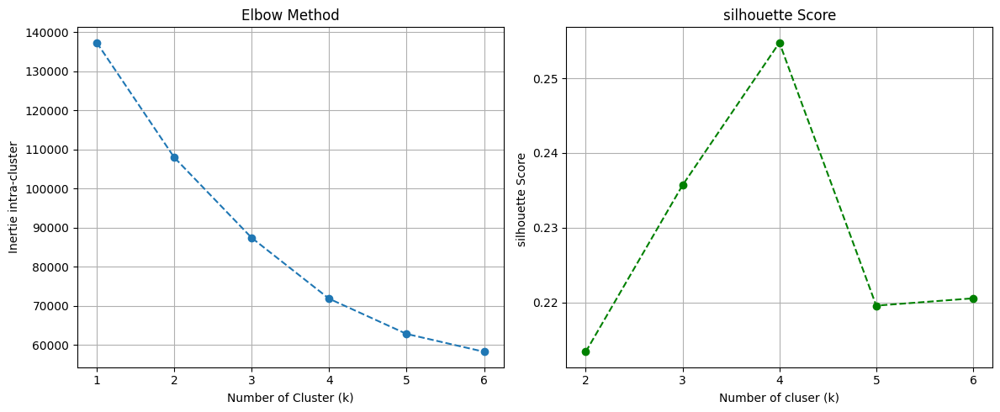

In [5]:
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data.drop('Wikipedia_movie_ID', axis=1))

inertias = []
silhouette_scores = []
k_values = range(1, 7) 

for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(data_scaled)
    
    inertias.append(kmeans.inertia_)
    #k=1 does not work with the silhouette score
    if k > 1:
        silhouette_avg = silhouette_score(data_scaled, labels)
        silhouette_scores.append(silhouette_avg)

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(k_values, inertias, marker='o', linestyle='--')
plt.title('Elbow Method')
plt.xlabel('Number of Cluster (k)')
plt.ylabel('Inertie intra-cluster')
plt.xticks(k_values)
plt.grid(True)

plt.subplot(1, 2, 2)
plt.plot(k_values[1:], silhouette_scores, marker='o', linestyle='--', color='green') 
plt.title('silhouette Score')
plt.xlabel('Number of cluser (k)')
plt.ylabel('silhouette Score ')
plt.xticks(k_values[1:])
plt.grid(True)

plt.tight_layout()
plt.show()


In [6]:
data_kmeans = data.copy(deep=True)

n_clusters = 4
kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=1000)
clusters = kmeans.fit_predict(data_scaled)

data_kmeans['cluster_km'] = clusters


data_kmeans = data_kmeans.merge(df_metadata[['Wikipedia_movie_ID', 'category']], on='Wikipedia_movie_ID')

In [7]:
# Group by cluster and get list of movie IDs
movies_by_cluster = data_kmeans.groupby('cluster_km')['Wikipedia_movie_ID'].apply(list)

# Print movies in each cluster
for cluster in range(n_clusters):
    print(f"\nCluster {cluster} movies:")
    print(movies_by_cluster[cluster])


Cluster 0 movies:
[3333, 3947, 4227, 5729, 9429, 11585, 11701, 13290, 21037, 26541, 28269, 30625, 31371, 33124, 40672, 41528, 42093, 42159, 42224, 42225, 42293, 42294, 42313, 42361, 42507, 44122, 44210, 44366, 45242, 50486, 51563, 54160, 54175, 55447, 55495, 60157, 60164, 60293, 61046, 61058, 61062, 61074, 61141, 61160, 61168, 61173, 61176, 61191, 61323, 61480, 61484, 61505, 61507, 61508, 61514, 61519, 61522, 61525, 61529, 61664, 62095, 62110, 62111, 62687, 64291, 64394, 64657, 65669, 66870, 67371, 67414, 68078, 68084, 68088, 68108, 68119, 70508, 73368, 73380, 73392, 73402, 73405, 73425, 73467, 73498, 73585, 73875, 73882, 73970, 74381, 74387, 74823, 74856, 74862, 74868, 74904, 74942, 74966, 74979, 75263, 75933, 76040, 76301, 76335, 76349, 76353, 76375, 76399, 76627, 77593, 77605, 77619, 77653, 77672, 77685, 78425, 79848, 80499, 80510, 80923, 88075, 89445, 89793, 90684, 92539, 92540, 92566, 92596, 92688, 93559, 93760, 95953, 96893, 97732, 97740, 97769, 98164, 98503, 99022, 99025, 99948

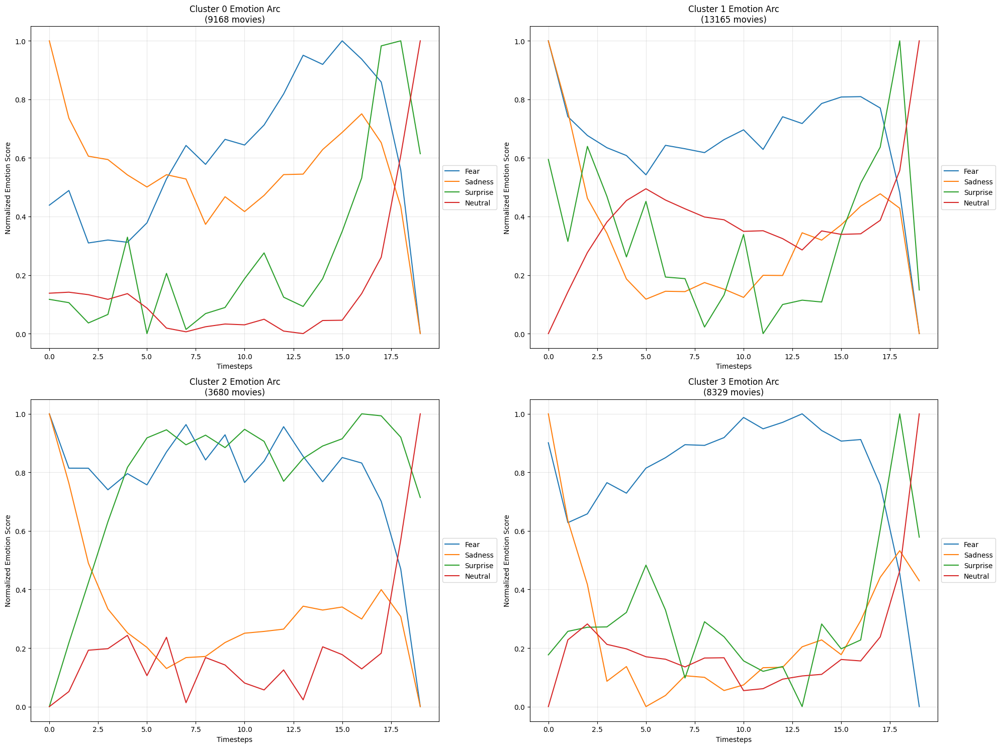


Cluster Characteristics:

Cluster 0 average emotions:
fear        0.064825
sadness     0.224817
surprise    0.025575
neutral     0.263636
dtype: float64

Cluster 1 average emotions:
fear        0.064530
sadness     0.088978
surprise    0.032892
neutral     0.429868
dtype: float64

Cluster 2 average emotions:
fear        0.087660
sadness     0.108799
surprise    0.117261
neutral     0.336207
dtype: float64

Cluster 3 average emotions:
fear        0.194250
sadness     0.099245
surprise    0.029165
neutral     0.268862
dtype: float64


In [8]:
import matplotlib.pyplot as plt
import pandas as pd

# Create the plot
fig, axes = plt.subplots(2, 2, figsize=(20, 15))
axes = axes.ravel()

# For each cluster
for cluster in range(n_clusters):
    # Get movies in this cluster
    cluster_movies = movies_by_cluster[cluster]
    
    # Filter the interpolated dataframe for only these movies
    cluster_data = df_emotions[df_emotions['Wikipedia_movie_ID'].isin(cluster_movies)]
    
    # Calculate average emotions over timesteps for this cluster
    avg_cluster_emotions = cluster_data.groupby('timestep')[emotion_columns].mean()
    
    # Normalize the emotions
    normalized_cluster_emotions = avg_cluster_emotions.apply(
        lambda x: (x - x.min()) / (x.max() - x.min()), 
        axis=0
    )
    
    # Plot for this cluster
    for emotion in emotion_columns:
        axes[cluster].plot(
            range(len(normalized_cluster_emotions)), 
            normalized_cluster_emotions[emotion], 
            label=emotion.capitalize()
        )
    
    axes[cluster].set_title(f'Cluster {cluster} Emotion Arc\n({len(cluster_movies)} movies)')
    axes[cluster].set_xlabel('Timesteps')
    axes[cluster].set_ylabel('Normalized Emotion Score')
    axes[cluster].legend(loc='center left', bbox_to_anchor=(1, 0.5))
    axes[cluster].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Print average emotion values for each cluster
print("\nCluster Characteristics:")
for cluster in range(n_clusters):
    print(f"\nCluster {cluster} average emotions:")
    cluster_movies = movies_by_cluster[cluster]
    cluster_data = df_emotions[df_emotions['Wikipedia_movie_ID'].isin(cluster_movies)]
    print(cluster_data[emotion_columns].mean())

## Xavier's clustering

In [19]:
DATA_PATH_per_emotion_cluster = "data/emotions_cluster_assignments.pkl"  

df_per_emotions_cluster = pd.read_pickle(DATA_PATH_per_emotion_cluster)
df_per_emotions_cluster = df_per_emotions_cluster.reset_index(names=['Wikipedia_movie_ID'])

df_metadata_clusters = df_metadata.merge(
    df_per_emotions_cluster[['Wikipedia_movie_ID', 'anger', 'disgust', 'fear', 'joy', 'neutral', 'sadness', 'surprise']], 
    on='Wikipedia_movie_ID', 
    how='left'
)
df_metadata_clusters.head(2)

,Wikipedia_movie_ID,summary,Freebase_movie_ID,Movie_name,Movie_release_date,Movie_box_office_revenue,Movie_runtime,Movie_languages,Movie_countries,Movie_genres,category,continent,Rating,anger,disgust,fear,joy,neutral,sadness,surprise
0,3333,The film follows two juxtaposed families: the...,/m/0151l,The Birth of a Nation,NaN,50000000.0,190.0,"Silent film, English Language",United States of America,"Silent film, Indie, Costume drama, Epic, Black...","[Action/Adventure, Drama]",North America,6.1,1.0,0.0,1.0,0.0,0.0,1.0,1.0
1,3746,"In Los Angeles, November 2019, retired police...",/m/017n9,Blade Runner,1982.0,33139618.0,116.0,"Japanese Language, Cantonese, English Language...","United States of America, Hong Kong","Thriller, Cyberpunk, Science Fiction, Future n...","[Drama, Fantasy/Sci-Fi, Thriller]",North America,8.1,4.0,1.0,1.0,0.0,0.0,0.0,1.0


### Per emotion cluster ratings


Analysis for ANGER


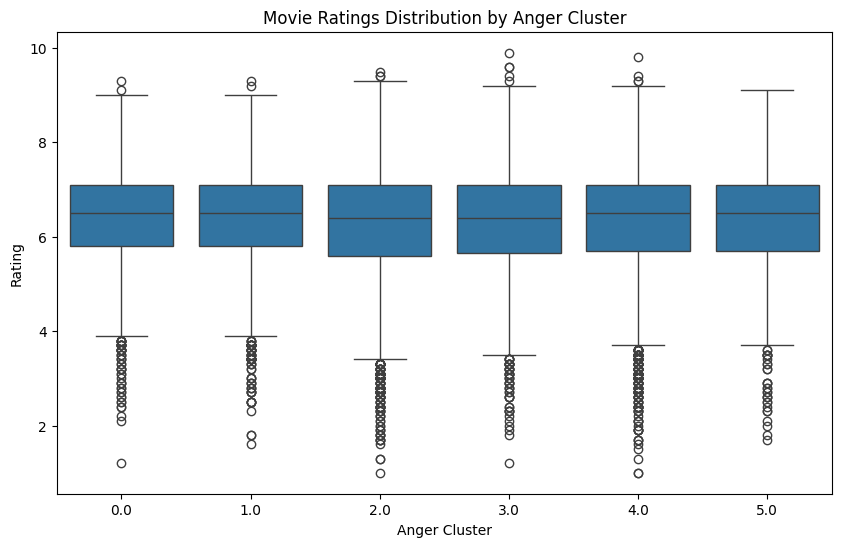


Count of movies in each cluster:
anger
0.0    1857
1.0    2512
2.0    7038
3.0    2845
4.0    8759
5.0    1463
Name: count, dtype: int64

Statistical Summary by Cluster:
        count      mean       std  min   25%  50%  75%  max
anger                                                      
0.0    1739.0  6.371535  1.107278  1.2  5.80  6.5  7.1  9.3
1.0    2355.0  6.348068  1.089316  1.6  5.80  6.5  7.1  9.3
2.0    6550.0  6.269053  1.147316  1.0  5.60  6.4  7.1  9.5
3.0    2619.0  6.295953  1.128910  1.2  5.65  6.4  7.1  9.9
4.0    8220.0  6.368710  1.113973  1.0  5.70  6.5  7.1  9.8
5.0    1376.0  6.332340  1.119114  1.7  5.70  6.5  7.1  9.1

One-way ANOVA results:
F-statistic: 6.8776
p-value: 0.0000

Kruskal-Wallis H-test:
Statistic: 36.8248
p-value: 0.0000




Analysis for DISGUST


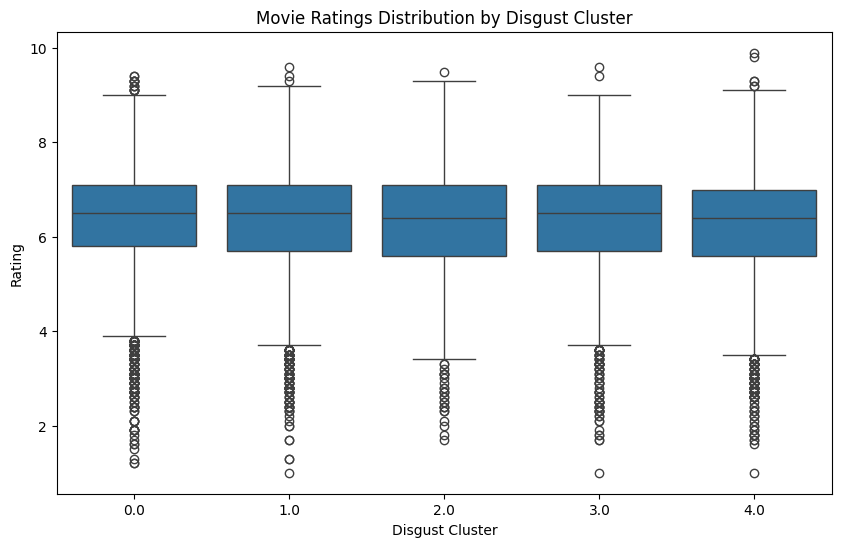


Count of movies in each cluster:
disgust
0.0    8972
1.0    5039
2.0    1571
3.0    2894
4.0    5998
Name: count, dtype: int64

Statistical Summary by Cluster:
          count      mean       std  min  25%  50%  75%  max
disgust                                                     
0.0      8360.0  6.370287  1.095414  1.2  5.8  6.5  7.1  9.4
1.0      4721.0  6.350117  1.138457  1.0  5.7  6.5  7.1  9.6
2.0      1454.0  6.268501  1.155643  1.7  5.6  6.4  7.1  9.5
3.0      2701.0  6.320844  1.140500  1.0  5.7  6.5  7.1  9.6
4.0      5623.0  6.264236  1.131699  1.0  5.6  6.4  7.0  9.9

One-way ANOVA results:
F-statistic: 9.0074
p-value: 0.0000

Kruskal-Wallis H-test:
Statistic: 34.7013
p-value: 0.0000




Analysis for FEAR


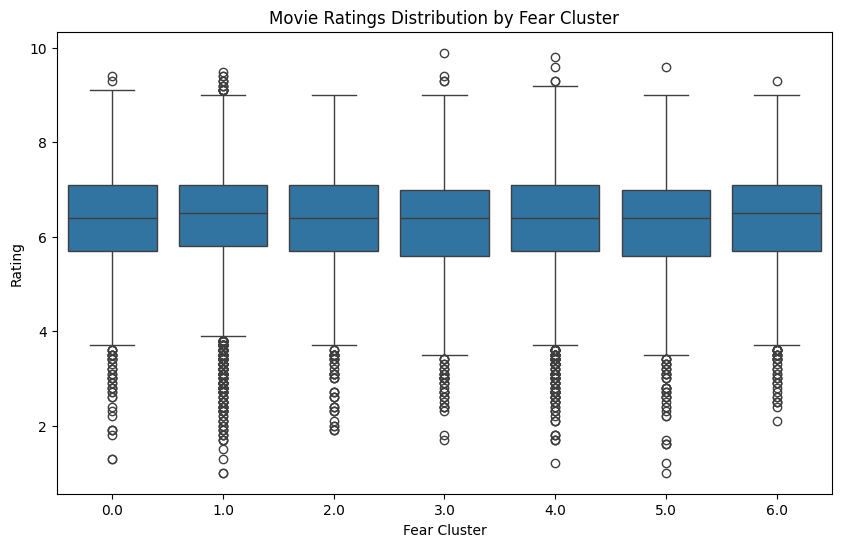


Count of movies in each cluster:
fear
0.0    1511
1.0    9348
2.0    1963
3.0    1902
4.0    6123
5.0    1766
6.0    1861
Name: count, dtype: int64

Statistical Summary by Cluster:
       count      mean       std  min  25%  50%  75%  max
fear                                                     
0.0   1418.0  6.309803  1.178565  1.3  5.7  6.4  7.1  9.4
1.0   8762.0  6.384478  1.105521  1.0  5.8  6.5  7.1  9.5
2.0   1817.0  6.303467  1.118760  1.9  5.7  6.4  7.1  9.0
3.0   1769.0  6.247824  1.150879  1.7  5.6  6.4  7.0  9.9
4.0   5710.0  6.314413  1.117455  1.2  5.7  6.4  7.1  9.8
5.0   1634.0  6.213158  1.176382  1.0  5.6  6.4  7.0  9.6
6.0   1749.0  6.314351  1.096862  2.1  5.7  6.5  7.1  9.3

One-way ANOVA results:
F-statistic: 8.4441
p-value: 0.0000

Kruskal-Wallis H-test:
Statistic: 46.0046
p-value: 0.0000




Analysis for JOY


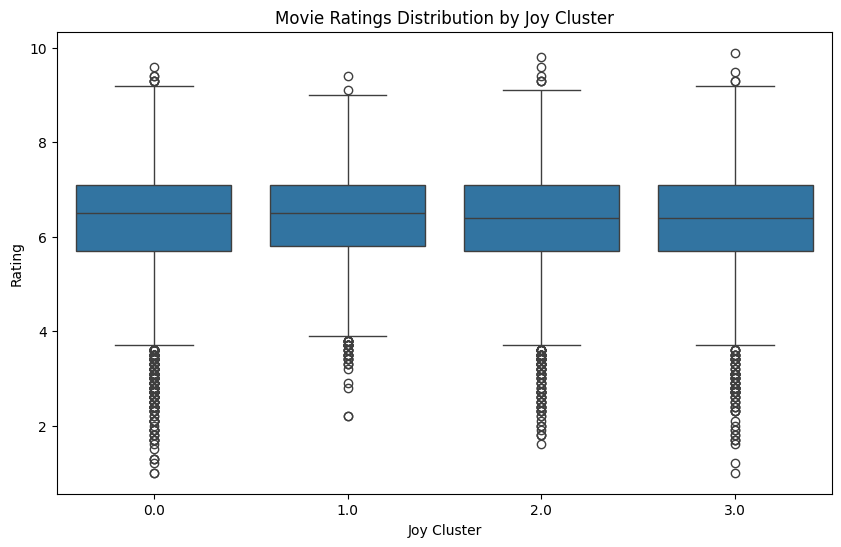


Count of movies in each cluster:
joy
0.0    14464
1.0     1297
2.0     5169
3.0     3544
Name: count, dtype: int64

Statistical Summary by Cluster:
       count      mean       std  min  25%  50%  75%  max
joy                                                      
0.0  13536.0  6.340418  1.115912  1.0  5.7  6.5  7.1  9.6
1.0   1214.0  6.363509  1.108185  2.2  5.8  6.5  7.1  9.4
2.0   4802.0  6.304894  1.122766  1.6  5.7  6.4  7.1  9.8
3.0   3307.0  6.295736  1.158880  1.0  5.7  6.4  7.1  9.9

One-way ANOVA results:
F-statistic: 2.5422
p-value: 0.0544

Kruskal-Wallis H-test:
Statistic: 6.3788
p-value: 0.0946




Analysis for SADNESS


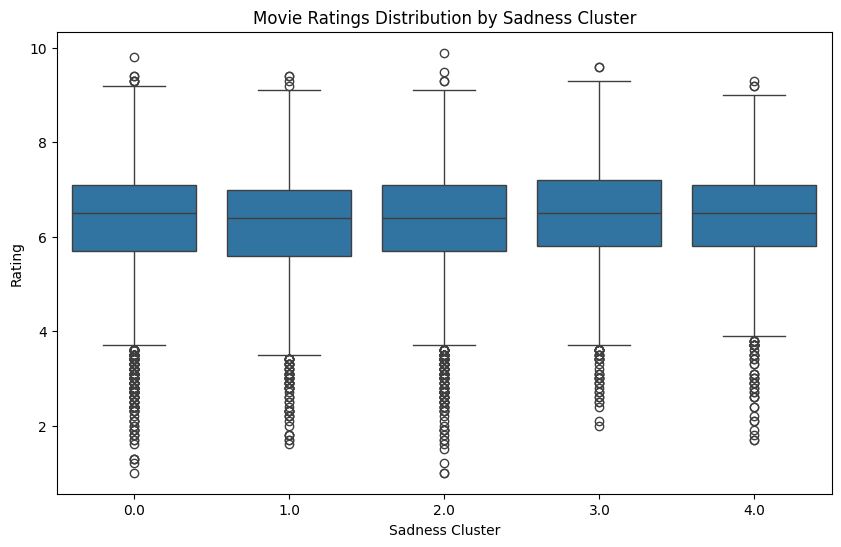


Count of movies in each cluster:
sadness
0.0    11611
1.0     3596
2.0     5317
3.0     2327
4.0     1623
Name: count, dtype: int64

Statistical Summary by Cluster:
           count      mean       std  min  25%  50%  75%  max
sadness                                                      
0.0      10872.0  6.348032  1.110737  1.0  5.7  6.5  7.1  9.8
1.0       3357.0  6.236908  1.130438  1.6  5.6  6.4  7.0  9.4
2.0       4949.0  6.299192  1.155158  1.0  5.7  6.4  7.1  9.9
3.0       2162.0  6.410315  1.086457  2.0  5.8  6.5  7.2  9.6
4.0       1519.0  6.358394  1.130395  1.7  5.8  6.5  7.1  9.3

One-way ANOVA results:
F-statistic: 10.3929
p-value: 0.0000

Kruskal-Wallis H-test:
Statistic: 39.2172
p-value: 0.0000




Analysis for SURPRISE


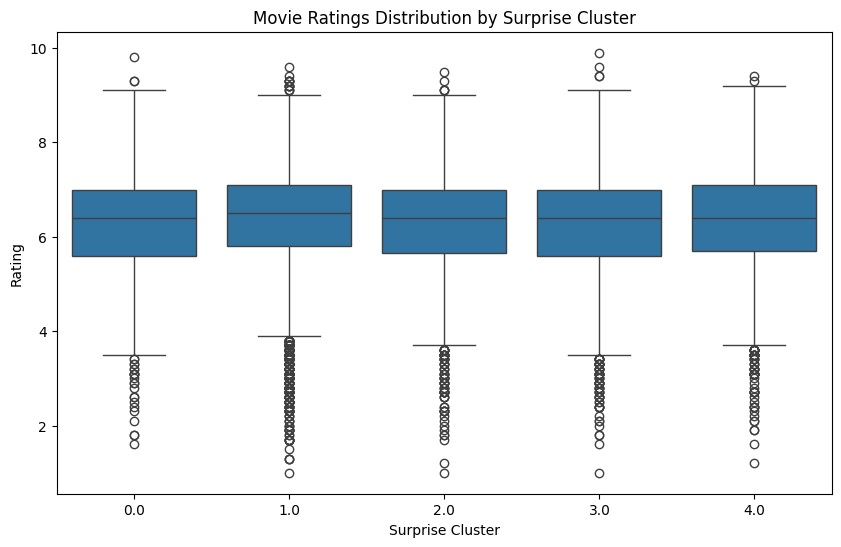


Count of movies in each cluster:
surprise
0.0     1532
1.0    13789
2.0     3233
3.0     2656
4.0     3264
Name: count, dtype: int64

Statistical Summary by Cluster:
            count      mean       std  min   25%  50%  75%  max
surprise                                                       
0.0        1407.0  6.282232  1.138126  1.6  5.60  6.4  7.0  9.8
1.0       12924.0  6.369266  1.119552  1.0  5.80  6.5  7.1  9.6
2.0        2987.0  6.266789  1.125094  1.0  5.65  6.4  7.0  9.5
3.0        2481.0  6.215115  1.154752  1.0  5.60  6.4  7.0  9.9
4.0        3060.0  6.323922  1.095706  1.2  5.70  6.4  7.1  9.4

One-way ANOVA results:
F-statistic: 13.4631
p-value: 0.0000

Kruskal-Wallis H-test:
Statistic: 60.4358
p-value: 0.0000





In [31]:
# List of all emotions
emotions = ['anger', 'disgust', 'fear', 'joy', 'sadness', 'surprise']

# Loop through each emotion
for emotion in emotions:
    print(f"\n{'='*50}")
    print(f"Analysis for {emotion.upper()}")
    print(f"{'='*50}")
    
    # 1. Create focused dataset
    emotion_rating_data = df_metadata_clusters[['Wikipedia_movie_ID', emotion, 'Rating']]
    
    # 2. Statistical summary
    cluster_stats = emotion_rating_data.groupby(emotion)['Rating'].describe()
    
    # 3. Collect ratings for each cluster
    cluster_groups = [group['Rating'].dropna().values 
                     for name, group in emotion_rating_data.groupby(emotion)]
    
    # 4. Perform ANOVA
    f_statistic, p_value = stats.f_oneway(*cluster_groups)
    
    # 5. Create boxplot
    plt.figure(figsize=(10, 6))
    sns.boxplot(data=emotion_rating_data, x=emotion, y='Rating')
    plt.title(f'Movie Ratings Distribution by {emotion.capitalize()} Cluster')
    plt.xlabel(f'{emotion.capitalize()} Cluster')
    plt.ylabel('Rating')
    plt.show()
    
    # 6. Print results
    print("\nCount of movies in each cluster:")
    print(emotion_rating_data[emotion].value_counts().sort_index())
    
    print("\nStatistical Summary by Cluster:")
    print(cluster_stats)
    
    print(f"\nOne-way ANOVA results:")
    print(f"F-statistic: {f_statistic:.4f}")
    print(f"p-value: {p_value:.4f}")
    
    # 8. Kruskal-Wallis test
    statistic, pvalue = stats.kruskal(*cluster_groups)
    print(f"\nKruskal-Wallis H-test:")
    print(f"Statistic: {statistic:.4f}")
    print(f"p-value: {pvalue:.4f}")
    
    # Optional: add some visual separation between emotions
    print("\n\n")

### Explode categories, and for each per emotion cluster, divide for each category

In [ ]:
# First, explode the dataset by category
df_exploded = df_metadata_clusters.explode('category')

# List of all emotions
emotions = ['anger', 'disgust', 'fear', 'joy', 'sadness', 'surprise']

# Get unique categories
categories = df_exploded['category'].unique()

# Loop through each emotion
for emotion in emotions:
    print(f"\n{'='*70}")
    print(f"Analysis for {emotion.upper()}")
    print(f"{'='*70}")
    
    # Loop through each category
    for category in categories:
        print(f"\n{'-'*50}")
        print(f"Category: {category}")
        print(f"{'-'*50}")
        
        # Filter data for this category
        category_data = df_exploded[df_exploded['category'] == category]
        emotion_rating_data = category_data[['Wikipedia_movie_ID', emotion, 'Rating']]
        
        # Statistical summary
        cluster_stats = emotion_rating_data.groupby(emotion)['Rating'].describe()
        
        # Collect ratings for each cluster
        cluster_groups = [group['Rating'].dropna().values 
                         for name, group in emotion_rating_data.groupby(emotion)]
        
        # Print number of clusters
        n_clusters = len(cluster_groups)
        print(f"\nNumber of movies in this category: {len(emotion_rating_data)}")
        print(f"Number of clusters found: {n_clusters}")
        
        # Only perform statistical tests if there are at least 2 clusters with data
        if n_clusters >= 2 and all(len(group) > 0 for group in cluster_groups):
            try:
                # ANOVA
                f_statistic, p_value = stats.f_oneway(*cluster_groups)
                
                # Kruskal-Wallis
                statistic, pvalue = stats.kruskal(*cluster_groups)
                
                
                # Create boxplot
                plt.figure(figsize=(10, 6))
                sns.boxplot(data=emotion_rating_data, x=emotion, y='Rating')
                plt.title(f'{emotion.capitalize()} Clusters Rating Distribution\nCategory: {category}')
                plt.xlabel(f'{emotion.capitalize()} Cluster')
                plt.ylabel('Rating')
                plt.show()
                
                # Print results
                print("\nCount of movies in each cluster:")
                print(emotion_rating_data[emotion].value_counts().sort_index())
                
                print("\nStatistical Summary by Cluster:")
                print(cluster_stats)
                
                print(f"\nOne-way ANOVA results:")
                print(f"F-statistic: {f_statistic:.4f}")
                print(f"p-value: {p_value:.4f}")
                
                
                print(f"\nKruskal-Wallis H-test:")
                print(f"Statistic: {statistic:.4f}")
                print(f"p-value: {pvalue:.4f}")
                
            except Exception as e:
                print(f"\nWarning: Could not perform some statistical tests: {str(e)}")
        else:
            print("\nNot enough data in different clusters for statistical analysis")
            
            # Still show the distribution
            plt.figure(figsize=(10, 6))
            sns.boxplot(data=emotion_rating_data, x=emotion, y='Rating')
            plt.title(f'{emotion.capitalize()} Clusters Rating Distribution\nCategory: {category}')
            plt.xlabel(f'{emotion.capitalize()} Cluster')
            plt.ylabel('Rating')
            plt.show()
            
            print("\nCount of movies in each cluster:")
            print(emotion_rating_data[emotion].value_counts().sort_index())
            
            print("\nStatistical Summary by Cluster:")
            print(cluster_stats)
        
        print("\n")  # Add separation between categories

    print("\n")  # Add separation between emotions

### Same analysis, but better plots


Analysis for ANGER


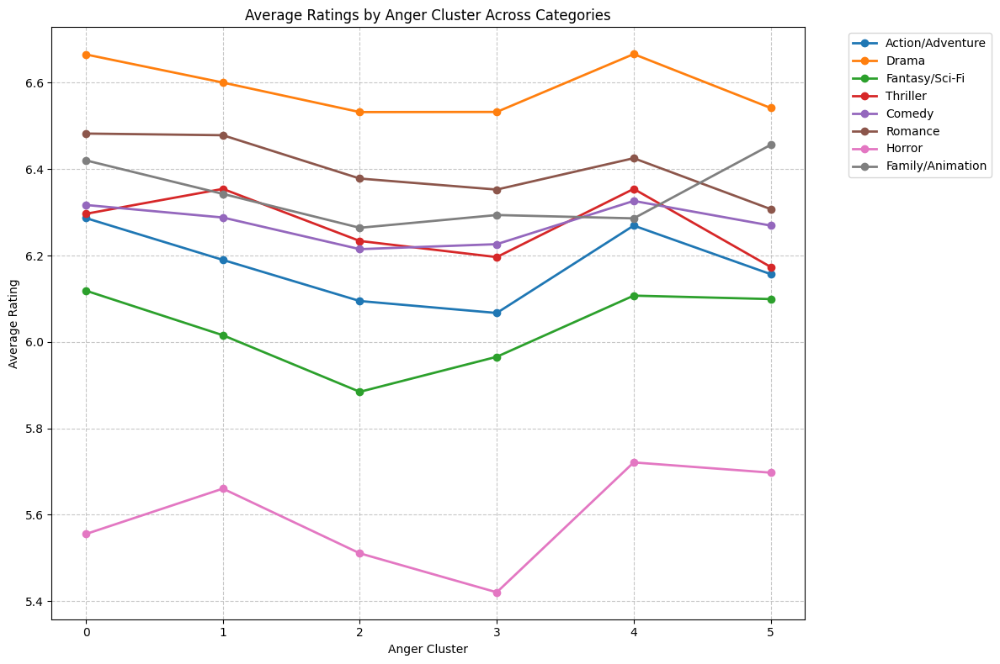


Statistical Summaries by Category and Cluster:

Category: Action/Adventure
       count  mean   std
anger                   
0.0      495  6.29  1.06
1.0      702  6.19  1.12
2.0     1659  6.09  1.17
3.0      621  6.07  1.18
4.0     2126  6.27  1.10
5.0      337  6.16  1.14

Category: Drama
       count  mean   std
anger                   
0.0      895  6.67  0.95
1.0     1220  6.60  0.97
2.0     3516  6.53  1.04
3.0     1451  6.53  1.03
4.0     4168  6.67  1.00
5.0      768  6.54  1.00

Category: Fantasy/Sci-Fi
       count  mean   std
anger                   
0.0      236  6.12  1.20
1.0      341  6.02  1.29
2.0      763  5.88  1.34
3.0      253  5.97  1.22
4.0     1298  6.11  1.20
5.0      130  6.10  1.40

Category: Thriller
       count  mean   std
anger                   
0.0      493  6.30  1.06
1.0      653  6.35  1.09
2.0     1703  6.23  1.10
3.0      574  6.20  1.13
4.0     2308  6.35  1.07
5.0      334  6.17  1.15

Category: Comedy
       count  mean   std
anger             

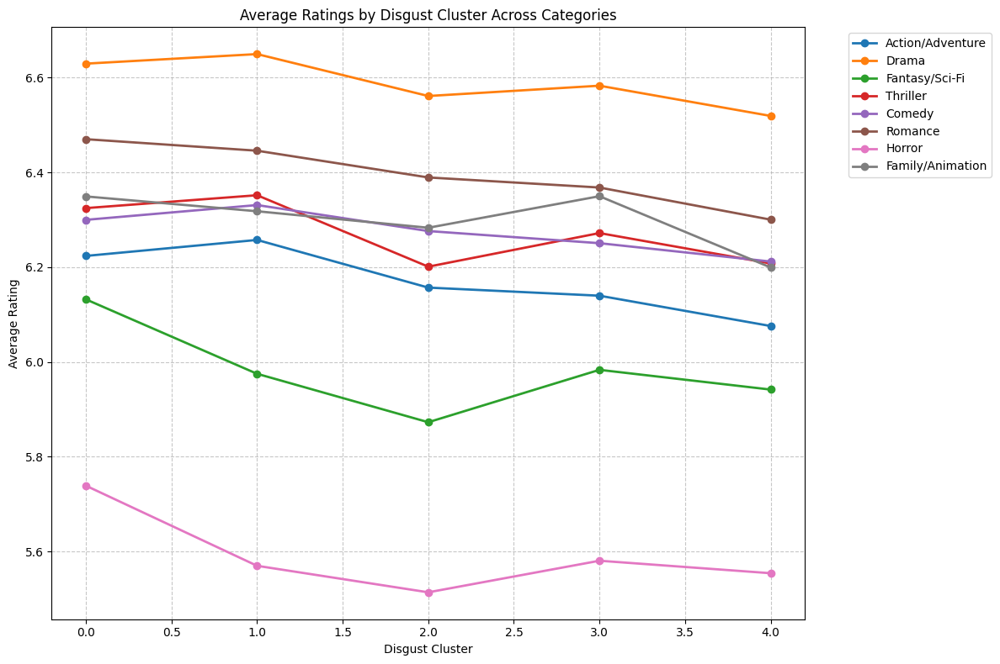


Statistical Summaries by Category and Cluster:

Category: Action/Adventure
         count  mean   std
disgust                   
0.0       2449  6.22  1.12
1.0       1233  6.26  1.14
2.0        304  6.16  1.12
3.0        593  6.14  1.16
4.0       1361  6.08  1.13

Category: Drama
         count  mean   std
disgust                   
0.0       4287  6.63  0.99
1.0       2483  6.65  1.01
2.0        772  6.56  1.02
3.0       1471  6.58  1.01
4.0       3005  6.52  1.03

Category: Fantasy/Sci-Fi
         count  mean   std
disgust                   
0.0       1266  6.13  1.19
1.0        655  5.97  1.29
2.0        169  5.87  1.44
3.0        324  5.98  1.35
4.0        607  5.94  1.26

Category: Thriller
         count  mean   std
disgust                   
0.0       2332  6.32  1.08
1.0       1319  6.35  1.07
2.0        373  6.20  1.11
3.0        675  6.27  1.14
4.0       1366  6.21  1.11

Category: Comedy
         count  mean   std
disgust                   
0.0       2799  6.30  1.05
1.0   

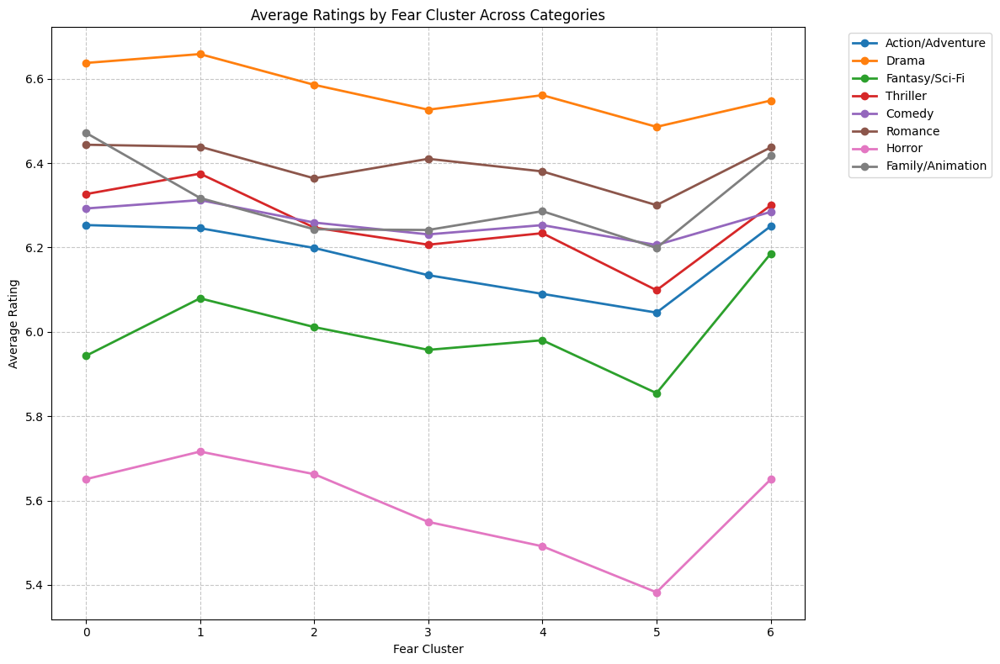


Statistical Summaries by Category and Cluster:

Category: Action/Adventure
      count  mean   std
fear                   
0.0     405  6.25  1.14
1.0    2305  6.25  1.12
2.0     523  6.20  1.17
3.0     455  6.13  1.14
4.0    1347  6.09  1.12
5.0     402  6.05  1.24
6.0     503  6.25  1.08

Category: Drama
      count  mean   std
fear                   
0.0     702  6.64  1.05
1.0    4614  6.66  0.98
2.0     961  6.59  1.03
3.0     927  6.53  1.06
4.0    3111  6.56  1.00
5.0     841  6.49  1.07
6.0     862  6.55  1.00

Category: Fantasy/Sci-Fi
      count  mean   std
fear                   
0.0     223  5.94  1.34
1.0    1291  6.08  1.23
2.0     239  6.01  1.27
3.0     215  5.96  1.32
4.0     606  5.98  1.26
5.0     198  5.85  1.29
6.0     249  6.19  1.23

Category: Thriller
      count  mean   std
fear                   
0.0     472  6.33  1.09
1.0    2253  6.37  1.06
2.0     568  6.25  1.08
3.0     503  6.21  1.09
4.0    1338  6.23  1.12
5.0     355  6.10  1.22
6.0     576  6.30  1.

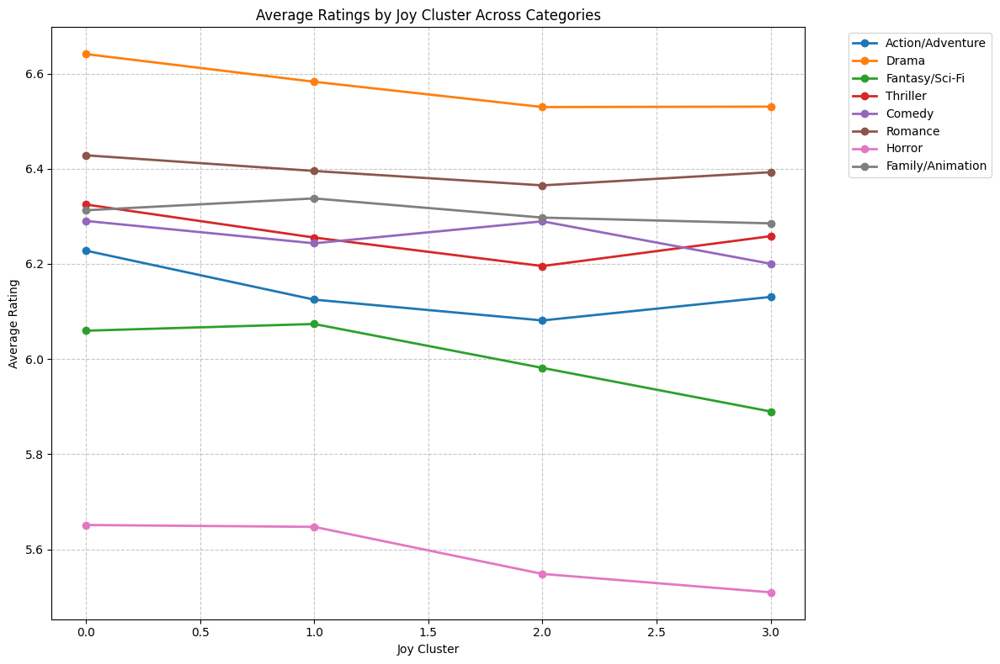


Statistical Summaries by Category and Cluster:

Category: Action/Adventure
     count  mean   std
joy                   
0.0   3897  6.23  1.13
1.0    225  6.12  1.11
2.0   1098  6.08  1.13
3.0    720  6.13  1.12

Category: Drama
     count  mean   std
joy                   
0.0   6818  6.64  0.99
1.0    710  6.58  0.98
2.0   2539  6.53  1.04
3.0   1951  6.53  1.05

Category: Fantasy/Sci-Fi
     count  mean   std
joy                   
0.0   2095  6.06  1.24
1.0     95  6.07  1.21
2.0    527  5.98  1.31
3.0    304  5.89  1.34

Category: Thriller
     count  mean   std
joy                   
0.0   3967  6.32  1.08
1.0    213  6.26  1.12
2.0   1049  6.20  1.12
3.0    836  6.26  1.11

Category: Comedy
     count  mean   std
joy                   
0.0   4397  6.29  1.06
1.0    416  6.24  1.07
2.0   1791  6.29  1.05
3.0    910  6.20  1.10

Category: Romance
     count  mean   std
joy                   
0.0   2693  6.43  0.99
1.0    362  6.40  1.02
2.0   1061  6.37  1.00
3.0    766  6.39  1

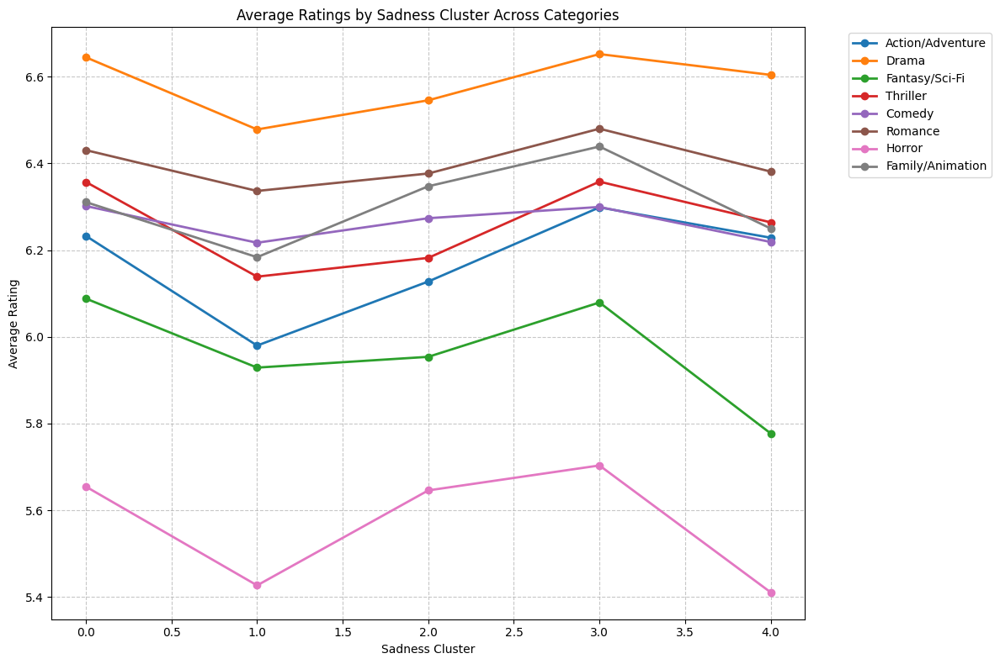


Statistical Summaries by Category and Cluster:

Category: Action/Adventure
         count  mean   std
sadness                   
0.0       3137  6.23  1.12
1.0        723  5.98  1.15
2.0       1253  6.13  1.16
3.0        495  6.30  1.10
4.0        332  6.23  1.11

Category: Drama
         count  mean   std
sadness                   
0.0       5421  6.64  0.98
1.0       1754  6.48  1.03
2.0       2658  6.55  1.06
3.0       1258  6.65  0.98
4.0        927  6.60  0.98

Category: Fantasy/Sci-Fi
         count  mean   std
sadness                   
0.0       1717  6.09  1.23
1.0        354  5.93  1.28
2.0        595  5.95  1.30
3.0        227  6.08  1.25
4.0        128  5.78  1.45

Category: Thriller
         count  mean   std
sadness                   
0.0       3281  6.36  1.05
1.0        788  6.14  1.08
2.0       1158  6.18  1.18
3.0        537  6.36  1.08
4.0        301  6.26  1.17

Category: Comedy
         count  mean   std
sadness                   
0.0       3544  6.30  1.06
1.0   

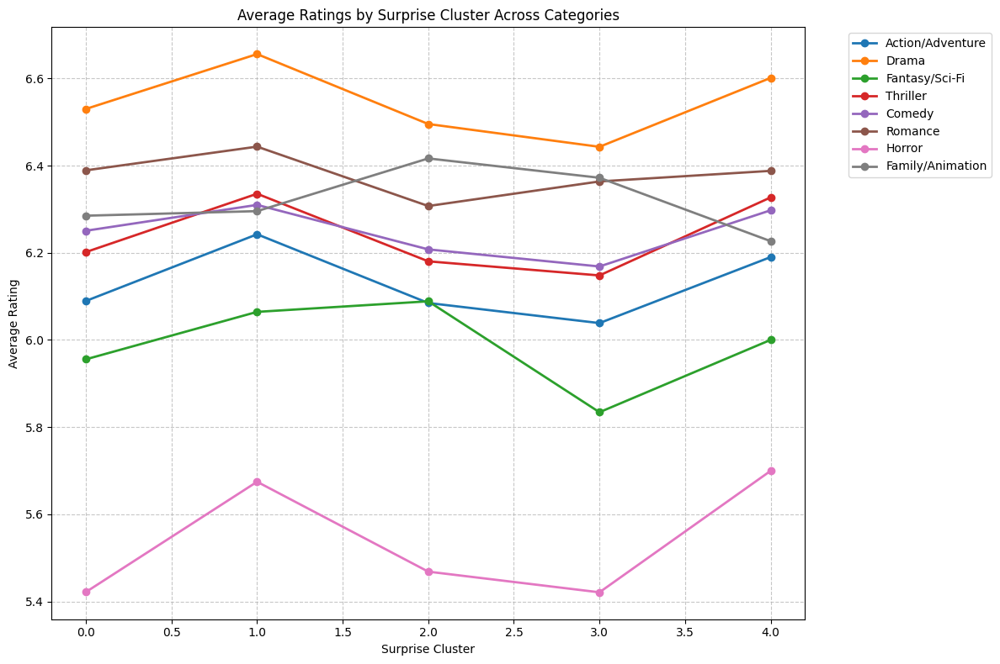


Statistical Summaries by Category and Cluster:

Category: Action/Adventure
          count  mean   std
surprise                   
0.0         365  6.09  1.13
1.0        3404  6.24  1.13
2.0         767  6.08  1.11
3.0         601  6.04  1.20
4.0         803  6.19  1.10

Category: Drama
          count  mean   std
surprise                   
0.0         717  6.53  1.04
1.0        6764  6.66  0.99
2.0        1584  6.50  1.03
3.0        1354  6.44  1.06
4.0        1599  6.60  1.00

Category: Fantasy/Sci-Fi
          count  mean   std
surprise                   
0.0         167  5.96  1.26
1.0        1783  6.06  1.27
2.0         329  6.09  1.22
3.0         292  5.83  1.36
4.0         450  6.00  1.20

Category: Thriller
          count  mean   std
surprise                   
0.0         344  6.20  1.14
1.0        3620  6.34  1.07
2.0         738  6.18  1.12
3.0         555  6.15  1.14
4.0         808  6.33  1.08

Category: Comedy
          count  mean   std
surprise                   
0.0

In [29]:
# First, explode the dataset by category
df_exploded = df_metadata_clusters.explode('category')

# List of all emotions
emotions = ['anger', 'disgust', 'fear', 'joy', 'sadness', 'surprise']

# Get unique categories
categories = df_exploded['category'].unique()

# Loop through each emotion
for emotion in emotions:
    print(f"\n{'='*70}")
    print(f"Analysis for {emotion.upper()}")
    print(f"{'='*70}")
    
    # Create a figure for this emotion
    plt.figure(figsize=(12, 8))
    
    # Plot a line for each category
    for category in categories:
        # Filter data for this category
        category_data = df_exploded[df_exploded['category'] == category]
        emotion_rating_data = category_data[['Wikipedia_movie_ID', emotion, 'Rating']]
        
        # Calculate mean rating per cluster for this category
        mean_ratings = emotion_rating_data.groupby(emotion)['Rating'].mean()
        
        # Plot the line for this category
        plt.plot(mean_ratings.index, mean_ratings.values, marker='o', label=category, linewidth=2)
    
    plt.title(f'Average Ratings by {emotion.capitalize()} Cluster Across Categories')
    plt.xlabel(f'{emotion.capitalize()} Cluster')
    plt.ylabel('Average Rating')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()
    
    # Print statistical summaries
    print("\nStatistical Summaries by Category and Cluster:")
    for category in categories:
        print(f"\nCategory: {category}")
        category_data = df_exploded[df_exploded['category'] == category]
        emotion_rating_data = category_data[['Wikipedia_movie_ID', emotion, 'Rating']]
        
        # Statistical summary
        cluster_stats = emotion_rating_data.groupby(emotion)['Rating'].agg(['count', 'mean', 'std']).round(2)
        print(cluster_stats)

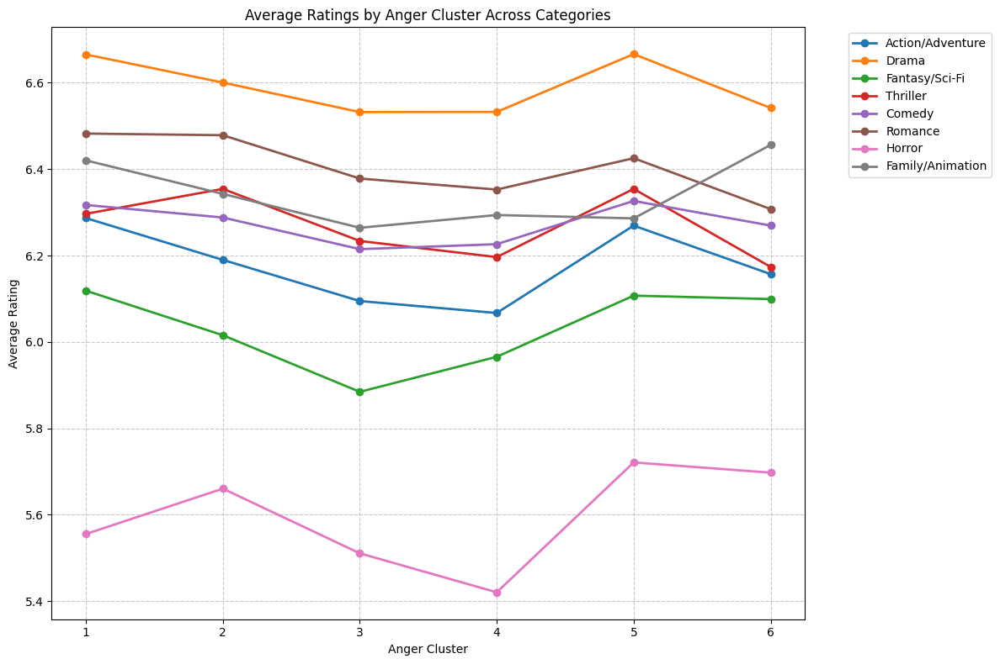

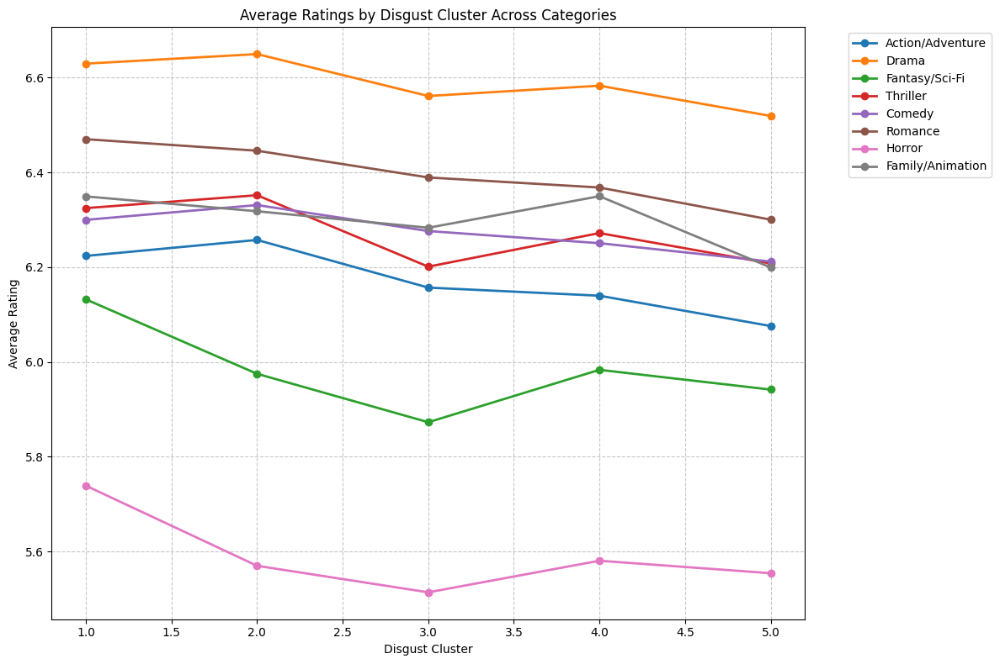

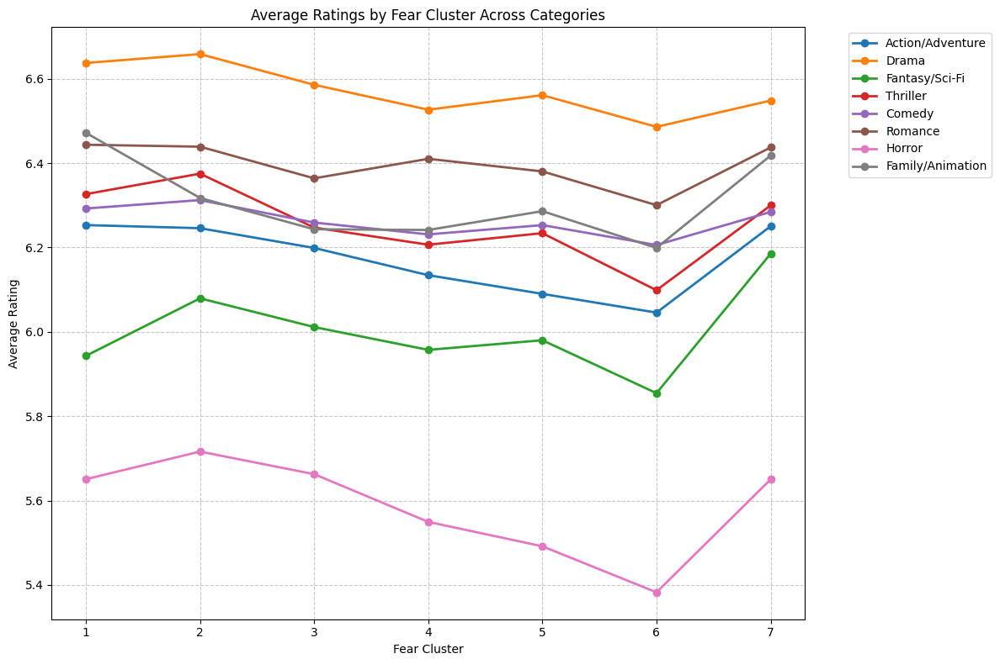

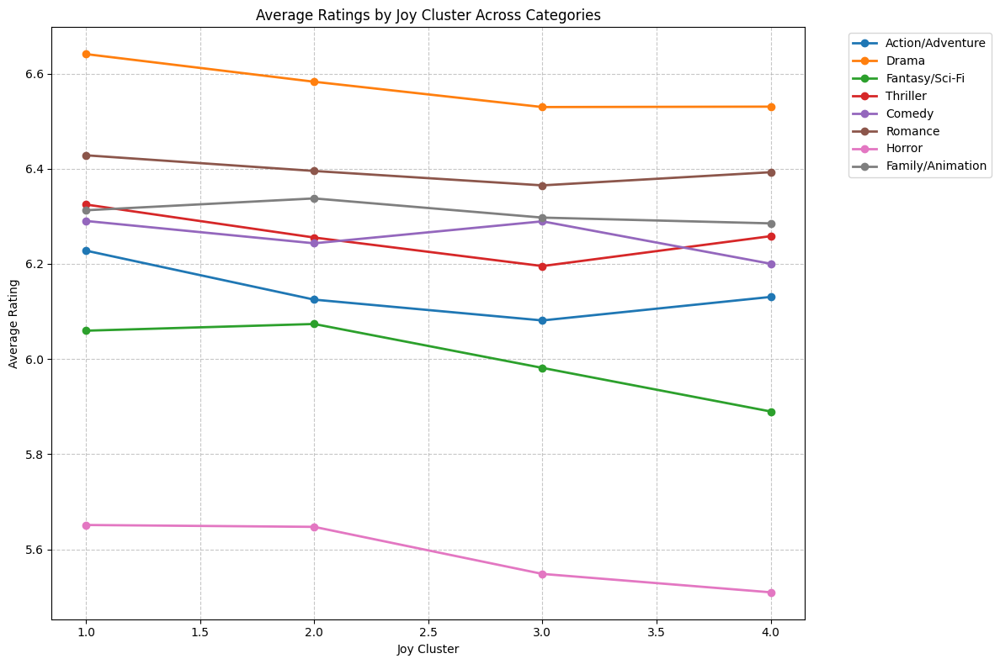

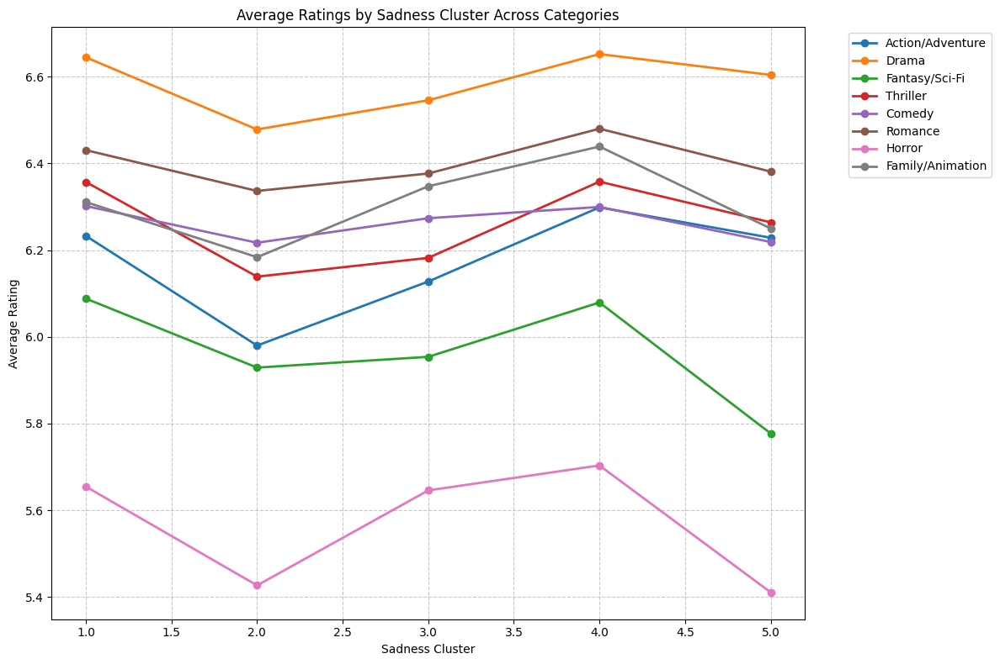

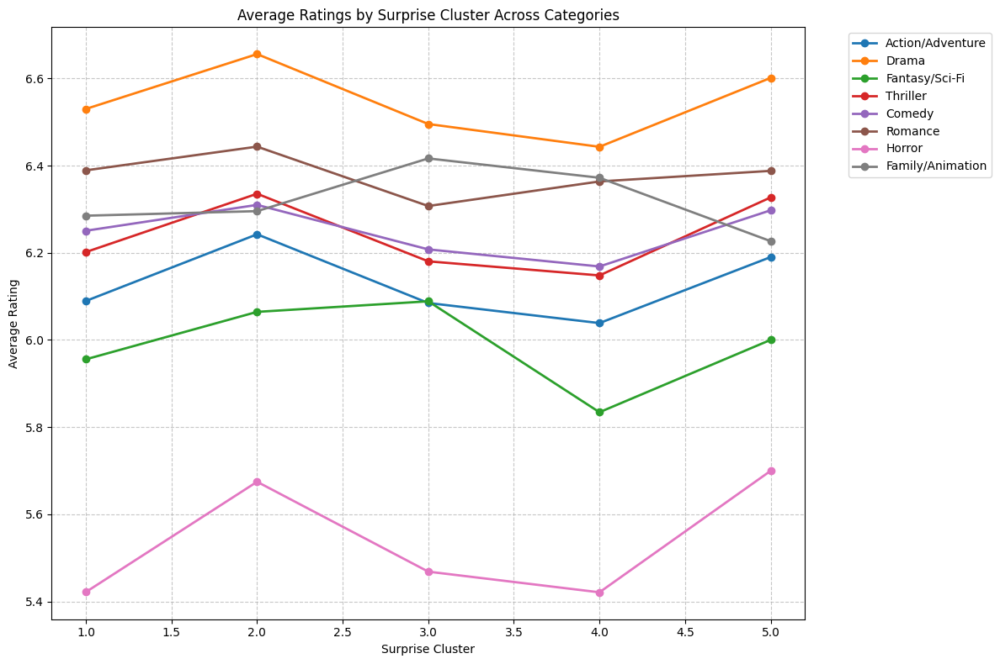


Summary for Action/Adventure:

Anger:
Best performing cluster: 1 (Rating: 6.29)
Worst performing cluster: 4 (Rating: 6.07)

Disgust:
Best performing cluster: 2 (Rating: 6.26)
Worst performing cluster: 5 (Rating: 6.08)

Fear:
Best performing cluster: 1 (Rating: 6.25)
Worst performing cluster: 6 (Rating: 6.05)

Joy:
Best performing cluster: 1 (Rating: 6.23)
Worst performing cluster: 3 (Rating: 6.08)

Sadness:
Best performing cluster: 4 (Rating: 6.30)
Worst performing cluster: 2 (Rating: 5.98)

Surprise:
Best performing cluster: 2 (Rating: 6.24)
Worst performing cluster: 4 (Rating: 6.04)


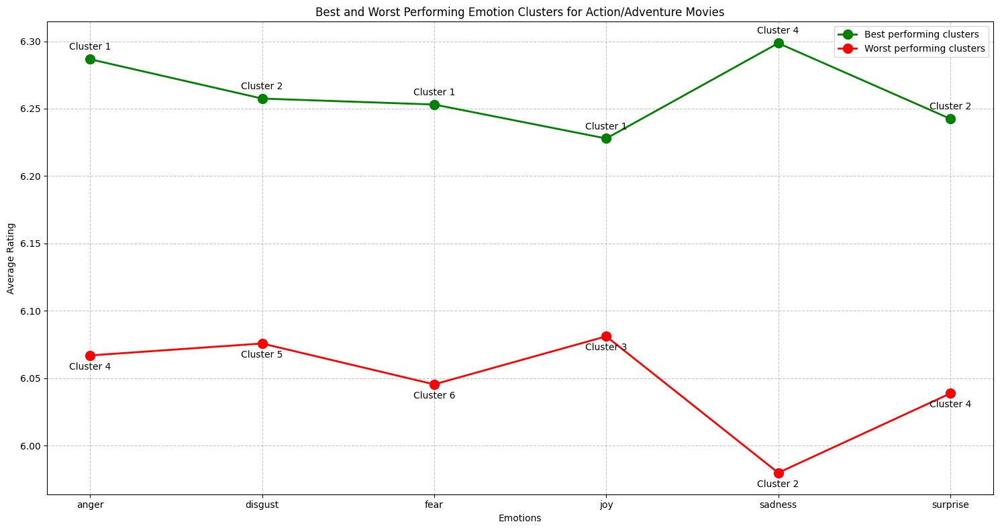


Summary for Drama:

Anger:
Best performing cluster: 5 (Rating: 6.67)
Worst performing cluster: 3 (Rating: 6.53)

Disgust:
Best performing cluster: 2 (Rating: 6.65)
Worst performing cluster: 5 (Rating: 6.52)

Fear:
Best performing cluster: 2 (Rating: 6.66)
Worst performing cluster: 6 (Rating: 6.49)

Joy:
Best performing cluster: 1 (Rating: 6.64)
Worst performing cluster: 3 (Rating: 6.53)

Sadness:
Best performing cluster: 4 (Rating: 6.65)
Worst performing cluster: 2 (Rating: 6.48)

Surprise:
Best performing cluster: 2 (Rating: 6.66)
Worst performing cluster: 4 (Rating: 6.44)


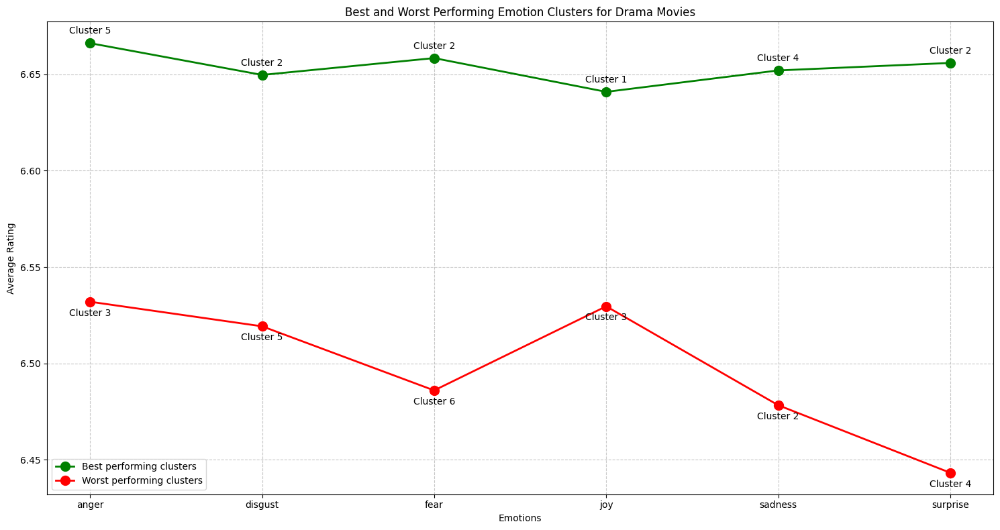


Summary for Fantasy/Sci-Fi:

Anger:
Best performing cluster: 1 (Rating: 6.12)
Worst performing cluster: 3 (Rating: 5.88)

Disgust:
Best performing cluster: 1 (Rating: 6.13)
Worst performing cluster: 3 (Rating: 5.87)

Fear:
Best performing cluster: 7 (Rating: 6.19)
Worst performing cluster: 6 (Rating: 5.85)

Joy:
Best performing cluster: 2 (Rating: 6.07)
Worst performing cluster: 4 (Rating: 5.89)

Sadness:
Best performing cluster: 1 (Rating: 6.09)
Worst performing cluster: 5 (Rating: 5.78)

Surprise:
Best performing cluster: 3 (Rating: 6.09)
Worst performing cluster: 4 (Rating: 5.83)


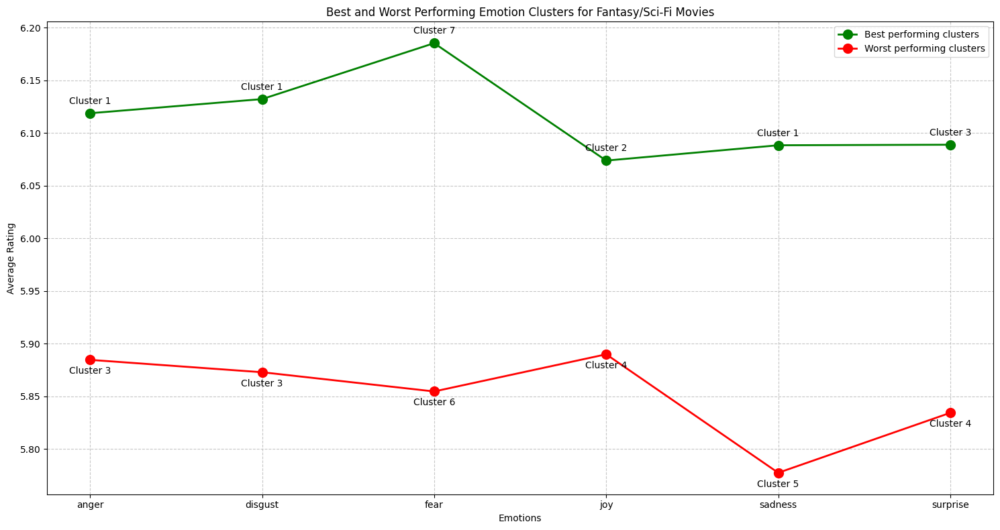


Summary for Thriller:

Anger:
Best performing cluster: 2 (Rating: 6.35)
Worst performing cluster: 6 (Rating: 6.17)

Disgust:
Best performing cluster: 2 (Rating: 6.35)
Worst performing cluster: 3 (Rating: 6.20)

Fear:
Best performing cluster: 2 (Rating: 6.37)
Worst performing cluster: 6 (Rating: 6.10)

Joy:
Best performing cluster: 1 (Rating: 6.32)
Worst performing cluster: 3 (Rating: 6.20)

Sadness:
Best performing cluster: 4 (Rating: 6.36)
Worst performing cluster: 2 (Rating: 6.14)

Surprise:
Best performing cluster: 2 (Rating: 6.34)
Worst performing cluster: 4 (Rating: 6.15)


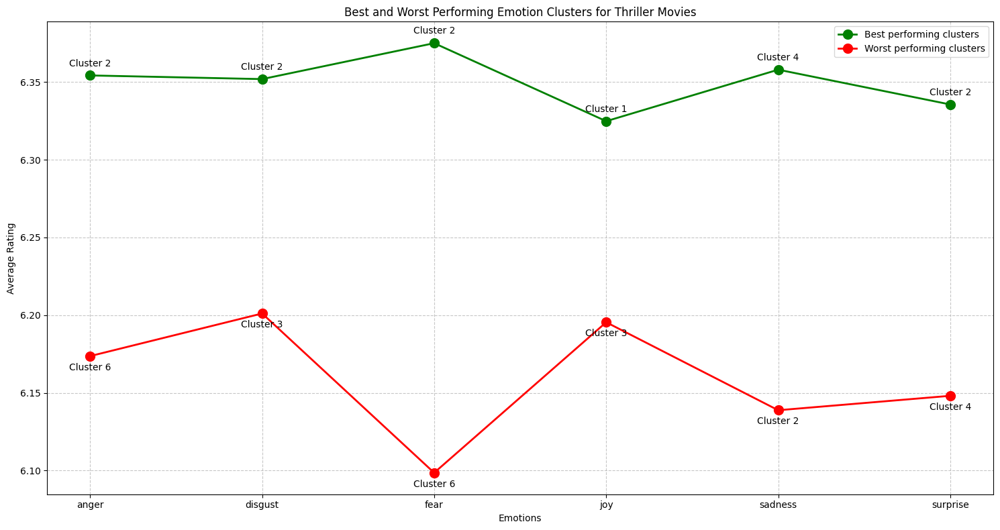


Summary for Comedy:

Anger:
Best performing cluster: 5 (Rating: 6.33)
Worst performing cluster: 3 (Rating: 6.21)

Disgust:
Best performing cluster: 2 (Rating: 6.33)
Worst performing cluster: 5 (Rating: 6.21)

Fear:
Best performing cluster: 2 (Rating: 6.31)
Worst performing cluster: 6 (Rating: 6.21)

Joy:
Best performing cluster: 1 (Rating: 6.29)
Worst performing cluster: 4 (Rating: 6.20)

Sadness:
Best performing cluster: 1 (Rating: 6.30)
Worst performing cluster: 2 (Rating: 6.22)

Surprise:
Best performing cluster: 2 (Rating: 6.31)
Worst performing cluster: 4 (Rating: 6.17)


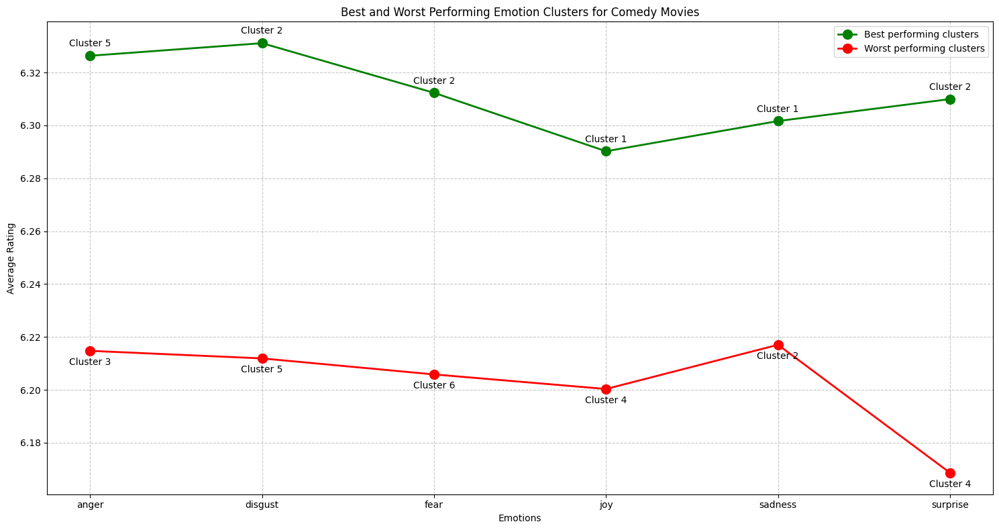


Summary for Romance:

Anger:
Best performing cluster: 1 (Rating: 6.48)
Worst performing cluster: 6 (Rating: 6.31)

Disgust:
Best performing cluster: 1 (Rating: 6.47)
Worst performing cluster: 5 (Rating: 6.30)

Fear:
Best performing cluster: 1 (Rating: 6.44)
Worst performing cluster: 6 (Rating: 6.30)

Joy:
Best performing cluster: 1 (Rating: 6.43)
Worst performing cluster: 3 (Rating: 6.37)

Sadness:
Best performing cluster: 4 (Rating: 6.48)
Worst performing cluster: 2 (Rating: 6.34)

Surprise:
Best performing cluster: 2 (Rating: 6.44)
Worst performing cluster: 3 (Rating: 6.31)


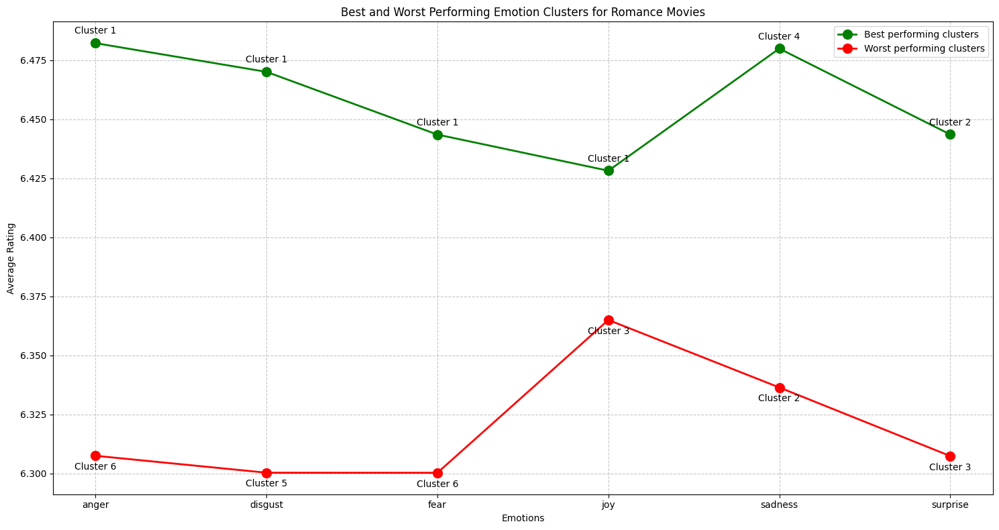


Summary for Horror:

Anger:
Best performing cluster: 5 (Rating: 5.72)
Worst performing cluster: 4 (Rating: 5.42)

Disgust:
Best performing cluster: 1 (Rating: 5.74)
Worst performing cluster: 3 (Rating: 5.51)

Fear:
Best performing cluster: 2 (Rating: 5.72)
Worst performing cluster: 6 (Rating: 5.38)

Joy:
Best performing cluster: 1 (Rating: 5.65)
Worst performing cluster: 4 (Rating: 5.51)

Sadness:
Best performing cluster: 4 (Rating: 5.70)
Worst performing cluster: 5 (Rating: 5.41)

Surprise:
Best performing cluster: 5 (Rating: 5.70)
Worst performing cluster: 4 (Rating: 5.42)


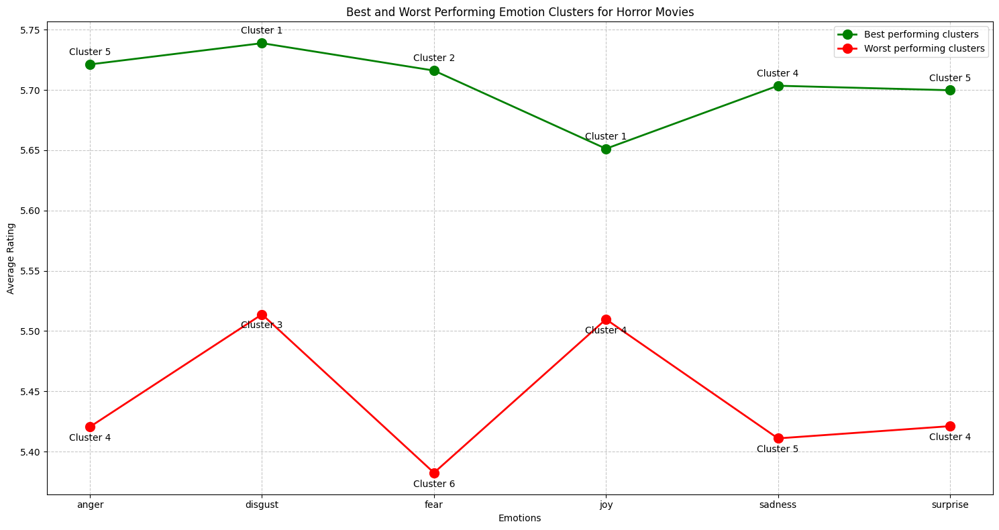


Summary for Family/Animation:

Anger:
Best performing cluster: 6 (Rating: 6.46)
Worst performing cluster: 3 (Rating: 6.26)

Disgust:
Best performing cluster: 4 (Rating: 6.35)
Worst performing cluster: 5 (Rating: 6.20)

Fear:
Best performing cluster: 1 (Rating: 6.47)
Worst performing cluster: 6 (Rating: 6.20)

Joy:
Best performing cluster: 2 (Rating: 6.34)
Worst performing cluster: 4 (Rating: 6.29)

Sadness:
Best performing cluster: 4 (Rating: 6.44)
Worst performing cluster: 2 (Rating: 6.18)

Surprise:
Best performing cluster: 3 (Rating: 6.42)
Worst performing cluster: 5 (Rating: 6.23)


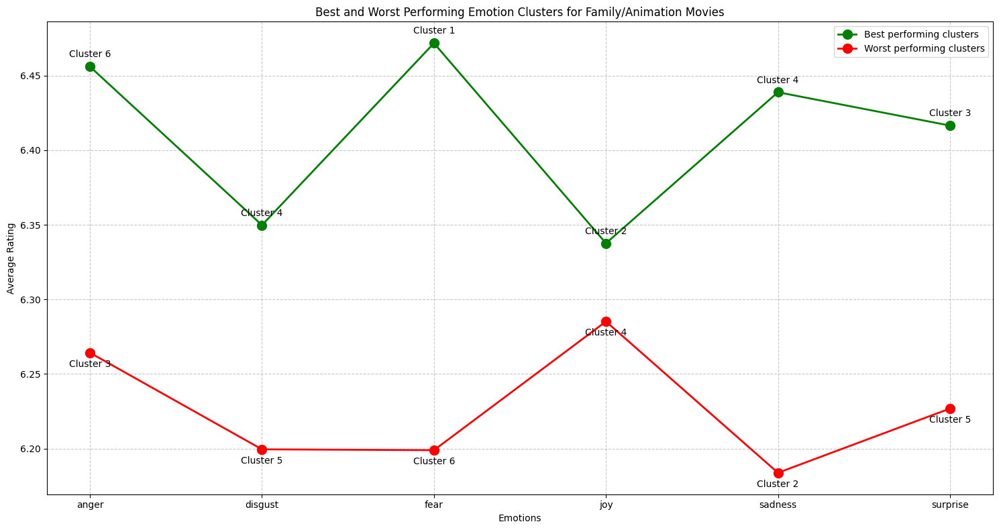

In [34]:
# First plot for all categories (previous code)
# First, explode the dataset by category
df_exploded = df_metadata_clusters.explode('category')

# List of all emotions
emotions = ['anger', 'disgust', 'fear', 'joy', 'sadness', 'surprise']

# Get unique categories
categories = df_exploded['category'].unique()

# First plot (from previous code)
for emotion in emotions:
    # print(f"\n{emotion} clusters start at:", df_metadata_clusters[emotion].min())
    plt.figure(figsize=(12, 8))
    for category in categories:
        category_data = df_exploded[df_exploded['category'] == category]
        emotion_rating_data = category_data[['Wikipedia_movie_ID', emotion, 'Rating']]
        mean_ratings = emotion_rating_data.groupby(emotion)['Rating'].mean()
        plt.plot(mean_ratings.index+1, mean_ratings.values, marker='o', label=category, linewidth=2)
    
    plt.title(f'Average Ratings by {emotion.capitalize()} Cluster Across Categories')
    plt.xlabel(f'{emotion.capitalize()} Cluster')
    plt.ylabel('Average Rating')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

# New plots for best/worst clusters by category
for category in categories:
    plt.figure(figsize=(15, 8))
    
    # Filter data for this category
    category_data = df_exploded[df_exploded['category'] == category]
    
    # Store best and worst clusters for each emotion
    best_clusters = []
    worst_clusters = []
    best_ratings = []
    worst_ratings = []
    
    # For x-axis positioning
    x_positions = range(len(emotions))
    
    for emotion in emotions:
        # Get mean ratings for each cluster
        cluster_ratings = category_data.groupby(emotion)['Rating'].agg(['mean', 'count']).reset_index()
        # Only consider clusters with at least 5 movies
        cluster_ratings = cluster_ratings[cluster_ratings['count'] >= 5]
        
        if not cluster_ratings.empty:
            # Find best and worst clusters
            best_cluster = cluster_ratings.loc[cluster_ratings['mean'].idxmax()]
            worst_cluster = cluster_ratings.loc[cluster_ratings['mean'].idxmin()]

            # CHANGE 1: Add +1 to cluster numbers here
            best_clusters.append(f"{emotion}_{int(best_cluster[emotion] + 1)}")  # Added +1
            worst_clusters.append(f"{emotion}_{int(worst_cluster[emotion] + 1)}")  # Added +1
            
            best_ratings.append(best_cluster['mean'])
            worst_ratings.append(worst_cluster['mean'])
        else:
            best_clusters.append("N/A")
            worst_clusters.append("N/A")
            best_ratings.append(None)
            worst_ratings.append(None)
    
    # Plot
    plt.plot(x_positions, best_ratings, 'go-', label='Best performing clusters', linewidth=2, markersize=10)
    plt.plot(x_positions, worst_ratings, 'ro-', label='Worst performing clusters', linewidth=2, markersize=10)
    
    # Add cluster numbers as annotations
    for i, (best, worst) in enumerate(zip(best_clusters, worst_clusters)):
        if best != "N/A":
            plt.annotate(f'Cluster {best.split("_")[1]}', 
                        (i, best_ratings[i]), 
                        textcoords="offset points", 
                        xytext=(0,10), 
                        ha='center')
        if worst != "N/A":
            plt.annotate(f'Cluster {worst.split("_")[1]}', 
                        (i, worst_ratings[i]), 
                        textcoords="offset points", 
                        xytext=(0,-15), 
                        ha='center')
    
    plt.title(f'Best and Worst Performing Emotion Clusters for {category} Movies')
    plt.xlabel('Emotions')
    plt.ylabel('Average Rating')
    plt.xticks(x_positions, emotions)
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.7)
    
    # Add summary statistics
    print(f"\nSummary for {category}:")
    for emotion, best, worst in zip(emotions, best_clusters, worst_clusters):
        if best != "N/A":
            print(f"\n{emotion.capitalize()}:")
            print(f"Best performing cluster: {best.split('_')[1]} (Rating: {best_ratings[emotions.index(emotion)]:.2f})")
            print(f"Worst performing cluster: {worst.split('_')[1]} (Rating: {worst_ratings[emotions.index(emotion)]:.2f})")
    
    plt.tight_layout()
    plt.show()

### Happy or sad endings according to cluster in per emotion clustering

In [ ]:
# List of emotion columns
emotion_columns = ['joy', 'sadness']

# First, explode the dataset by category
df_exploded = df_metadata_clusters.explode('category')

# Get unique categories
categories = df_exploded['category'].unique()

# For each emotion
for emotion in emotion_columns:
    print(f"\n{'='*50}")
    print(f"Analysis for {emotion.upper()} clusters")
    print(f"{'='*50}")
    
    # Group by cluster number and calculate mean for relevant columns
    cluster_means = df_exploded.groupby(emotion).mean()
    
    # Get the count of movies in each cluster
    cluster_counts = df_exploded[emotion].value_counts().sort_index()
    
    print("\nNumber of movies in each cluster:")
    print(cluster_counts)
    
    print("\nMean values for each cluster:")
    print(cluster_means[['Rating']].round(2))  # You can add more columns here if needed

### Distribution in emotion clusters of top 10% rated films

Analysis of top 3321 films (rated 7.60 and above):


Cluster distribution for ANGER:

Absolute counts:
anger
0.0     219
1.0     258
2.0     693
3.0     281
4.0    1036
5.0     152
Name: count, dtype: int64

Percentages:
anger
0.0     6.59
1.0     7.77
2.0    20.87
3.0     8.46
4.0    31.20
5.0     4.58
Name: count, dtype: float64


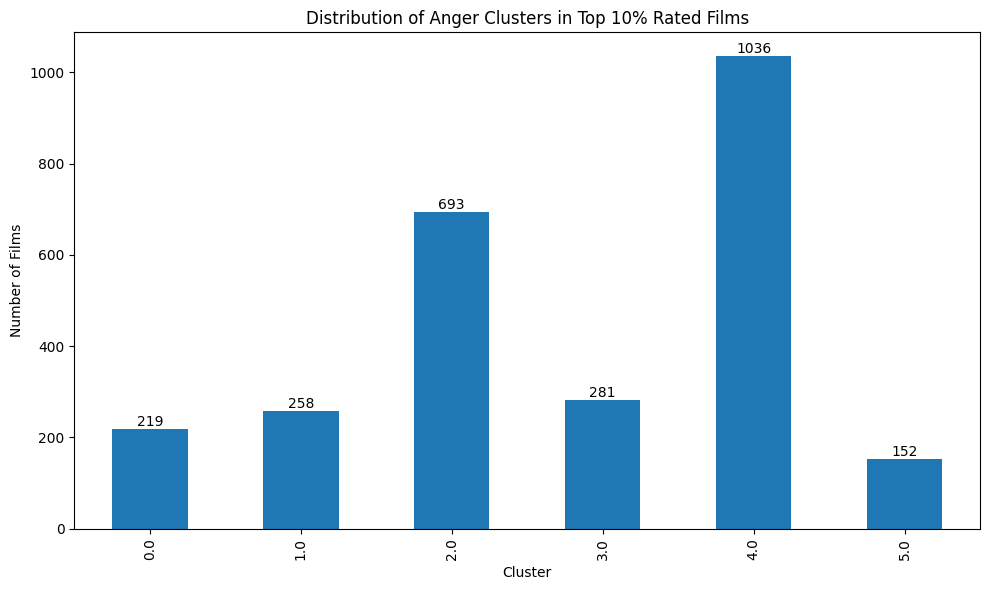


Cluster distribution for DISGUST:

Absolute counts:
disgust
0.0    1008
1.0     588
2.0     177
3.0     288
4.0     578
Name: count, dtype: int64

Percentages:
disgust
0.0    30.35
1.0    17.71
2.0     5.33
3.0     8.67
4.0    17.40
Name: count, dtype: float64


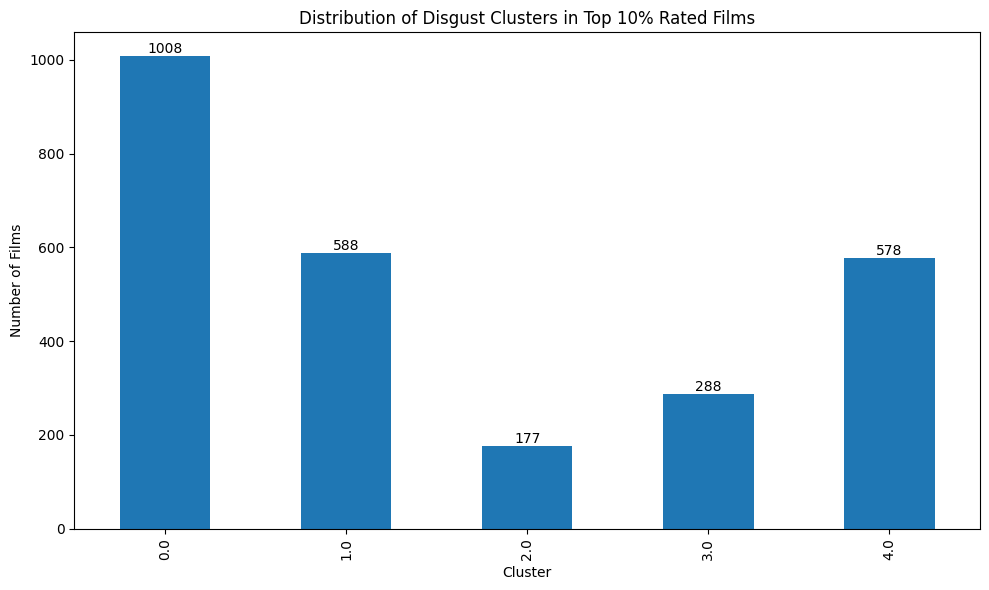


Cluster distribution for FEAR:

Absolute counts:
fear
0.0     184
1.0    1103
2.0     194
3.0     191
4.0     616
5.0     164
6.0     187
Name: count, dtype: int64

Percentages:
fear
0.0     5.54
1.0    33.21
2.0     5.84
3.0     5.75
4.0    18.55
5.0     4.94
6.0     5.63
Name: count, dtype: float64


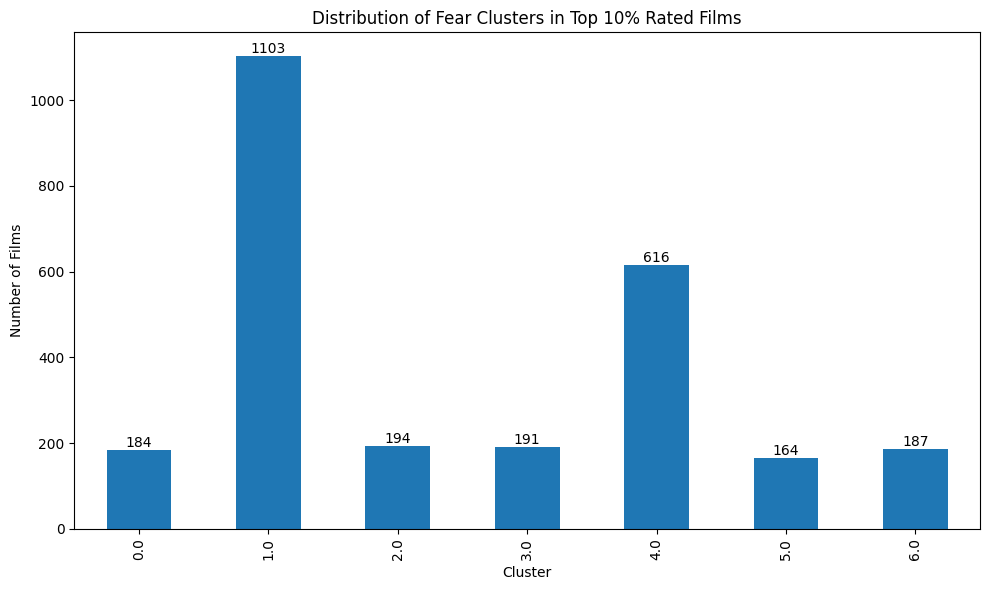


Cluster distribution for JOY:

Absolute counts:
joy
0.0    1606
1.0     156
2.0     508
3.0     369
Name: count, dtype: int64

Percentages:
joy
0.0    48.36
1.0     4.70
2.0    15.30
3.0    11.11
Name: count, dtype: float64


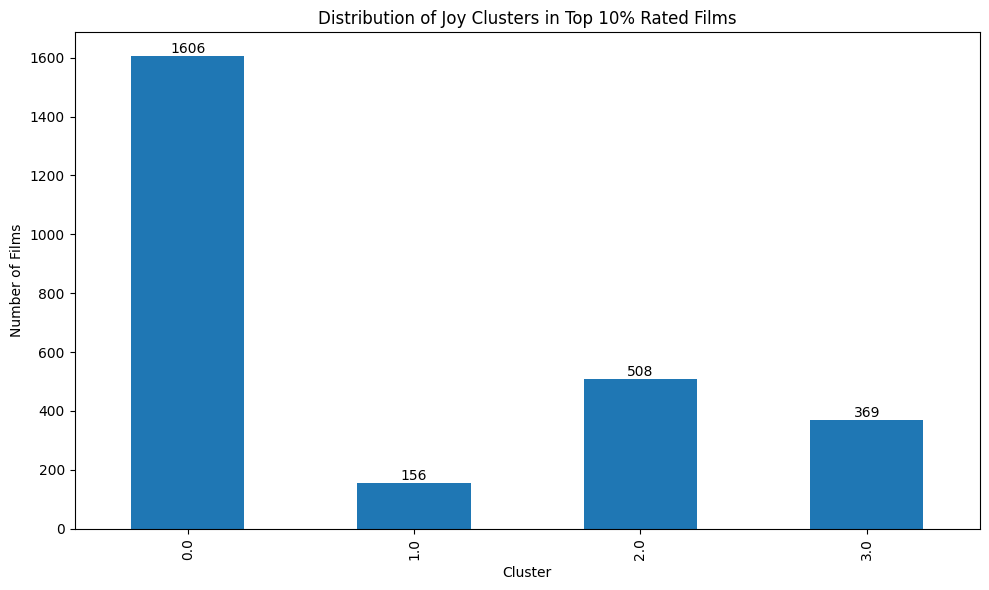


Cluster distribution for NEUTRAL:

Absolute counts:
neutral
0.0    2639
Name: count, dtype: int64

Percentages:
neutral
0.0    79.46
Name: count, dtype: float64


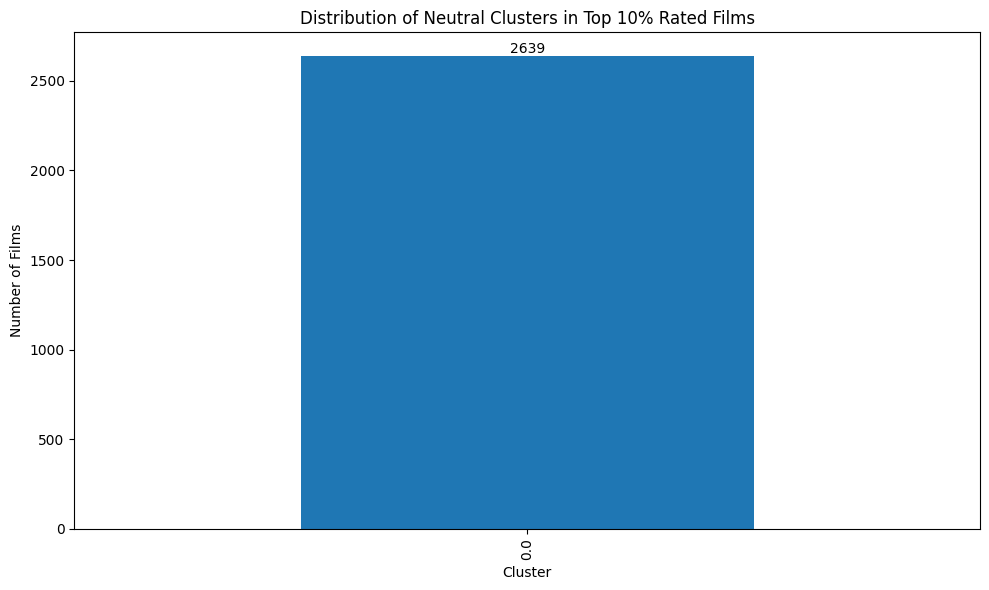


Cluster distribution for SADNESS:

Absolute counts:
sadness
0.0    1312
1.0     322
2.0     549
3.0     288
4.0     168
Name: count, dtype: int64

Percentages:
sadness
0.0    39.51
1.0     9.70
2.0    16.53
3.0     8.67
4.0     5.06
Name: count, dtype: float64


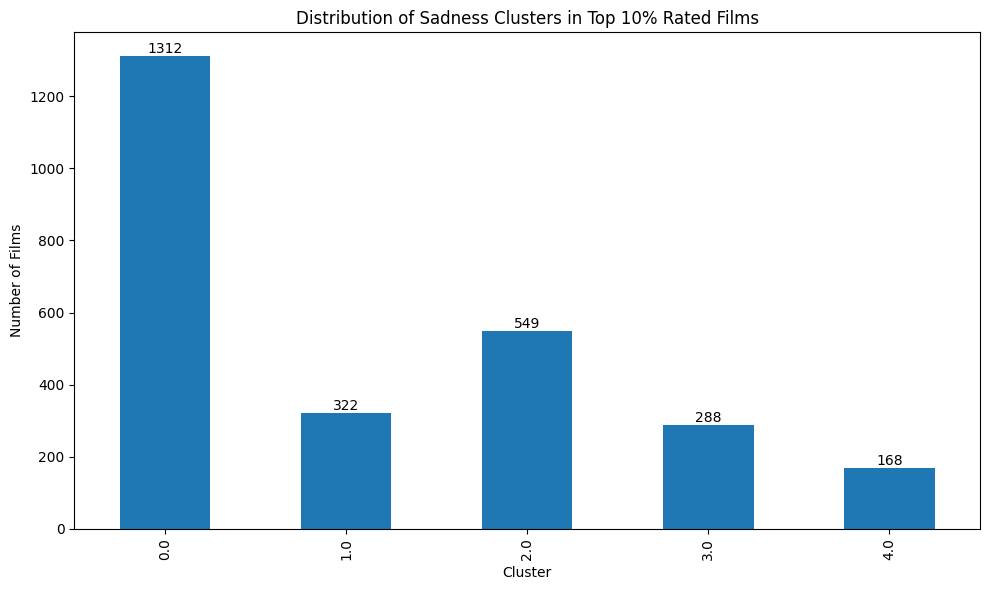


Cluster distribution for SURPRISE:

Absolute counts:
surprise
0.0     148
1.0    1597
2.0     315
3.0     252
4.0     327
Name: count, dtype: int64

Percentages:
surprise
0.0     4.46
1.0    48.09
2.0     9.49
3.0     7.59
4.0     9.85
Name: count, dtype: float64


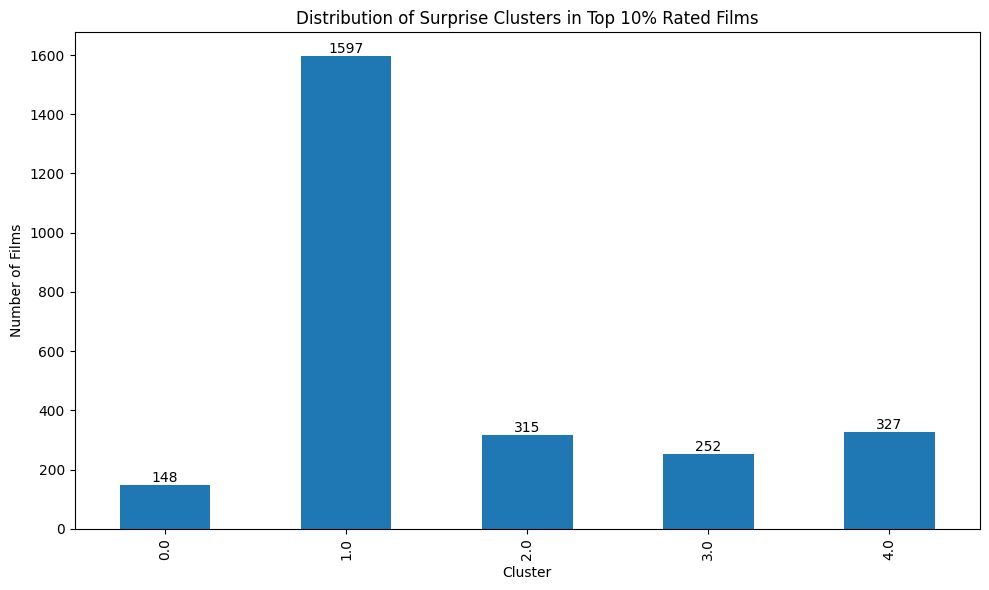


Example films from top 10%:
        Movie_name  Rating  anger  disgust  fear  joy  neutral  sadness  \
1     Blade Runner     8.1    4.0      1.0   1.0  0.0      0.0      0.0   
2  Blazing Saddles     7.7    4.0      0.0   1.0  0.0      0.0      0.0   
3      Blue Velvet     7.7    4.0      2.0   1.0  0.0      0.0      0.0   
4     Barry Lyndon     8.1    3.0      1.0   3.0  0.0      0.0      0.0   
6       Braveheart     8.3    2.0      0.0   4.0  0.0      0.0      0.0   

   surprise  
1       1.0  
2       4.0  
3       1.0  
4       1.0  
6       1.0  


In [27]:
# Get top 10% of films by rating
threshold = df_metadata_clusters['Rating'].quantile(0.9)
top_rated = df_metadata_clusters[df_metadata_clusters['Rating'] >= threshold]

print(f"Analysis of top {len(top_rated)} films (rated {threshold:.2f} and above):\n")

# Analyze each emotion
emotions = ['anger', 'disgust', 'fear', 'joy', 'neutral', 'sadness', 'surprise']

for emotion in emotions:
    print(f"\n{'='*50}")
    print(f"Cluster distribution for {emotion.upper()}:")
    print(f"{'='*50}")
    
    # Count movies in each cluster for this emotion
    cluster_counts = top_rated[emotion].value_counts().sort_index()
    
    # Calculate percentages
    cluster_percentages = (cluster_counts / len(top_rated) * 100).round(2)
    
    # Print results
    print("\nAbsolute counts:")
    print(cluster_counts)
    print("\nPercentages:")
    print(cluster_percentages)
    
    # Create a bar plot
    plt.figure(figsize=(10, 6))
    cluster_counts.plot(kind='bar')
    plt.title(f'Distribution of {emotion.capitalize()} Clusters in Top 10% Rated Films')
    plt.xlabel('Cluster')
    plt.ylabel('Number of Films')
    
    # Add count labels on top of each bar
    for i, v in enumerate(cluster_counts):
        plt.text(i, v, str(v), ha='center', va='bottom')
    
    plt.tight_layout()
    plt.show()

# Optional: show some example films
print("\nExample films from top 10%:")
print(top_rated[['Movie_name', 'Rating'] + emotions].head())